# Reanalysis of the Zebrafish habenula single cell data 
### Giuseppe D'Agostino, Jan 2021

In this notebook we will reanalyze the single cell data from [Pandey et al. 2018](https://www.cell.com/current-biology/pdf/S0960-9822(18)30225-2.pdf) in order to measure the expression of circadian rhythm genes in the Zebrafish habenula. 
We provide a complete workflow from the count matrices (as provided by the authors) using a pipeline that relies on several BioConductor packages. 

This pipeline is different from the custom pipeline used by the authors of the paper, but it is considered to be amongst the "gold standard"; other pipelines and software, such as `Seurat`, could be used. 
Because of different assumptions and different implementations of several steps - filtering, normalization, clustering, differential expression - it is very reasonable to expect slightly different results between this analysis and the original one. 

We will justify our choices at every step and try to highlight the most relevant differences. The most important difference lies in the clustering results. As the authors did not provide, in the original publication, the cluster identity for every cell, we have to reconstruct them using data-driven methods, which are based on the marker expression reported in the supplementary materials of the publication.

## Library loading and setup

In [1]:
library(SingleCellExperiment)
library(ggplot2)
library(scater)
library(bluster)
library(scuttle)
library(scran)
library(batchelor)
library(clustree)
library(pheatmap)
library(AUCell)
library(GSEABase)
library(beeswarm)
library(colorspace)
library(scDblFinder)

Loading required package: SummarizedExperiment

Loading required package: MatrixGenerics

Loading required package: matrixStats


Attaching package: ‘MatrixGenerics’


The following objects are masked from ‘package:matrixStats’:

    colAlls, colAnyNAs, colAnys, colAvgsPerRowSet, colCollapse,
    colCounts, colCummaxs, colCummins, colCumprods, colCumsums,
    colDiffs, colIQRDiffs, colIQRs, colLogSumExps, colMadDiffs,
    colMads, colMaxs, colMeans2, colMedians, colMins, colOrderStats,
    colProds, colQuantiles, colRanges, colRanks, colSdDiffs, colSds,
    colSums2, colTabulates, colVarDiffs, colVars, colWeightedMads,
    colWeightedMeans, colWeightedMedians, colWeightedSds,
    colWeightedVars, rowAlls, rowAnyNAs, rowAnys, rowAvgsPerColSet,
    rowCollapse, rowCounts, rowCummaxs, rowCummins, rowCumprods,
    rowCumsums, rowDiffs, rowIQRDiffs, rowIQRs, rowLogSumExps,
    rowMadDiffs, rowMads, rowMaxs, rowMeans2, rowMedians, rowMins,
    rowOrderStats, rowProds, rowQuantiles, rowRanges

In [2]:
custom_colors <- list()

colors_dutch <- c(
  '#FFC312','#C4E538','#12CBC4','#FDA7DF','#ED4C67',
  '#F79F1F','#A3CB38','#1289A7','#D980FA','#B53471',
  '#EE5A24','#009432','#0652DD','#9980FA','#833471',
  '#EA2027','#006266','#1B1464','#5758BB','#6F1E51'
)

colors_spanish <- c(
  '#40407a','#706fd3','#f7f1e3','#34ace0','#33d9b2',
  '#2c2c54','#474787','#aaa69d','#227093','#218c74',
  '#ff5252','#ff793f','#d1ccc0','#ffb142','#ffda79',
  '#b33939','#cd6133','#84817a','#cc8e35','#ccae62'
)

custom_colors$discrete <- c(colors_dutch, colors_spanish)


custom_colors$sixteenbit <- c("#212b5e","#636fb2","#adc4ff","#ffffff",
                              "#ffccd7","#ff7fbd","#872450","#e52d40",
                              "#ef604a","#ffd877","#00cc8b","#005a75",
                              "#513ae8","#19baff","#7731a5","#b97cff")

custom_colors$sixteenbit_ordered <- custom_colors$sixteenbit[c(14, 10, 11, 9, 16, 5, 3, 12, 2, 1, 8, 13, 7, 6)]

## Raw data loading and wrangling

The authors of Pandey et al. provide six different count tables, divided in two series:
- **GSE109159**:  made of 3 tables, which contain counts from a Smart-seq2 experiment in which the larval habenula was profiled. Each table contains counts from a different plate. Quoting from the experimental metadata deposited by the authors, _A total of 22 gng8-GFP fish were dissected in 3 batches and 384 cells were processed from each using Smart-seq2_
- **GSM2818521/2/3**: 3 tables, which contain counts from 10X experiments: 1 larval habenula and 2 adult habenulae datasets. Each table contains a different capture, although more animals per capture were used.

We merge the tables where necessary (i.e. in the Smart-seq2 experiment).

In [3]:
# Read count tables
rawdata1 <- read.table("SMARTseq/GSE109159_AH7GKNBGXY.RSEM.genes.counts.matrix", sep = "\t", header = TRUE)
rawdata2 <- read.table("SMARTseq/GSE109159_HGJMWBGXY.RSEM.genes.counts.matrix", sep = "\t", header = TRUE)
rawdata3 <- read.table("SMARTseq/GSE109159_HHKCVBGXY.RSEM.genes.counts.matrix", sep = "\t", header = TRUE)

rawdata_10x_1 <- read.table("TenX/GSM2818521_larva_counts_matrix.txt", sep = " ", header = TRUE)
rawdata_10x_2 <- read.table("TenX/GSM2818522_adultr1_counts_matrix.txt", sep = " ", header = TRUE)
rawdata_10x_3 <- read.table("TenX/GSM2818523_adultr2_counts_matrix.txt", sep = " ", header = TRUE)

# Collate tables together (SmartSeq-2)
rownames(rawdata1) <- rawdata1$X
rawdata <- cbind(rawdata1[,2:ncol(rawdata1)], rawdata2[,2:ncol(rawdata2)], rawdata3[,2:ncol(rawdata3)])

We create an object containing the relevant metadata for the Smart-seq2 larval habenula, which in this case is only the plate number (as there are plate-dependent batch effects):

In [4]:
coldata <- as.data.frame(cbind(colnames(rawdata), c(rep("p1", ncol(rawdata1)-1), 
                                                    rep("p2", ncol(rawdata2)-1), 
                                                    rep("p3", ncol(rawdata3)-1))))
colnames(coldata) <- c("sample", "plate")
rownames(coldata) <- coldata$sample

## Smart-seq2 larval habenula: QC metrics and filtering

We create the `SingleCellExperiment` object and run some basic QC metrics calculation (number of detected genes per barcode, number of total read counts per barcode) using `scater`'s functions:

In [5]:
fish_sm <- SingleCellExperiment(assays = list("counts" = as.matrix(rawdata)), 
                           colData = coldata,
                           rowData = rownames(rawdata))


In [6]:
fish.feat.QC <- scater::perFeatureQCMetrics(fish_sm)
rowData(fish_sm) <- cbind(rowData(fish_sm), fish.feat.QC)

We remove any gene that was not detected (0 counts across all barcodes):

In [7]:
fish_sm <- fish_sm[which(rowData(fish_sm)$detected > 1),]

We are left with 17673 genes and 1140 barcodes to be further analyzed.

In [8]:
fish_sm

class: SingleCellExperiment 
dim: 17673 1140 
metadata(0):
assays(1): counts
rownames(17673): TMX2B RPS11 ... CTSC AQP7
rowData names(3): X mean detected
colnames(1140): pMH9783_S383 pMH9771_S371 ... gng_p9_f11_S359
  gng_p8_f1_S253
colData names(2): sample plate
reducedDimNames(0):
altExpNames(0):

We calculate additional QC metrics using specific sets of genes that can be informative of the quality of cells. 

These are:
- mitochondrial transcripts
- ribosomal transcripts
- _Malat1_

We work under the assumption that cells expressing a "large enough" percentage of any of these sets of genes are undergoing cellular stress or damage due to the dissociation process, thus adding a source of variability that has no interesting biological underpinning for the questions at hand.

The value for "large enough" is defined as an arbitrary number of Mean Absolute Deviations (MADs) such that outlier values are defined within their distribution, and not setting a fixed cutoff _a priori_.

Additionally, we remove cells which have a small amount of genes or read counts, as they may represent ambient RNA contamination or poor quality cells. 

In [9]:
fish.QC <- perCellQCMetrics(fish_sm, subsets = list(mito = grep("^MT-", rownames(fish_sm)), 
                                                    Malat1 = grep("MALAT1", rownames(fish_sm)), 
                                                    Ribo = grep("^MRPL|^MRPS|^RPL|^RPS", rownames(fish_sm))))


low.lib <- isOutlier(log10(fish.QC$sum), type = "lower", nmad=3)

low.genes <- isOutlier(log10(fish.QC$detected), type = "lower", nmad=3)

high.mt <- isOutlier(fish.QC$subsets_mito_percent, type = "higher", nmad = 4)

high.malat1 <- isOutlier(fish.QC$subsets_Malat1_percent, type = "higher", nmad = 3)

high.ribo <- isOutlier(fish.QC$subsets_Ribo_percent, type = "higher", nmad = 3)


data.frame(LowLib=sum(low.lib), 
           LowNgenes=sum(low.genes), 
           HighMT = sum(high.mt),
           HighMalat1 = sum(high.malat1), 
           HighRibo = sum(high.ribo))

fish.QC$discard <- low.lib | low.genes | high.mt | high.malat1 | high.ribo

table(fish.QC$discard)

LowLib,LowNgenes,HighMT,HighMalat1,HighRibo
<int>,<int>,<int>,<int>,<int>
94,99,36,32,100



FALSE  TRUE 
  914   226 

According to this type of filtering, which may be slightly aggressive, we are left with 914 supposedly "good quality" cells.

We plot the distribution of each specific QC metric, highlighting barcodes marked for elimination in orange:

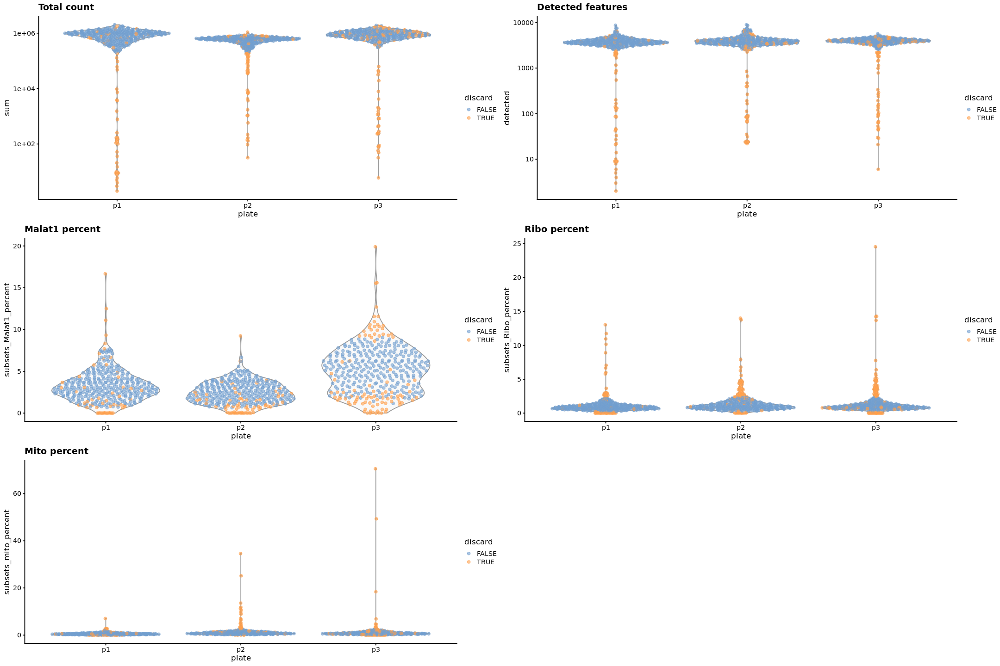

In [10]:
options(repr.plot.width = 18, repr.plot.height = 12)

colData(fish_sm) <- cbind(colData(fish_sm), fish.QC)

gridExtra::grid.arrange(
    plotColData(fish_sm, x="plate", y="sum", colour_by="discard") +
        scale_y_log10() + ggtitle("Total count"),
    plotColData(fish_sm, x="plate", y="detected", colour_by="discard") +
        scale_y_log10() + ggtitle("Detected features"),
     plotColData(fish_sm, x="plate", y="subsets_Malat1_percent",
        colour_by="discard") + ggtitle("Malat1 percent"),
    plotColData(fish_sm, x="plate", y="subsets_Ribo_percent",
        colour_by="discard") + ggtitle("Ribo percent"),
    plotColData(fish_sm, x="plate", y="subsets_mito_percent",
        colour_by="discard") + ggtitle("Mito percent"),
    ncol=2
)

We discard the low quality barcodes, and check the object again.

In [11]:
fish_sm <- fish_sm[, !fish_sm$discard]

In [12]:
fish_sm

class: SingleCellExperiment 
dim: 17673 914 
metadata(0):
assays(1): counts
rownames(17673): TMX2B RPS11 ... CTSC AQP7
rowData names(3): X mean detected
colnames(914): pMH9783_S383 pMH9771_S371 ... gng_p9_f11_S359
  gng_p8_f1_S253
colData names(15): sample plate ... total discard
reducedDimNames(0):
altExpNames(0):

## Normalization

We use `scran`'s pooling and deconvolution approach to derive per-cell size factors that can be used to perform normalization and log1p (i.e. log(count) + 1) transformation. 

This approach requires first clustering cells with similar transcriptional profiles, so that cells can be pooled within clusters to derive their size factors. Size factors are then rescaled across clusters (see the [scran vignette](https://bioconductor.org/packages/devel/bioc/vignettes/scran/inst/doc/scran.html) for more information).

In this particular case, we also "block" the clustering adding the plate information. 

In [13]:
fish_sm_clusters <- quickCluster(fish_sm, block = fish_sm$plate)

table(fish_sm_clusters)

Warning message in regularize.values(x, y, ties, missing(ties), na.rm = na.rm):
“collapsing to unique 'x' values”
Warning message in regularize.values(x, y, ties, missing(ties), na.rm = na.rm):
“collapsing to unique 'x' values”
Warning message in regularize.values(x, y, ties, missing(ties), na.rm = na.rm):
“collapsing to unique 'x' values”


fish_sm_clusters
  1   2   3   4 
134 194 300 286 

In [14]:
fish_sm <- computeSumFactors(fish_sm, clusters = fish_sm_clusters)

We also perform a batch-aware normalization using `batchelor::multiBatchNorm` to remove the plate effect. This step rescales counts so that they match the batch with the shallowest sequencing depth.

In [15]:
fish_sm_mbn <- multiBatchNorm(fish_sm, batch = "plate")

## Dimensionality reduction

We will embed cells in a lower-dimensional manifold via Principal Component Analysis (PCA). Every cell will exist within this space having PC embeddings as coordinates. In this way the graph construction and clustering, which use Euclidean distance, suffer significantly less from the curse of dimensionality and are computationally tractable. 

To do so we must first identify the most relevant features, i.e. "highly variable genes" (HVGs); these are genes that drive most of the variability in the dataset and should represent the actual biological heterogeneity brought forth by different cell types or states. The use of a reduced set of variable genes, as opposed to the full set of genes, also affords a much faster computation on top of the biological significance. 

Variance of genes alone, however, is not sufficient to capture biological variability. RNA-seq counts follow distributions such as Poisson or Negative Binomial (NB) that exhibit a mean-variance relationship. In the case of Poisson distributed data, the mean is equal to the variance, whereas for NB the variance increases with the squared mean. This means that if we were to select genes based on their variance alone, we would mostly select the highly expressed ones, regardless of whether they encompass biological variability (e.g.: housekeeping genes).

For this reason we must model the variance of genes across cells, determining a trend - which will be the "technical" mean-variance relationship - and then determining which genes differ enough from the trend, i.e. they have an additional amount of variance that is not explained by the mean alone. These are the "highly variable genes" that we will use for dimensionality reduction. The definition of "enough difference" is arbitrary, and we will go for a rather simple approach using the 2000 genes with the highest deviation from the trend.

In [16]:
fish_sm_block <- modelGeneVar(fish_sm_mbn, block = fish_sm$plate)

Warning message in regularize.values(x, y, ties, missing(ties), na.rm = na.rm):
“collapsing to unique 'x' values”
Warning message in regularize.values(x, y, ties, missing(ties), na.rm = na.rm):
“collapsing to unique 'x' values”
Warning message in regularize.values(x, y, ties, missing(ties), na.rm = na.rm):
“collapsing to unique 'x' values”


We then combine the variances for each plate and select the top 2000 HVGs.

In [17]:
vars_combined <- combineVar(fish_sm_block$per.block[["p1"]], 
                    fish_sm_block$per.block[["p2"]], 
                    fish_sm_block$per.block[["p3"]])

choose_hvgs <- getTopHVGs(vars_combined, n = 2000)

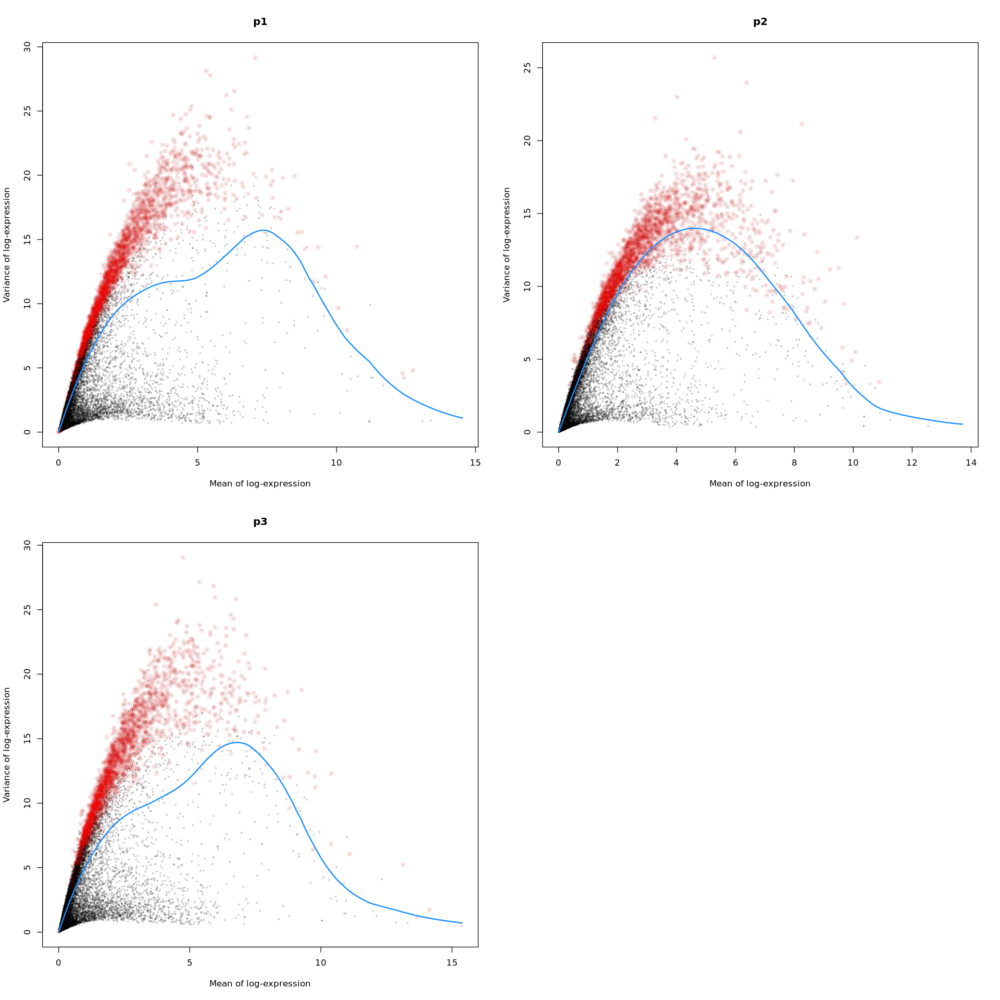

In [18]:
options(repr.plot.width = 16, repr.plot.height = 16)

# Plot variance-mean scatterplot with the fitted trend and selected HVGs 

blocked.stats <- fish_sm_block$per.block
layout(matrix(1:4, nrow = 2, byrow = TRUE))

for (i in colnames(blocked.stats)) {
    current <- blocked.stats[[i]]
    plot(current$mean, current$total, main = i, pch = 16, cex = 0.5,  col=rgb(0,0,0,0.2),
        xlab="Mean of log-expression", ylab="Variance of log-expression")
    points(current[choose_hvgs, "mean"], current[choose_hvgs, "total"], col = rgb(1,0,0,0.2))
    curfit <- metadata(current)
    curve(curfit$trend(x), col='dodgerblue', add=TRUE, lwd=2)
}

We run the PCA and then we correct the batch effect directly in the PCA space by applying the `fastMNN` method, which uses a mutual nearest neighbour (MNN) search in the PCA space to estimate "correction vectors" by which cells are shifted to eliminate effects that are orthogonal to biological variation.

In [19]:
fish_sm_mbn <- runPCA(fish_sm_mbn, 
                      subset_row = choose_hvgs, 
                      exprs_values = "logcounts") 


fish_sm_corrected <- fastMNN(fish_sm_mbn, 
                             batch = fish_sm_mbn$plate, 
                             subset.row = choose_hvgs)

In [20]:
# We add some relevant metadata to the corrected object as all other columns were removed 
fish_sm_corrected$plate <- fish_sm_mbn$plate
fish_sm_corrected$sum <- fish_sm_mbn$sum
fish_sm_corrected$subsets_mito_percent <- fish_sm_mbn$subsets_mito_percent
fish_sm_corrected$subsets_Ribo_percent <- fish_sm_mbn$subsets_Ribo_percent
fish_sm_corrected$subsets_Malat1_percent <- fish_sm_mbn$subsets_Malat1_percent

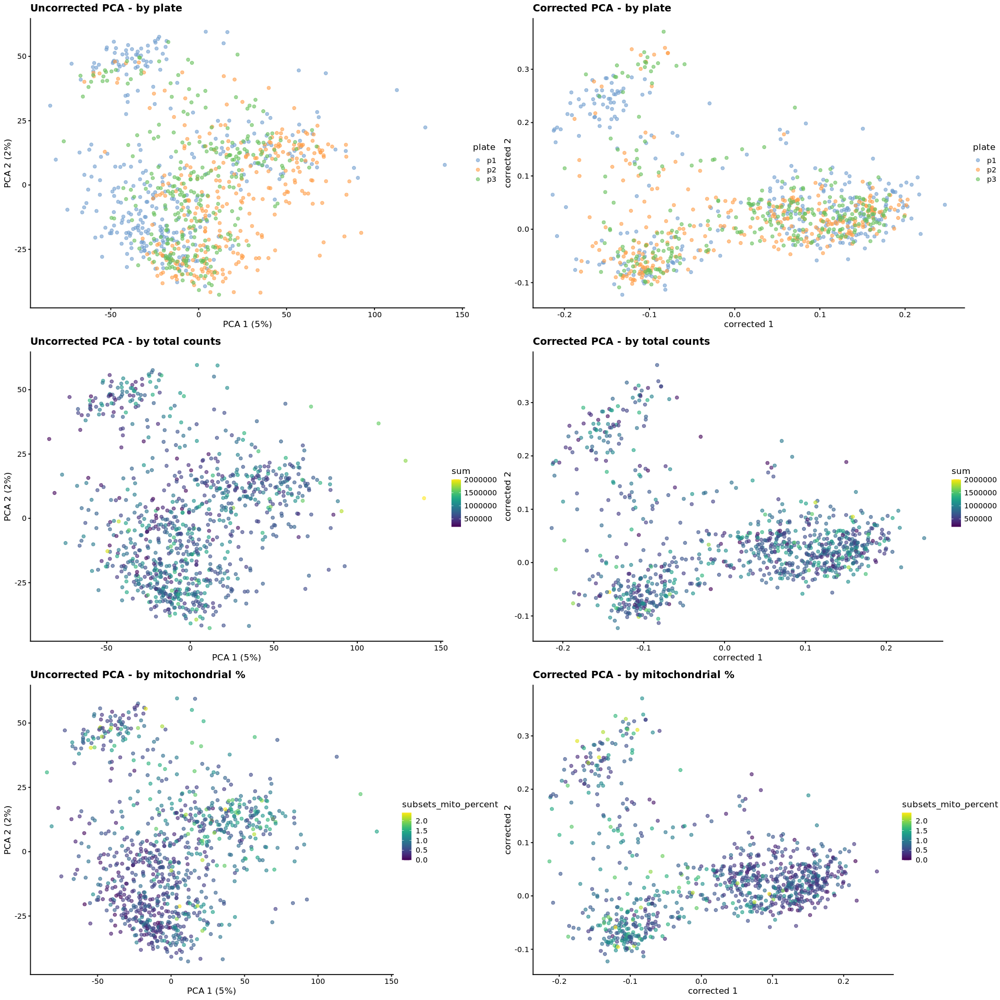

In [21]:
options(repr.plot.width = 16, repr.plot.height = 16)

# Plotting by different sources of variation as a quick diagnostic of the correction
gridExtra::grid.arrange(
plotReducedDim(fish_sm_mbn, dimred = "PCA", 
               colour_by = "plate"
              ) + labs(title = "Uncorrected PCA - by plate"),

plotReducedDim(fish_sm_corrected, dimred = "corrected", 
               colour_by = "plate"
              ) + labs(title = "Corrected PCA - by plate"),

plotReducedDim(fish_sm_mbn, dimred = "PCA", 
               colour_by = "sum"
              ) + labs(title = "Uncorrected PCA - by total counts"),

plotReducedDim(fish_sm_corrected, dimred = "corrected", 
               colour_by = "sum"
              ) + labs(title = "Corrected PCA - by total counts"),

plotReducedDim(fish_sm_mbn, dimred = "PCA", 
               colour_by = "subsets_mito_percent"
              ) + labs(title = "Uncorrected PCA - by mitochondrial %"),

plotReducedDim(fish_sm_corrected, dimred = "corrected", 
               colour_by = "subsets_mito_percent"
              ) + labs(title = "Corrected PCA - by mitochondrial %"),
    ncol = 2)

Now that we have the corrected dimensionality reduction, we can use it to perform additional dimensionality reduction for visualization purposes and most importantly clustering.

The available dimensionality reduction has 50 dimensions, but we will not construct a graph using all of these dimensions. In fact, the more dimensions we use, the more equidistant points will be, making the notion of Euclidean distance, used do determine neighbors, less useful.

The [pipeComp paper](https://genomebiology.biomedcentral.com/articles/10.1186/s13059-020-02136-7) suggests a data-driven method to estimate the "dimensionality" of the dataset, implemented in the `intrinsicDimension` package. The parameter $k$ is the number of neighbours that are considered for distance estimation in a k-Nearest Neighbour search. The value of $k$ is commonly set as $\sqrt{n}$, where $n$ is the number of points.

In [22]:
floor(sqrt(ncol(fish_sm_corrected)))

[1] 30

In [23]:
intrinsicDimension::maxLikGlobalDimEst(reducedDim(fish_sm_corrected, "corrected"), k = 30)

Dimension estimate: 13.04816

We will use 13 dimensions to run non-linear dimensionality reduction (UMAP, t-SNE) and for clustering:

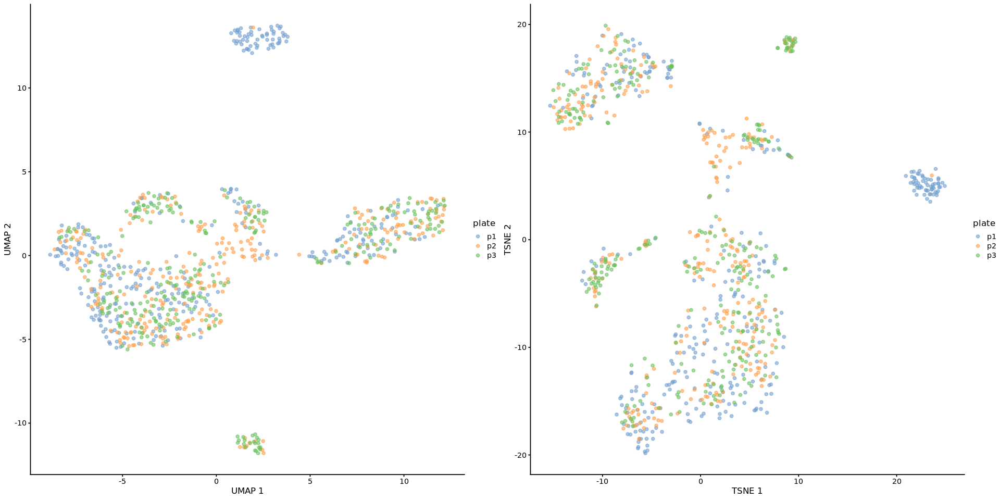

In [24]:
options(repr.plot.width = 16, repr.plot.height = 8)

# Running UMAP through external call to uwot because scater's implementation has a very small distance creating
# tight clusters that are not visually pleasing

set.seed(110100100)

fish_sm_corrected_UMAP <- uwot::umap(reducedDim(fish_sm_corrected, "corrected")[,1:13], 
                                     n_neighbors = 30, 
                                     min_dist = 0.7)

reducedDim(fish_sm_corrected, "UMAP") <- fish_sm_corrected_UMAP

fish_sm_corrected <- runTSNE(fish_sm_corrected, 
                             dimred = "corrected", 
                             n_dimred = 1:13)

gridExtra::grid.arrange(
    
    plotReducedDim(fish_sm_corrected, 
                   dimred = "UMAP", 
                   colour_by = "plate"),
    
    plotReducedDim(fish_sm_corrected, 
                   dimred = "TSNE", 
                   colour_by = "plate"),
    ncol = 2)

Looking at both UMAP and t-SNE we can appreciate how one particular group of cells is almost exclusively contributed by a single plate (p1). It is hard to determine at this point whether that is a specific cell type or state that was retained in one out of three sorting procedures, but we may want to inspect this issue further.

## Clustering

We can now use the PCA to build a shared nearest neighbour (SNN) graph, in which "communities" (clusters) will be detected using the Louvain algorithm. 

Community detection, like many other algorithms, heavily depends on the choice of parameters: in this case one of the most important ones is the minimum number of neighbours in the SNN graph necessary to draw an edge between two nodes. 

Small numbers will yield more interconnected graphs, resulting in more communities. Without having a suitable _a priori_ value, we can run the algorithm several times on the same dataset increasing the number of neighbours, and then define a "clustering tree" using `clustree`. A clustering tree is a useful visualization in which clustering results are drawn in a hierarchical fashion, so that the more coarse clustering result resides in the top node, while clustering results at increasing resolution are added as "children" nodes. This visualization affords a comprehensive view of different parameters as, at every layer, every cluster is related to its previous layer by the number of overlapping cells. When cells start changing membership in a non-hierarchical fashion, it is a sign that the number of neighbours may be too small and the clustering may be too granular, creating communities that are mostly artefactual.

Once the clustering tree has ben drawn, we can decide what kind of resolution suits our needs. We know that the Pandey et al. study identifies 10 clusters in the Smart-seq2 larval dataset, so we will use that number as a reference. The authors make the point that clustering results are more reliable in the 10X dataset, as it samples more cells albeit at a shallower depth. We will still attempt at cluster Smart-seq2 data first, and measure the expression of circadian rhythm genes in this dataset, as the Smart-seq2 protocol affords a more extensive quantification of transcripts.

In [25]:
# Subsetting to the first 13 dimensions for the SNN graph construction
fish_sm_reduced <- fish_sm_corrected
reducedDim(fish_sm_reduced, type = "corrected") <- reducedDim(fish_sm_reduced, type = "corrected")[,1:13]

# Build one different SNN graph per number of neighbors
# We use Jaccard-weighted edges to get closer to Seurat's method
fish_sm_SNN_10 <- buildSNNGraph(fish_sm_reduced, use.dimred = "corrected", type = "jaccard", k = 10)
fish_sm_SNN_15 <- buildSNNGraph(fish_sm_reduced, use.dimred = "corrected", type = "jaccard", k = 15)
fish_sm_SNN_30 <- buildSNNGraph(fish_sm_reduced, use.dimred = "corrected", type = "jaccard", k = 30)
fish_sm_SNN_40 <- buildSNNGraph(fish_sm_reduced, use.dimred = "corrected", type = "jaccard", k = 40)
fish_sm_SNN_50 <- buildSNNGraph(fish_sm_reduced, use.dimred = "corrected", type = "jaccard", k = 50)

# Clustering using the Louvain community detection method
fish_sm_clusters_10  <- igraph::cluster_louvain(fish_sm_SNN_10)
fish_sm_clusters_15  <- igraph::cluster_louvain(fish_sm_SNN_15)
fish_sm_clusters_30  <- igraph::cluster_louvain(fish_sm_SNN_30)
fish_sm_clusters_40  <- igraph::cluster_louvain(fish_sm_SNN_40)
fish_sm_clusters_50  <- igraph::cluster_louvain(fish_sm_SNN_50)


In [26]:
clusterings <- as.data.frame(
               cbind(fish_sm_clusters_10$membership,
                     fish_sm_clusters_15$membership,
                     fish_sm_clusters_30$membership,
                     fish_sm_clusters_40$membership,
                     fish_sm_clusters_50$membership))

# Ordering them with a number for clustree
colnames(clusterings) <- c("SNN_5", 
                           "SNN_4", 
                           "SNN_3", 
                           "SNN_2", 
                           "SNN_1")

Warning message:
“The `add` argument of `group_by()` is deprecated as of dplyr 1.0.0.
Please use the `.add` argument instead.
This warning is displayed once every 8 hours.
Call `lifecycle::last_warnings()` to see where this warning was generated.”


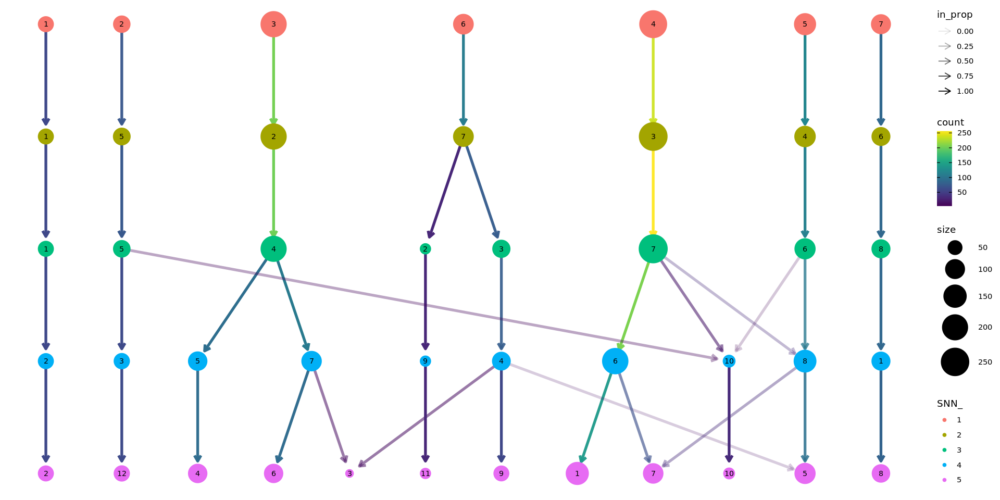

In [27]:
clustree(clusterings, prefix = "SNN_", layout = "sugiyama")

Clustering for the using 10 neighbours yields 12 clusters, with one small cluster emerging from cluster 4 in the 4th layer. We can compare these results on the t-SNE and/or UMAP:

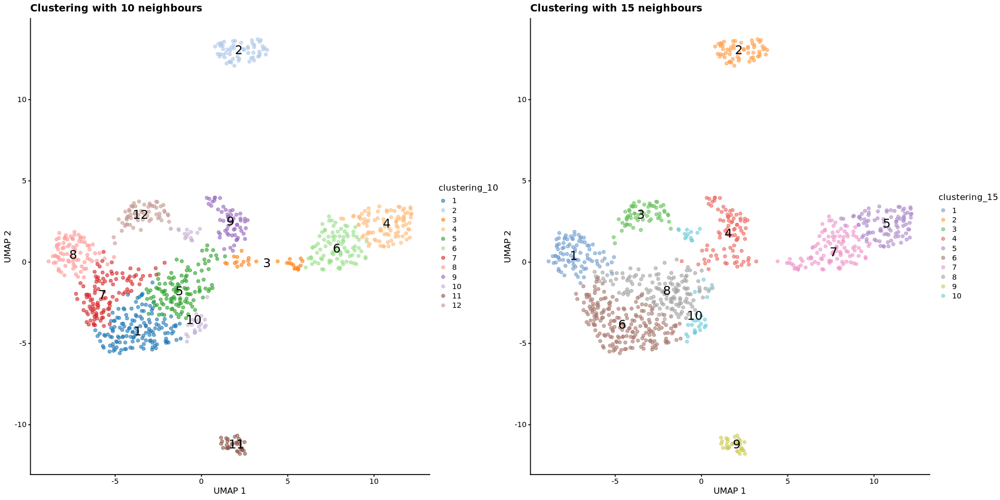

In [28]:
options(repr.plot.width = 16, repr.plot.height = 8)

colData(fish_sm_reduced)$clustering_10 <- factor(clusterings$SNN_5)
colData(fish_sm_reduced)$clustering_15 <- factor(clusterings$SNN_4)

gridExtra::grid.arrange(
    plotReducedDim(fish_sm_reduced, dimred = "UMAP", colour_by = "clustering_10", text_by = "clustering_10", ) + 
ggtitle("Clustering with 10 neighbours") + scale_fill_manual(values = custom_colors$sixteenbit_ordered),

plotReducedDim(fish_sm_reduced, dimred = "UMAP", colour_by = "clustering_15", text_by = "clustering_15") + 
ggtitle("Clustering with 15 neighbours")  + scale_fill_manual(values = custom_colors$sixteenbit_ordered),
    ncol = 2)
                                          

It is not immediately clear whether one should prefer one result over the other given the data at hand. We can use some clustering diagnostics to determine how well clusters are separated. It must be noted that this is purely a data partition diagnostic, and does not necessarily inform the underlying biology, especially if cell types exist in a more continuous state (or very similar states if not for a few detectable genes) rather than a more insular picture. This is an important aspect to keep in mind and depends on the expectations. Within a larval organism we can expect some of the neuronal populations to be still developing, thus being in a more dynamical state than more mature cell types.

One diagnostic is the *silhouette width*: for each cell, the distance to all cells in the same cluster is computed, and then the average distance is taken (a value we shall call A). Then, the average distance of each cell to all cells of another cluster is computed, and this is done for all the other clusters. The average of these averages is then calculated (value B). Finally, the silhouette width is defined as the difference between A and B, divided by the maximum between A and B. A cell with a positive silhouette value is close to other cells in the same cluster. A cell with a negative value, instead, is closer to cells from another cluster. 

For computational efficiency we use an approximate version of the silhouette width which does not calculate the distance across all cells (a most burdensome operation for large datasets), but rather finds cluster centroids and calculates the distance of each cell to each centroid. This is not immediately necessary for this dataset, for which the exact silhouette width can be computed, but becomes necessary for larger sets.

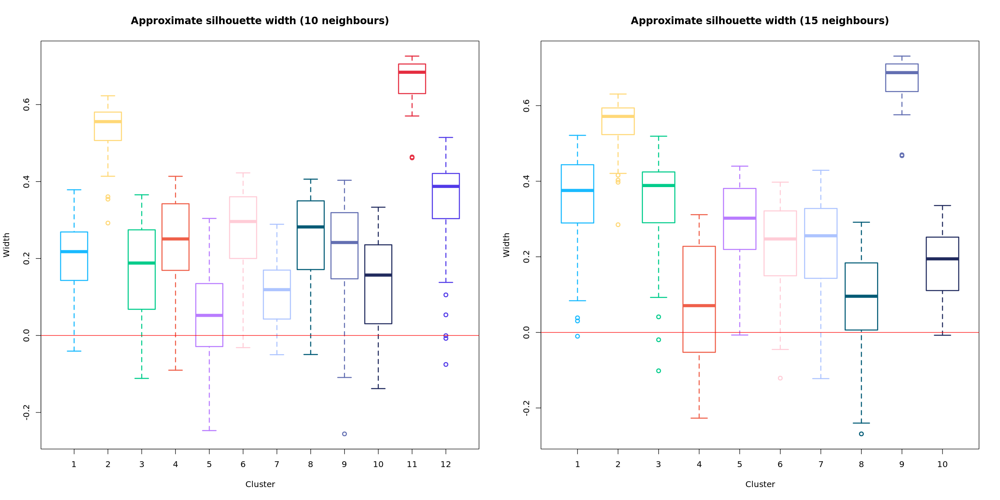

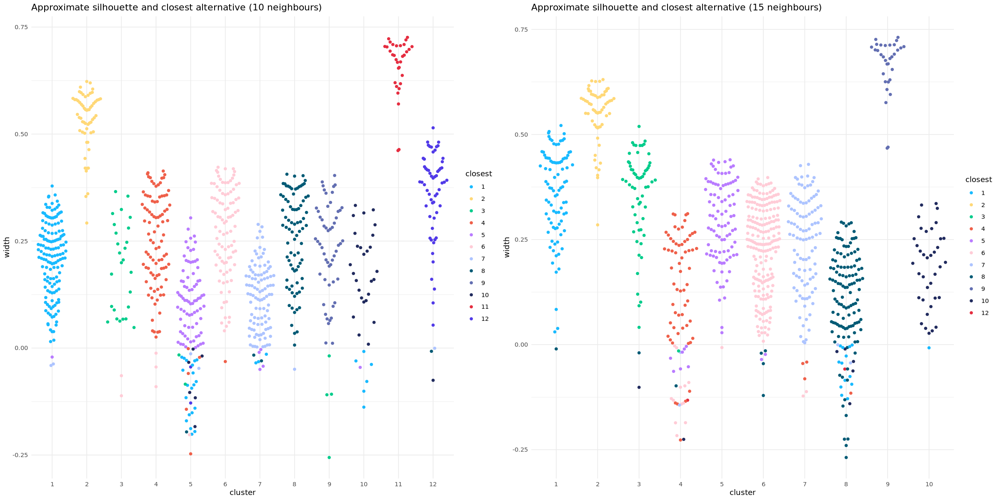

In [29]:
options(repr.plot.width = 20, repr.plot.height = 10)


silhouette_10 <- as.data.frame(approxSilhouette(reducedDim(fish_sm_reduced, type = "corrected"), 
                               colData(fish_sm_reduced)$clustering_10))

silhouette_15 <- as.data.frame(approxSilhouette(reducedDim(fish_sm_reduced, type = "corrected"), 
                               colData(fish_sm_reduced)$clustering_15))
# original cluster label
silhouette_10$cluster <-  colData(fish_sm_reduced)$clustering_10
silhouette_15$cluster <-  colData(fish_sm_reduced)$clustering_15

# closest cluster for points whose silhouette is < 0
silhouette_10$closest <- factor(ifelse(silhouette_10$width > 0, silhouette_10$cluster, silhouette_10$other))
silhouette_15$closest <- factor(ifelse(silhouette_15$width > 0, silhouette_15$cluster, silhouette_10$other))

layout(matrix(1:2, nrow  = 1))

boxplot(silhouette_10$width ~ silhouette_10$cluster, 
        main = "Approximate silhouette width (10 neighbours)", 
        ylab = "Width", 
        xlab = "Cluster",
        border = custom_colors$sixteenbit_ordered,
        col = NA,
        lwd = 2)
abline(h = 0, col = 'red')

boxplot(silhouette_15$width ~ silhouette_15$cluster, 
        main = "Approximate silhouette width (15 neighbours)", 
        ylab = "Width", 
        xlab = "Cluster",
        border = custom_colors$sixteenbit_ordered,
        col = NA,
        lwd = 2)
abline(h = 0, col = 'red')

gridExtra::grid.arrange(
ggplot(silhouette_10, aes(x=cluster, y=width, colour=closest)) + 
    ggbeeswarm::geom_quasirandom(method="smiley")  + 
scale_colour_manual(values = custom_colors$sixteenbit_ordered) +
theme_minimal() +
ggtitle("Approximate silhouette and closest alternative (10 neighbours)"),

ggplot(silhouette_15, aes(x=cluster, y=width, colour=closest)) + 
    ggbeeswarm::geom_quasirandom(method="smiley")  + 
scale_colour_manual(values = custom_colors$sixteenbit_ordered) +
theme_minimal() +
ggtitle("Approximate silhouette and closest alternative (15 neighbours)"),
ncol = 2)

Another measure is *neighborhood purity*: in the same spirit of the silhouette, for each cell, the % of neighbours that belong to the same cluster is computed. The number of neighbours to be considered within each cluster is determined by drawing an n-dimensional hypersphere of radius $r$ around each cell, and counting how many cells of every cluster lie within the hypersphere, dividing by the total number of cells in the hypersphere. A high purity (close to 1) is desirable if we expect clusters to be very well separated. The hypersphere radius $r$ is determined by searching for $k$-nearest neighbours (default value 50) for each cell. This may be a large value for a small dataset, but for the time being we will leave it as it is.

Cells at the boundary of closely related clusters, or cells in clusters that are intermingled, will include other cells in their hyperspheres, thus lowering the purity. Purity can always be decreased by a higher resolution (lower number of necessary neighbours to draw an edge in the SNN), i.e. can be a symptom of overclustering.

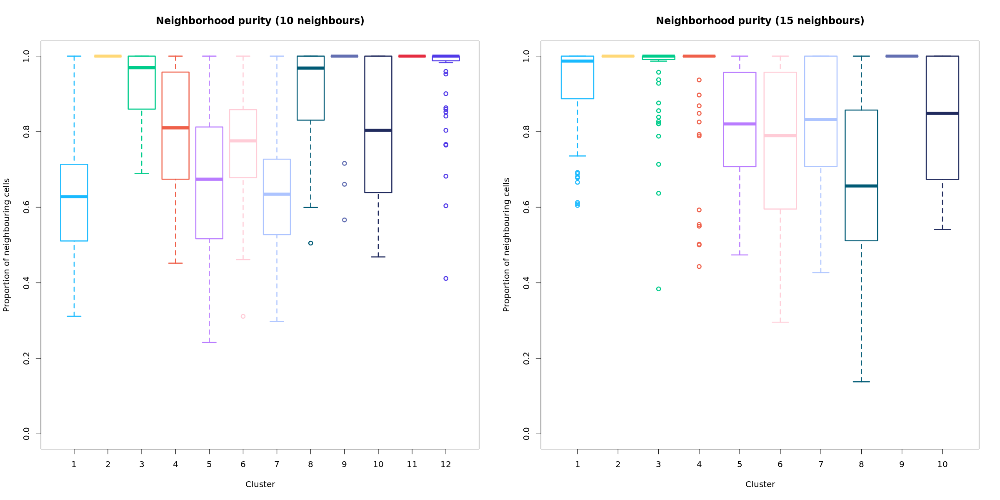

In [30]:
cluster_purity_10 <- neighborPurity(reducedDim(fish_sm_reduced, type = "corrected"), 
                               colData(fish_sm_reduced)$clustering_10)
cluster_purity_10$cluster <- colData(fish_sm_reduced)$clustering_10

cluster_purity_15 <- neighborPurity(reducedDim(fish_sm_reduced, type = "corrected"), 
                               colData(fish_sm_reduced)$clustering_15)
cluster_purity_15$cluster <- colData(fish_sm_reduced)$clustering_15

layout(matrix(1:2, nrow  = 1))

boxplot(cluster_purity_10$purity ~ cluster_purity_10$cluster, 
        main = "Neighborhood purity (10 neighbours)", 
        ylab = "Proportion of neighbouring cells", 
        xlab = "Cluster",
        border = custom_colors$sixteenbit_ordered,
        col = NA,
        lwd = 2,
        ylim = c(0,1))

boxplot(cluster_purity_15$purity ~ cluster_purity_15$cluster, 
        main = "Neighborhood purity (15 neighbours)", 
        ylab = "Proportion of neighbouring cells", 
        xlab = "Cluster",
        border = custom_colors$sixteenbit_ordered,
        col = NA,
        lwd = 2,
        ylim = c(0,1))

Finally, having used a graph-based clustering approach, we can compute *clustering modularity*, a measure of how well the vertices of a graph are connected to each other within a certain cluster membership, and how well they are disconnected across different memberships. While modularity is a single value for the whole clustering, we can use `bluster`'s *pairwise modularity*, in which scores are defined for every single cluster with respect to every other cluster. An important detail is the setting of `as.ratio = TRUE` in the arguments, which sort of normalizes the modularity value by cluster size (large clusters will be more modular even if they're not well separated).

In a well separated clustering, the diagonal of the matrix should have the highest values, meaning that most of the edges in the cluster are connected with each other and not with edges from other clusters. Higher modularity scores in the rest of the matrix show some degree of across-cluster connection.

We can explore how these clusters are connected drawing yet again another graph, in which the edge weights are defined by the pairwise modularity ratio scores. This is a useful visualization to see at a glance which clusters are more mixed, or confounded, with which ones.

In [31]:
# Calculate modularity
ratio_10 <- pairwiseModularity(fish_sm_SNN_10, 
                               clusterings$SNN_5, 
                               as.ratio = TRUE)

ratio_15 <- pairwiseModularity(fish_sm_SNN_15, 
                               clusterings$SNN_4, 
                               as.ratio = TRUE)

Warning message in vattrs[[name]][index] <- value:
“number of items to replace is not a multiple of replacement length”


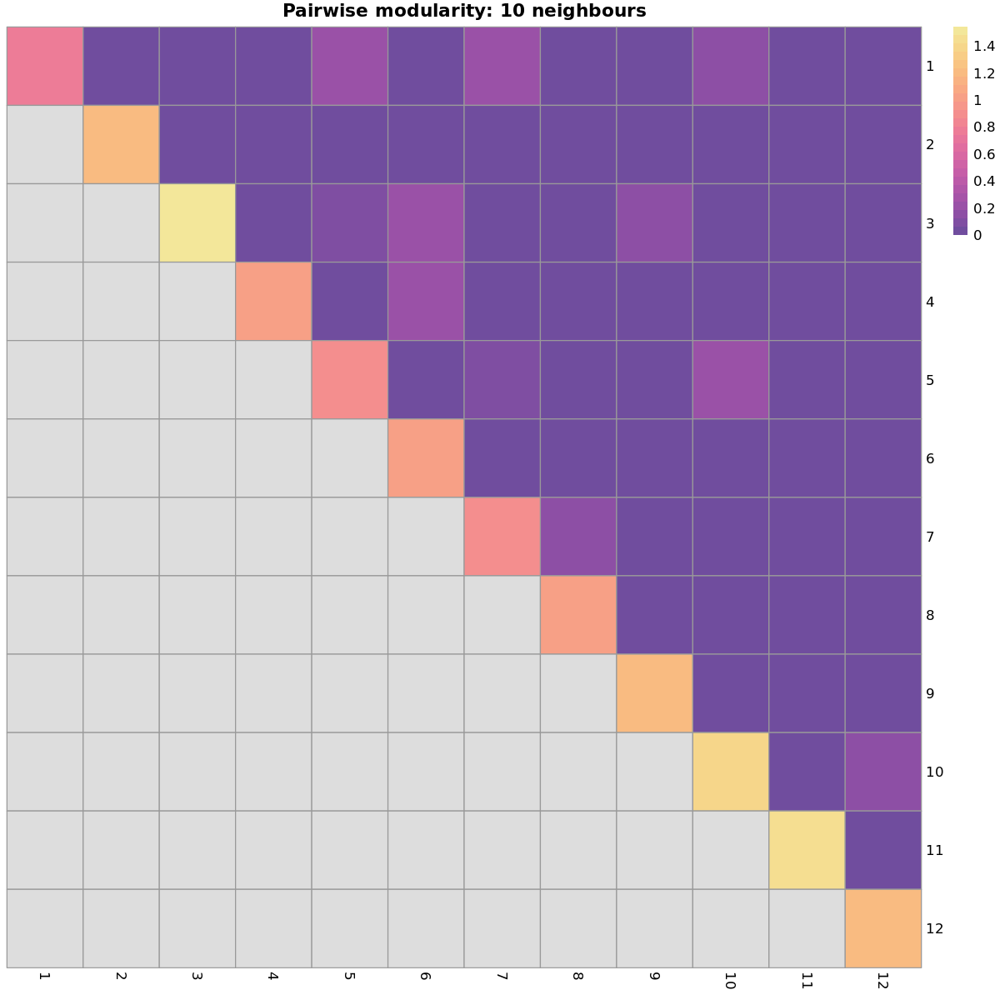

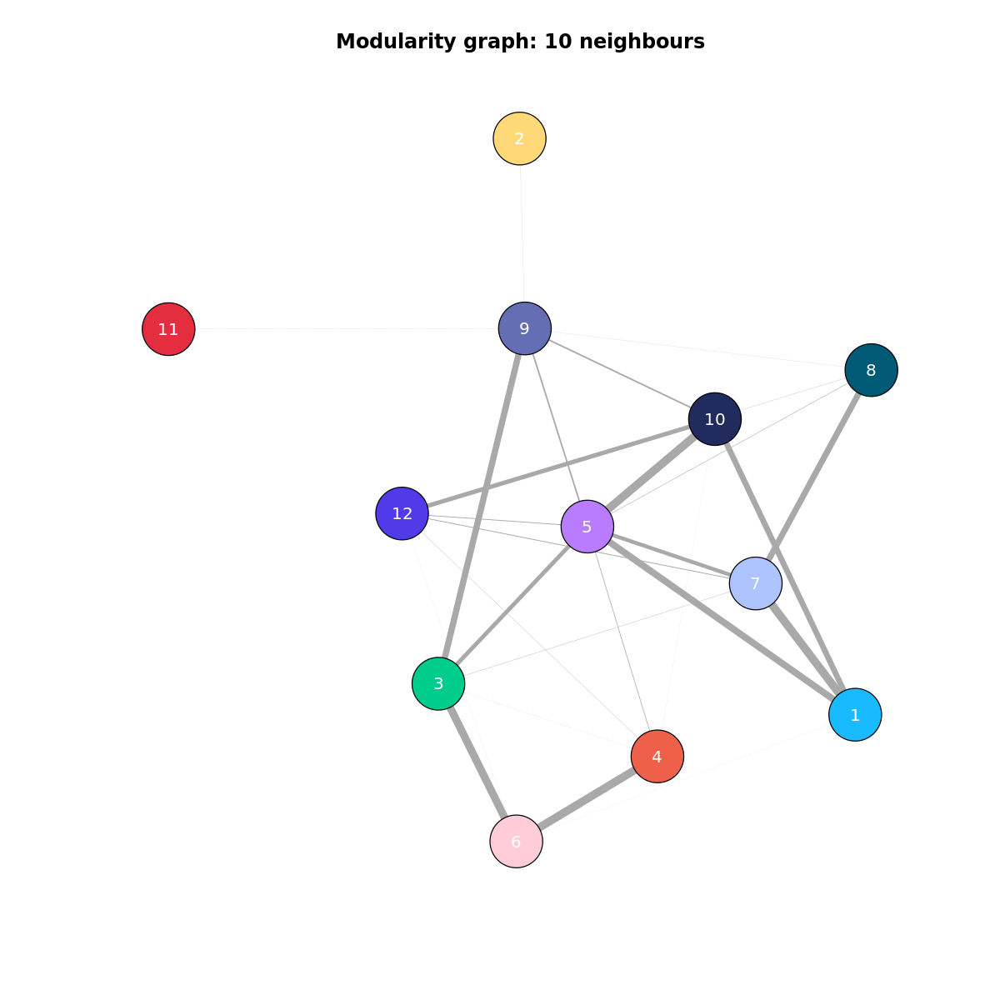

In [32]:
options(repr.plot.width = 10, repr.plot.height = 10)

# Plot pairwise modularity ratios in a heatmap: perfectly modular clusterings should have 
# positive values in the diagonal only

pheatmap(log10(ratio_10 + 1), 
        cluster_cols = FALSE, 
        cluster_rows=FALSE,
        col = colorspace::sequential_hcl("Sunset", n = 25),
        main = "Pairwise modularity: 10 neighbours")

# Modularity graph
mod_cluster_10_graph <- igraph::graph_from_adjacency_matrix(log2(ratio_10 + 1), 
    mode="upper", weighted=TRUE, diag=FALSE)

igraph::V(mod_cluster_10_graph)$color = custom_colors$sixteenbit_ordered
igraph::V(mod_cluster_10_graph)$label.color = "white"
igraph::V(mod_cluster_10_graph)$label.family = "sans"

set.seed(42069)
plot(mod_cluster_10_graph, edge.width=igraph::E(mod_cluster_10_graph)$weight*10,
    layout=igraph::layout_with_lgl,
    main = "Modularity graph: 10 neighbours")

Warning message in vattrs[[name]][index] <- value:
“number of items to replace is not a multiple of replacement length”


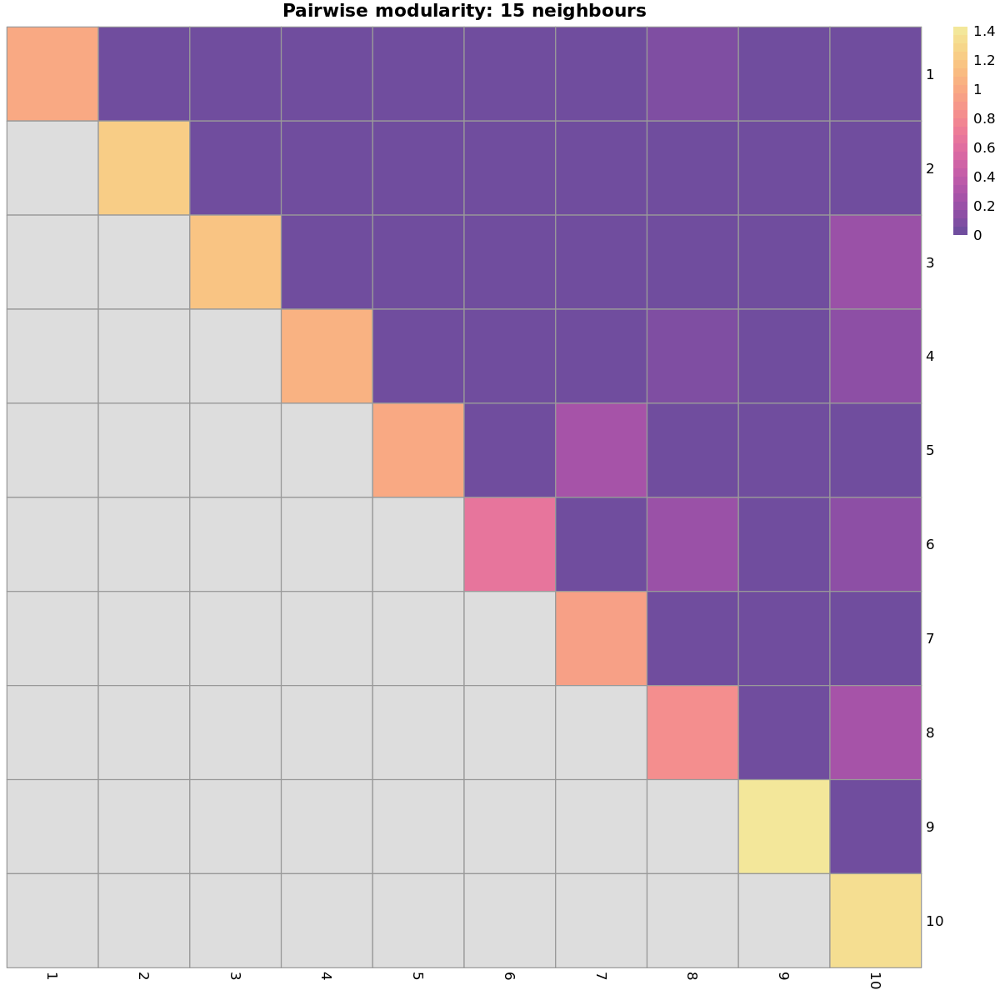

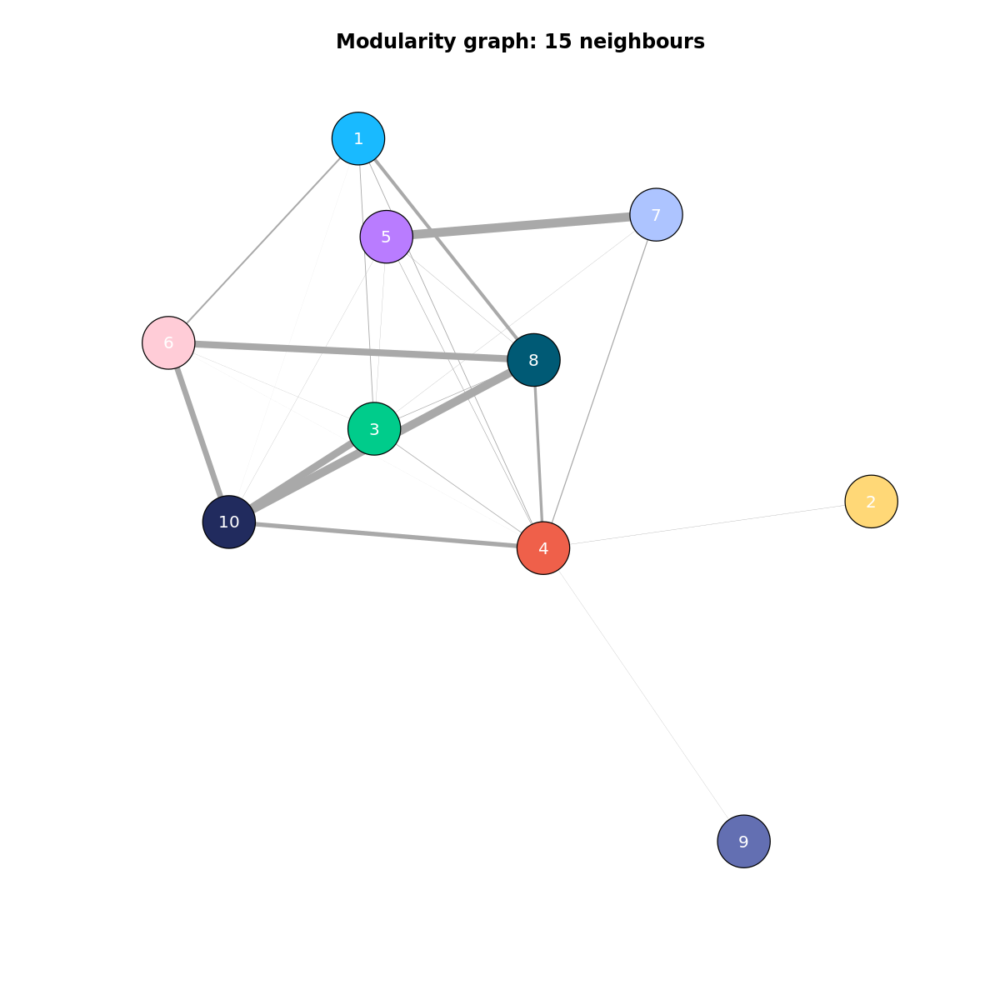

In [33]:
pheatmap(log10(ratio_15 + 1), 
        cluster_cols = FALSE, 
        cluster_rows=FALSE,
        col = colorspace::sequential_hcl("Sunset", n = 25),
        main = "Pairwise modularity: 15 neighbours")

mod_cluster_15_graph <- igraph::graph_from_adjacency_matrix(log2(ratio_15+1), 
    mode="upper", weighted=TRUE, diag=FALSE)

igraph::V(mod_cluster_15_graph)$color = custom_colors$sixteenbit_ordered
igraph::V(mod_cluster_15_graph)$label.color = "white"
igraph::V(mod_cluster_15_graph)$label.family = "sans"

set.seed(42068)
plot(mod_cluster_15_graph, edge.width=igraph::E(mod_cluster_15_graph)$weight*10,
    layout=igraph::layout_with_lgl,
    main = "Modularity graph: 15 neighbours")

Based on silhouette, purity and modularity, it would seem that using 15 neighbours offers a slightly better separation than using 10. However, some clusters are still intermingled with each other.

We must also remember that cluster 1 was contributed by a single plate, so it may be an artifact.

## Comparing with published clusters

Since we are trying to reproduce the original results published by Pandey et al., we need to compare our clustering with theirs. As mentioned in the introduction, fundamental differences in QC, filtering, normalization and overall workflow will inevitably yield different results; regardless, we need to assess how far off this analysis is from their original one. Unfortunately we do not have access to the cluster labels directly, only to the cluster markers, so we will have to infer cluster labels based on the marker expression. Moreover, the marker list was provided only for 10X experiments, and not for Smart-seq2. The 10X data clustering in the original publication identified 16 different clusters.

There are a few ways to infer cell types using genesets, and we will use the `AUCell` [package](https://bioconductor.org/packages/release/bioc/vignettes/AUCell/inst/doc/AUCell.html#why-to-use-aucell). 

`AUCell` estimates whether a set of genes (in our case, cluster markers from the original publication) is "enriched" in each single cell. It does so by ranking genes by expression in every cell and computing the Area Under the Curve (AUC) of the recovery curve, i.e. the curve obtained by plotting the gene rank (x axis) against the number of genes in the geneset having at least that rank (y axis). If a geneset contains a gene in rank 1, then the first point of the curve will lie on (1,1); then, if it contains a gene in the second rank, the next point will lie on (2,2), and so on. If no gene in the geneset is present at rank 3, then the next point will lie on (3, 2), to signify that we have advanced by one position in the rank, but not in the geneset.

It must be stressed that this approach, like many others, does not rely on clustering to assign cell types, as every single cell is evaluated independently. In `AUCell` the other AUC values can be used to decide the threshold for assignment, although this means that cells can be assigned to two (or more) genesets at the same time if the AUC for both of the genesets is higher than their respective thresholds.

According to the package authors, `AUCell` may not perform egregiously with small genesets, since a large AUC can be still achieved by randomly choosing small sets of genes. Since our marker sets are quite small, we need to be mindful of this potential problem.

By default, `AUCell` uses the top 5% of the ranks in every cell to determine the recovery curve. This threshold may be changed as depth and number of identified genes in the dataset increases. Since in Smart-seq2 data more genes are quantified at a higher depth, we increase this threshold to 30%.

In this workflow we are assigning an identity to a cell based on the maximum AUC value. In theory every geneset will ideally yield a bimodal distribution of AUC values, with most of the cells populating the lower distribution and a smaller, reliably identified population populating the higher distribution. Even though we do not consider the threshold for the assignment, it is wise to inspect the threshold selection manually, by looking at the AUC histograms.

In [34]:
# Reading in marker tables
mks_larv <- read.delim("mks_larv.txt", 
                       header = TRUE, 
                       stringsAsFactors = FALSE)

mks_adult <- read.delim("mks_adult.txt", 
                        header = TRUE, 
                        stringsAsFactors = FALSE)

# Capitalizing for compatibility with the SCE obkect
mks_larv$Gene <- toupper(mks_larv$Gene)
mks_adult$gene <- toupper(mks_adult$gene)

#Split the marker dataframe in a named list
mks_larv_list <- lapply(unique(mks_larv$Cluster), 
                        function(x) mks_larv[mks_larv$Cluster == x,2])
                        
names(mks_larv_list) <- unique(mks_larv$Cluster)
                        
mks_adult_list <- lapply(unique(mks_adult$Cluster), 
                         function(x) mks_adult[mks_adult$Cluster == x,2])
                         
names(mks_adult_list) <- unique(mks_adult$Cluster)

# Convert marker list into a GeneSet list
all_sets <- lapply(names(mks_larv_list), function(x) {
        GeneSet(mks_larv_list[[x]], setName=x)        
    })
                           
all_sets <- GeneSetCollection(all_sets)
                         
# Build rankings and calculate AUCs for every cell/every geneset                       
rankings <- AUCell_buildRankings(counts(fish_sm), 
                                 plotStats = FALSE, 
                                 verbose = FALSE)
                         
cell_aucs <- AUCell_calcAUC(all_sets, 
                            rankings, 
                            aucMaxRank = ceiling(0.3 * nrow(rankings))) # take top 30% of ranks

# Assign by max AUC value                         
results <- t(assay(cell_aucs))

Warning message in .AUCell_calcAUC(geneSets = geneSets, rankings = rankings, nCores = nCores, :
“The following gene sets will be excluded from the analysis(less than 20% of their genes are available):
Hb12”
Genes in the gene sets NOT available in the dataset: 
	Hb14: 	5 (42% of 12)



Even though we don't use the threhsolds, we look at the distributions for each geneset:

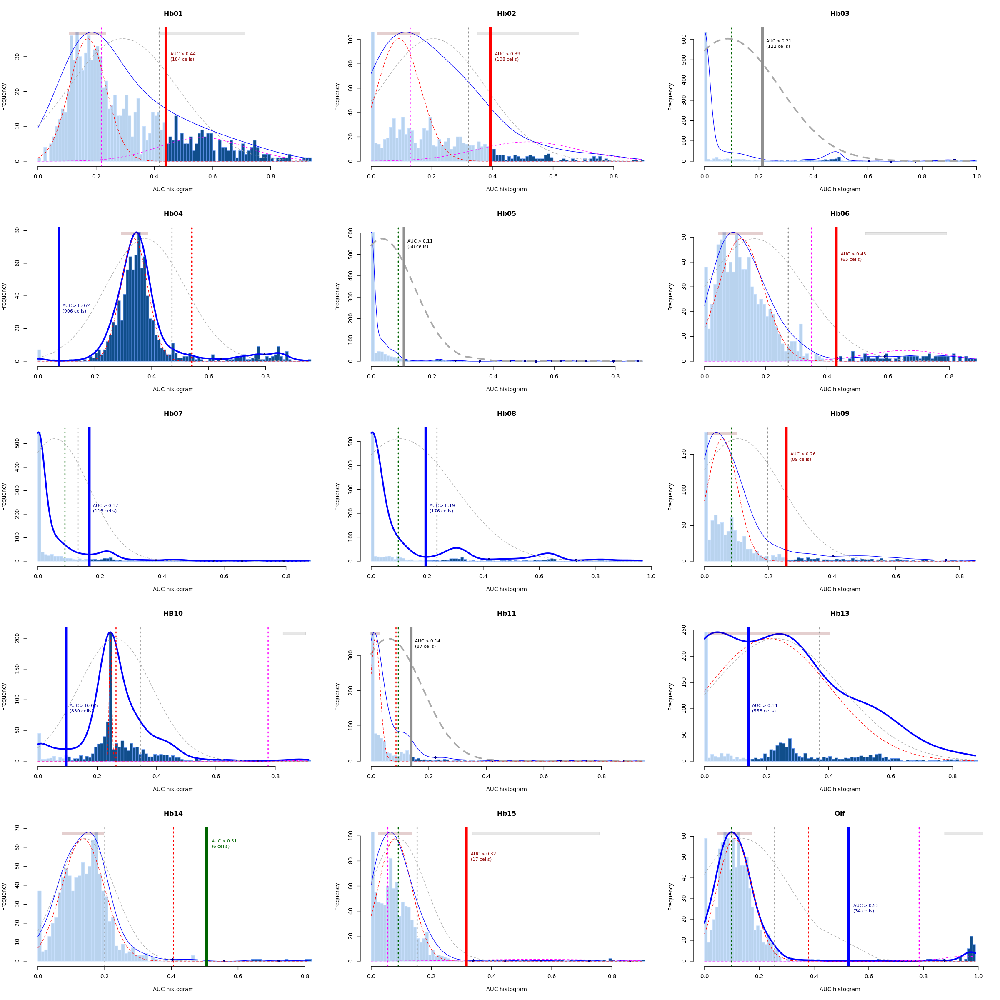

In [35]:
options(repr.plot.width = 20, repr.plot.height = 20)


set.seed(123)

layout(matrix(1:15, nrow = 5, byrow = TRUE))

cells_assignment <- AUCell_exploreThresholds(cell_aucs, 
                                             plotHist = TRUE, 
                                             assign = TRUE) 

Automatic assignments are not very  efficient in that there are many instances in which there is no clear bimodal distribution. This may be due to several factors: the provenance of this marker set (10X data as opposed to Smart-seq2), the small number of genes in each geneset, and how poorly the Smart-seq2 data recovers actual clusters according to the authors. We can see that the algorithm has also had some issues assigning some of the marker sets, as large numbers of AUCs are 0.

In [36]:
# Assigning labels to each cell as genesets with max AUC value
colData(fish_sm_reduced)$labels <- colnames(results)[max.col(results)]

We can see how these marker sets fare on the dataset:

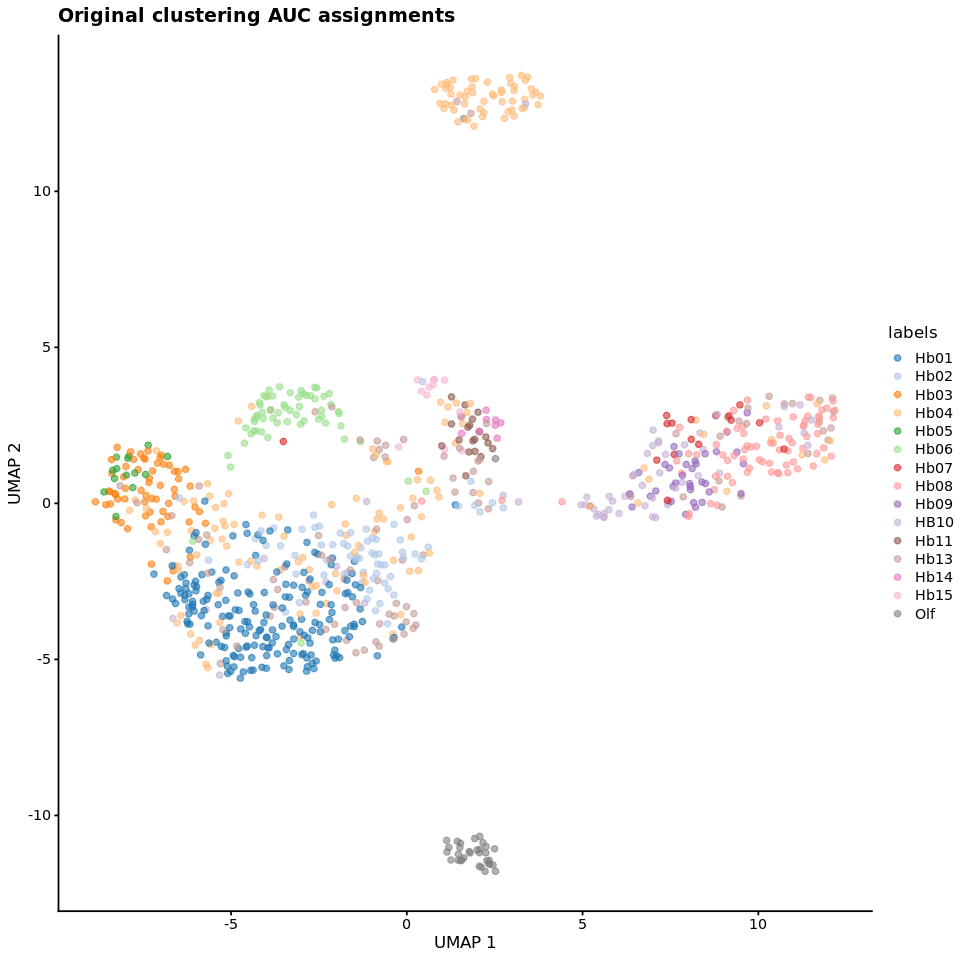

In [37]:
options(repr.plot.width = 8, repr.plot.height = 8)

plotReducedDim(fish_sm_reduced, dimred="UMAP", colour_by = "labels") + 
    ggtitle("Original clustering AUC assignments")  + 
    scale_fill_manual(values = custom_colors$discrete)

We calculate silhouette widths for each assignment:

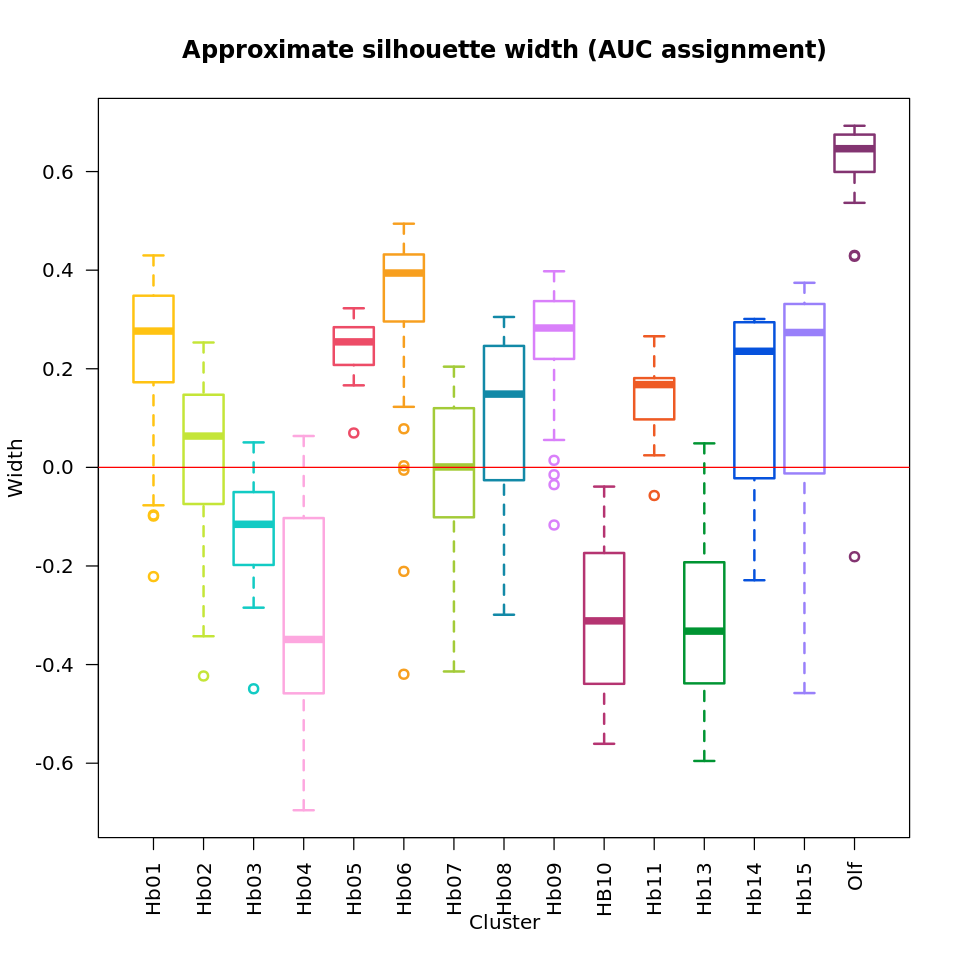

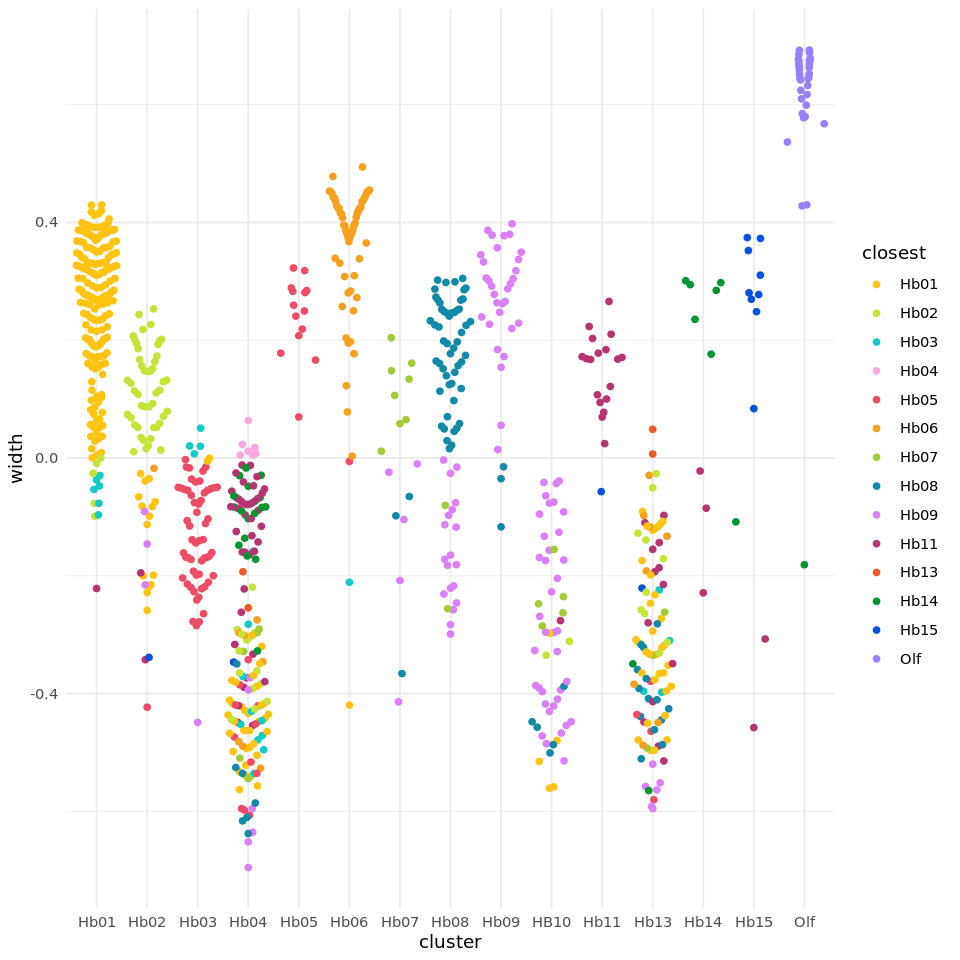

In [38]:

silhouette_orig <- as.data.frame(approxSilhouette(reducedDim(fish_sm_reduced, type = "corrected"), 
                               colData(fish_sm_reduced)$labels))

silhouette_orig$cluster <-  colData(fish_sm_reduced)$labels

silhouette_orig$closest <- factor(ifelse(silhouette_orig$width > 0, silhouette_orig$cluster, silhouette_orig$other))


boxplot(silhouette_orig$width ~ silhouette_orig$cluster, 
        main = "Approximate silhouette width (AUC assignment)", 
        ylab = "Width", 
        xlab = "Cluster",
        border = custom_colors$discrete,
        col = NA,
        lwd = 2,
        las = 2)

abline(h = 0, col = 'red')

ggplot(silhouette_orig, aes(x=cluster, y=width, colour=closest)) + 
    ggbeeswarm::geom_quasirandom(method="smiley")  + 
scale_colour_manual(values = custom_colors$discrete) +
theme_minimal()


The results are quite poor, in that many of the cells with original identities (as reassigned by `AUCell`), have many cells with negative silhouette widths. This may be due to the fact that these are small marker sets, but, again, we must consider these markers were detected in 10X data.

At this point we can compare the results of our clustering with the AUC assignments. To do so we construct a matrix of pairwise Jaccard indices, which shows how much two sets overlap compared to the combined size of both sets. The Jaccard index between two sets $A, B$ is calculated by dividing the intersection of $A$ and $B$ by the union of $A$ and $B$:

$$
J_{A,B} = \frac{A \cap B}{A \cup B}
$$

A Jaccard index of 1 means complete overlap (every point of one set is contained in the other and vice versa).
We calculate the matrix of pairwise Jaccard indices between each cluster and each label, using 15-neighbour clusterings:

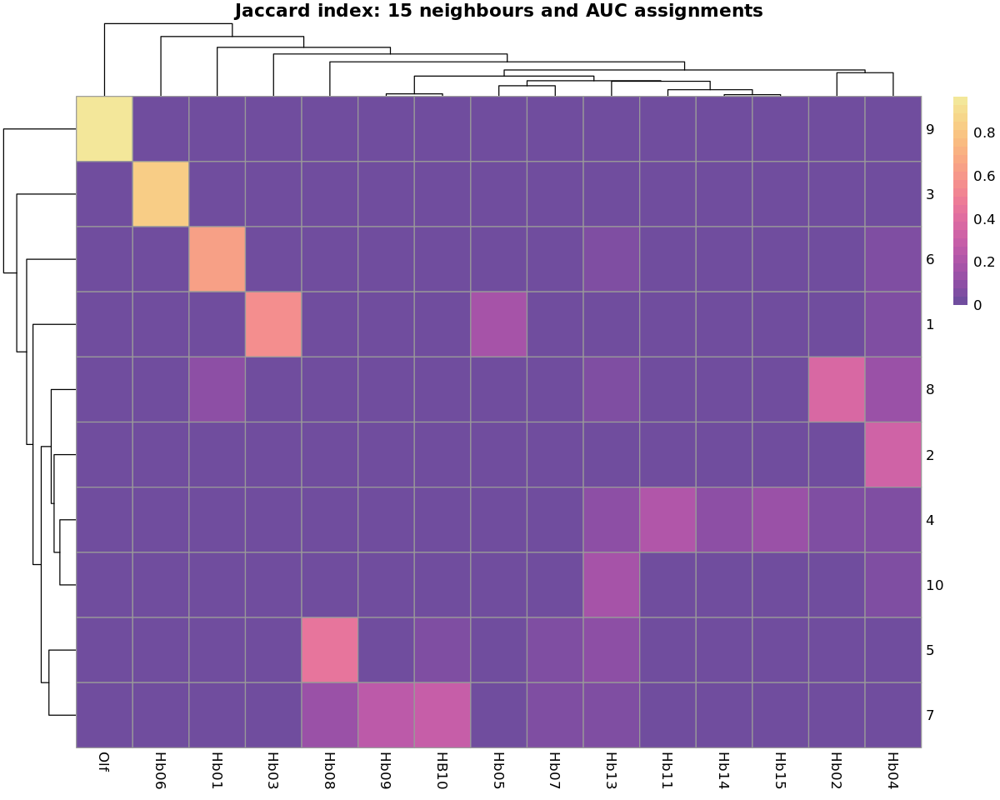

In [39]:
options(repr.plot.width = 10, repr.plot.height = 8)

intersections <- as.matrix(table(colData(fish_sm_reduced)$clustering_15, 
                              colData(fish_sm_reduced)$labels))

unions <- matrix(rowSums(expand.grid(rowSums(intersections), 
                                     colSums(intersections))), 
                 nrow = nrow(intersections), byrow = FALSE) - intersections

jacmat <- intersections/unions


pheatmap(jacmat, 
        cluster_cols = TRUE, 
        cluster_rows = TRUE,
        col = colorspace::sequential_hcl("Sunset", n = 25),
        main = "Jaccard index: 15 neighbours and AUC assignments")


Only 4 clusters (Olf, Hb06, Hb03, and Hb08) are mostly unambiguously reproduced in our clustering. The other assignments are more spread throughout the clustering, meaning that we could not entirely reproduce the original clustering on the Smart-seq2 dataset.

## Circadian rhythm gene expression

Even though we did not entirely reproduce the original clustering in the Smart-seq2 dataset (keeping in mind the appropriate caveats), we can still measure the expression of circadian rhythm genes in the Zebrafish habenula. 
We can do so by just looking at the log-normalized gene expression values in each cluster and each AUC assigned cell type, but we can also use `AUCell` to determine which cells express these genes as a combined signature.

Judging by looking at the distribution of AUCs for the combined signature, we set a threshold of 0.15 to assign the label.

In [40]:
circ_genes <- c("ARNTL1A", "ARNTL1B", "ARNTL2", "CLOCKA", 
                "CLOCKB", "CRY1BB", "CRY1AA", "CRY1AB", 
                "CRY1BA", "NR1D1", "PER1A", "PER1B", 
                "PER2", "PER3")

circ_geneset <- GeneSet(circ_genes, setName = "circadian")

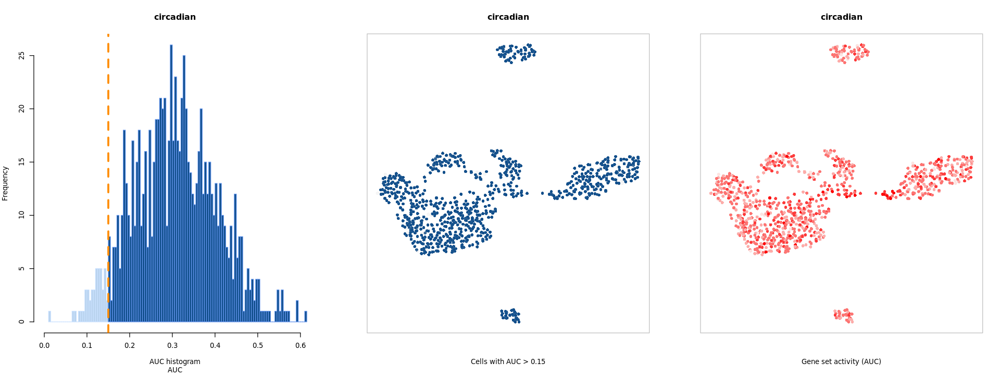

In [41]:
options(repr.plot.width = 16, repr.plot.height = 6)


cell.aucs_circ <- AUCell_calcAUC(circ_geneset, rankings, aucMaxRank = ceiling(0.3 * nrow(rankings)))

results_circ <- t(assay(cell.aucs_circ))

layout(matrix(1:3, nrow = 1))
AUCell_plotTSNE(tSNE = reducedDim(fish_sm_reduced, type = "UMAP"), 
                exprMat = assay(fish_sm_mbn, "logcounts"), 
                cellsAUC = cell.aucs_circ, thresholds = 0.15) 


The whole set of circadian rhythm genes is very active. We can now delve into the expression of single genes in each cluster, first looking at our original clustering and then at the AUC-assigned one:

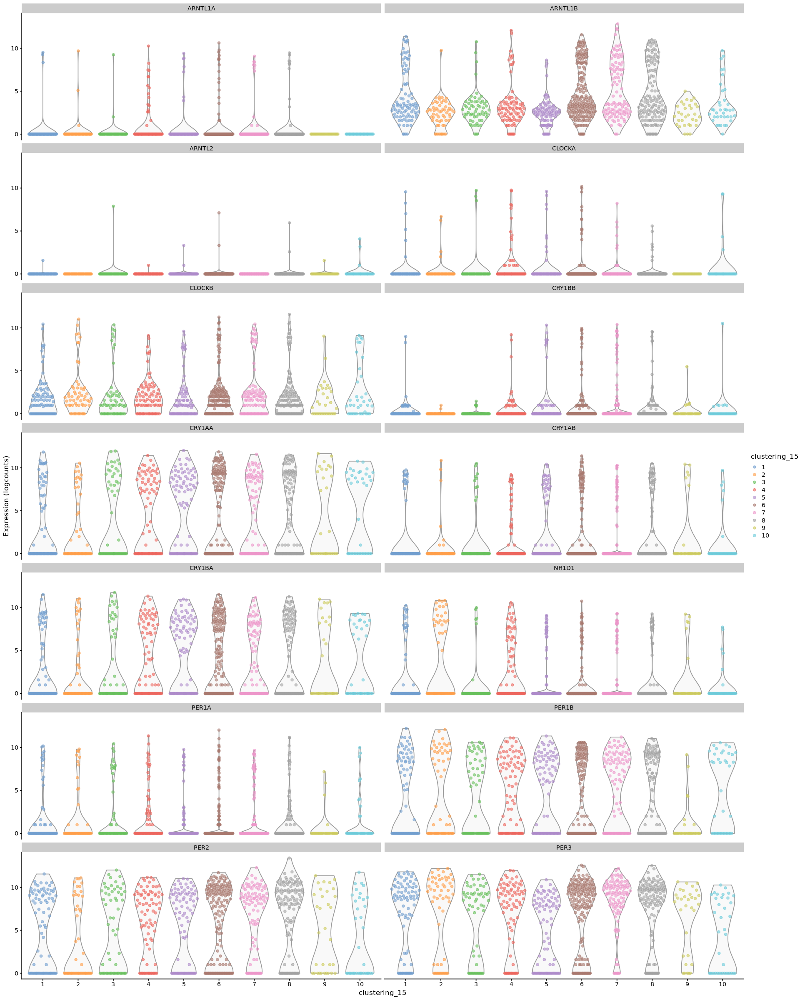

In [42]:
options(repr.plot.width = 16, repr.plot.height = 20)


colData(fish_sm_mbn)$clustering_15 <- colData(fish_sm_reduced)$clustering_15

scater::plotExpression(fish_sm_mbn, circ_genes, x = "clustering_15", colour_by = "clustering_15") +
scale_fill_manual(values = custom_colors$sixteenbit_ordered)


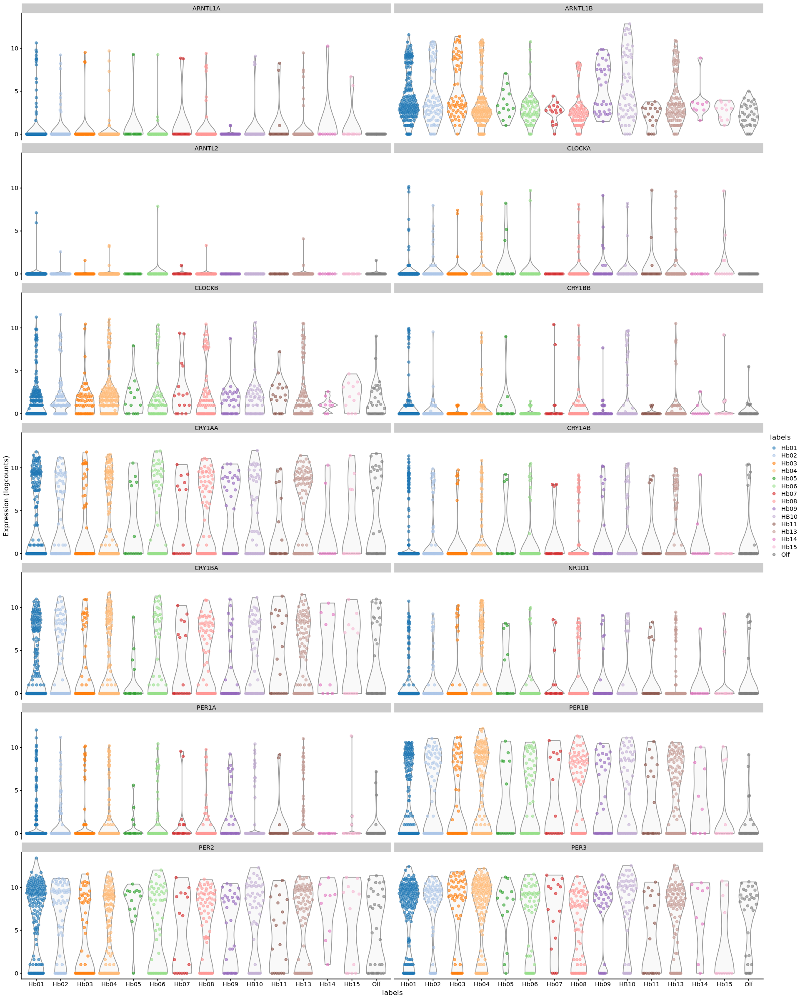

In [43]:
colData(fish_sm_mbn)$labels <- colData(fish_sm_reduced)$labels

scater::plotExpression(fish_sm_mbn, circ_genes, x = "labels", colour_by = "labels") +
scale_fill_manual(values = custom_colors$discrete)


Another possible visualization is the dot plot, popularized by `Seurat`. We will rebuild it using `ggplot2`.

In [44]:
# Create a list of expression matrices divided by cluster
circ_list <- lapply(as.numeric(unique(colData(fish_sm_mbn)$clustering_15)), function(x) {
    pick_cells <- which(colData(fish_sm_mbn)$clustering_15 == x)
    pick_expr <- assay(fish_sm_mbn, "logcounts")[circ_genes, pick_cells]
    rwm <- rowMeans(pick_expr) # mean expression
    rwp <- as.numeric(apply(pick_expr, 1, function(x) sum(x > 0)))/length(pick_cells) * 100 # % of cells in which genes are detected
    rdf <- as.data.frame(cbind(as.numeric(rwm), as.numeric(rwp), rep(x, length(circ_genes)), circ_genes)) 
    return(rdf)
})

# Join all matrices in one dataframe                      
circ_df <- do.call(rbind, circ_list)

colnames(circ_df) <- c("rwm", "rwp", "cluster", "gene")                    

circ_df$rwm <- as.numeric(circ_df$rwm)
circ_df$rwp <- as.numeric(circ_df$rwp)
circ_df$prod <- circ_df$rwp * log10(circ_df$rwm + 1) # percentage * log(mean + 1) as a value for clustering

# Order rows and columns by hierarchical clustering
gene_order <-  hclust(dist(matrix(circ_df$prod, nrow = length(circ_genes))))$order
cluster_order <- hclust(dist(t(matrix(circ_df$prod, nrow = length(circ_genes)))))$order
circ_df$gene <- factor(tolower(circ_df$gene), levels = tolower(circ_df$gene)[gene_order])
circ_df$cluster <- factor(circ_df$cluster, levels = unique(circ_df$cluster)[cluster_order])
        

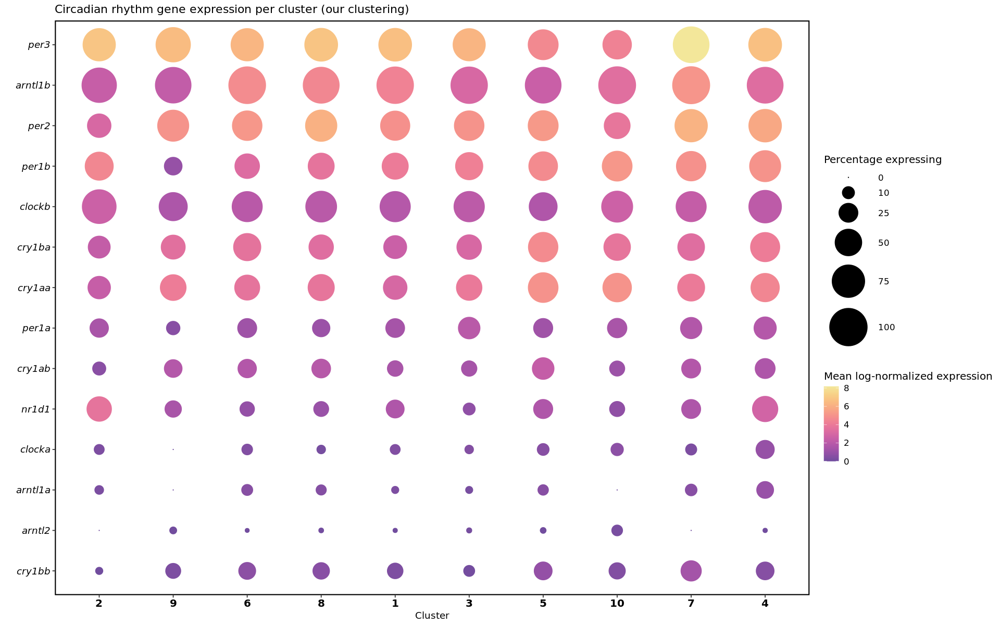

In [45]:
options(repr.plot.width = 16, repr.plot.height = 10)

ggplot(circ_df, aes(col = rwm, size = rwp, x = cluster, y = gene)) + 
geom_point() +
scale_size_continuous(limits = c(0,100), range = c(0,20), breaks = c(0, 10, 25, 50, 75, 100)) +
scale_colour_continuous_sequential(palette = "Sunset", rev = FALSE) +
labs(x = "Cluster", y = "", size = "Percentage expressing", colour = "Mean log-normalized expression") +
theme(legend.key=element_blank(), 
  axis.text.x = element_text(colour = "black", size = 12, face = "bold"), 
  axis.text.y = element_text(colour = "black", face = "italic", size = 11), 
  legend.text = element_text(size = 10, colour ="black"), 
  legend.title = element_text(size = 12), 
  panel.background = element_blank(), 
  panel.border = element_rect(colour = "black", fill = NA, size = 1.2), 
  legend.position = "right") + 
ggtitle("Circadian rhythm gene expression per cluster (our clustering)")

In [46]:
# Create a list of expression matrices divided by AUC label
circ_list_auc <- lapply(as.character(unique(colData(fish_sm_mbn)$labels)), function(x) {
    
    pick_cells <- which(colData(fish_sm_mbn)$labels == x)
    pick_expr <- assay(fish_sm_mbn, "logcounts")[circ_genes,pick_cells]
    rwm <- rowMeans(pick_expr)
    rwp <- as.numeric(apply(pick_expr, 1, function(x) sum(x > 0)))/length(pick_cells) * 100
    rdf <- as.data.frame(cbind(as.numeric(rwm), as.numeric(rwp), rep(x, length(circ_genes)), circ_genes))
    return(rdf)
})
                      
# Join all matrices in one dataframe                       
circ_df_auc <- do.call(rbind, circ_list_auc)
colnames(circ_df_auc) <- c("rwm", "rwp", "cluster", "gene")                    

circ_df_auc$rwm <- as.numeric(circ_df_auc$rwm)
circ_df_auc$rwp <- as.numeric(circ_df_auc$rwp)
circ_df_auc$prod <- circ_df$rwp * log10(circ_df_auc$rwm + 1) # percentage * log(mean + 1) as a value for clustering

# Order rows and columns by hierarchical clustering
gene_order <-  hclust(dist(matrix(circ_df_auc$prod, nrow = length(circ_genes))), method = "ward.D2")$order
cluster_order <- hclust(dist(t(matrix(circ_df_auc$prod, nrow = length(circ_genes)))))$order

circ_df_auc$gene <- factor(tolower(circ_df_auc$gene), levels = tolower(circ_df_auc$gene)[gene_order])
circ_df_auc$cluster <- factor(circ_df_auc$cluster, levels = unique(circ_df_auc$cluster)[cluster_order])
       

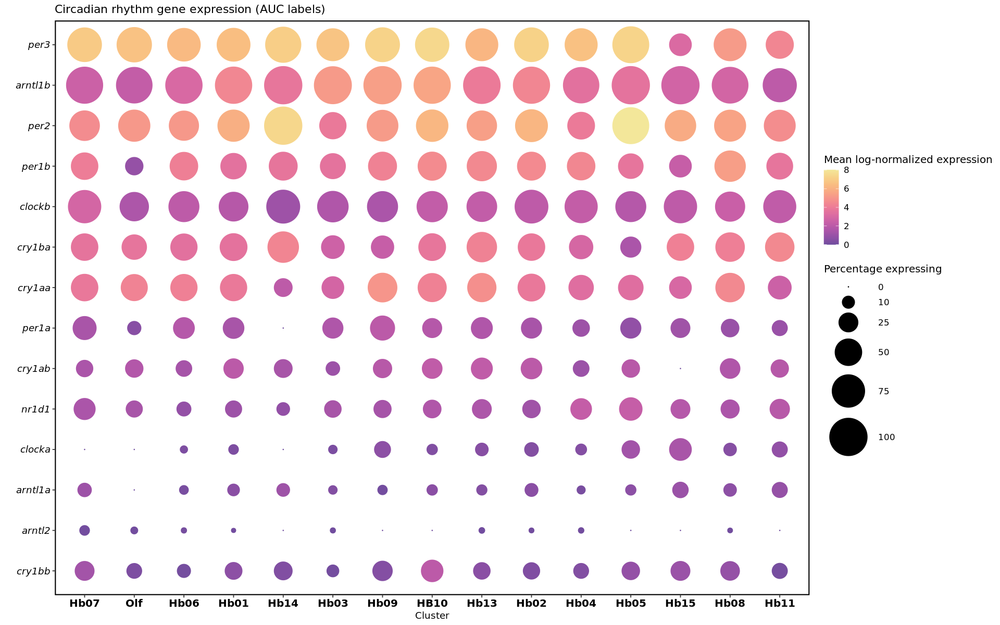

In [47]:
ggplot(circ_df_auc, aes(col = rwm, size = rwp, x = cluster, y = gene)) + 
geom_point() +
scale_size_continuous(limits = c(0,100), range = c(0.1,20), breaks = c(0, 10, 25, 50, 75, 100)) +
scale_colour_continuous_sequential(palette = "Sunset", rev = FALSE) +
labs(x = "Cluster", y = "", size = "Percentage expressing", colour = "Mean log-normalized expression") +
theme(legend.key=element_blank(), 
  axis.text.x = element_text(colour = "black", size = 12, face = "bold"), 
  axis.text.y = element_text(colour = "black", face = "italic", size = 11), 
  legend.text = element_text(size = 10, colour ="black"), 
  legend.title = element_text(size = 12), 
  panel.background = element_blank(), panel.border = element_rect(colour = "black", fill = NA, size = 1.2), 
  legend.position = "right") +
ggtitle("Circadian rhythm gene expression (AUC labels)")

We can see how most genes are consistently expressed, with _per_ and _cry1ba / cry1aa, clockb,_ and _arntl1b_ being the most expressed ones in the larval Smart-seq2 dataset.

## 10X larval habenula: QC metrics and filtering

We apply the same workflow to the 10X data, keeping in mind that there are fundamental differences in the amount of genes measured, cells captured, and depth of sequencing per cell.

In [48]:
fish_10x_larv <- SingleCellExperiment(assays = list("counts" = as.matrix(rawdata_10x_1)), 
                           colData = colnames(rawdata_10x_1),
                           rowData = rownames(rawdata_10x_1))

fish_10x_larv_feat_QC <- scater::perFeatureQCMetrics(fish_10x_larv)

rowData(fish_10x_larv) <- cbind(rowData(fish_10x_larv), fish_10x_larv_feat_QC)

In [49]:
# Metrics for filtering
fish_10x_larv_QC <- perCellQCMetrics(fish_10x_larv, subsets = list(mito = grep("^MT-", rownames(fish_sm)), Malat1 = grep("MALAT1", rownames(fish_sm)), Ribo = grep("^MRPL|^MRPS|^RPL|^RPS", rownames(fish_sm))))


low.lib <- isOutlier(log10(fish_10x_larv_QC$sum), type = "lower", nmad=3)

low.genes <- isOutlier(log10(fish_10x_larv_QC$detected), type = "lower", nmad=3)

high.mt <- isOutlier(fish_10x_larv_QC$subsets_mito_percent, type = "higher", nmad = 4)

high.malat1 <- isOutlier(fish_10x_larv_QC$subsets_Malat1_percent, type = "higher", nmad = 3)

high.ribo <- isOutlier(fish_10x_larv_QC$subsets_Ribo_percent, type = "higher", nmad = 3)


data.frame(LowLib=sum(low.lib), 
           LowNgenes=sum(low.genes), 
           HighMT = sum(high.mt),
           HighMalat1 = sum(high.malat1), 
           HighRibo = sum(high.ribo))

fish_10x_larv_QC$discard <- low.lib | low.genes | high.mt | high.malat1 | high.ribo

table(fish_10x_larv_QC$discard)

LowLib,LowNgenes,HighMT,HighMalat1,HighRibo
<int>,<int>,<int>,<int>,<int>
51,87,3,117,37



FALSE  TRUE 
 4130   235 

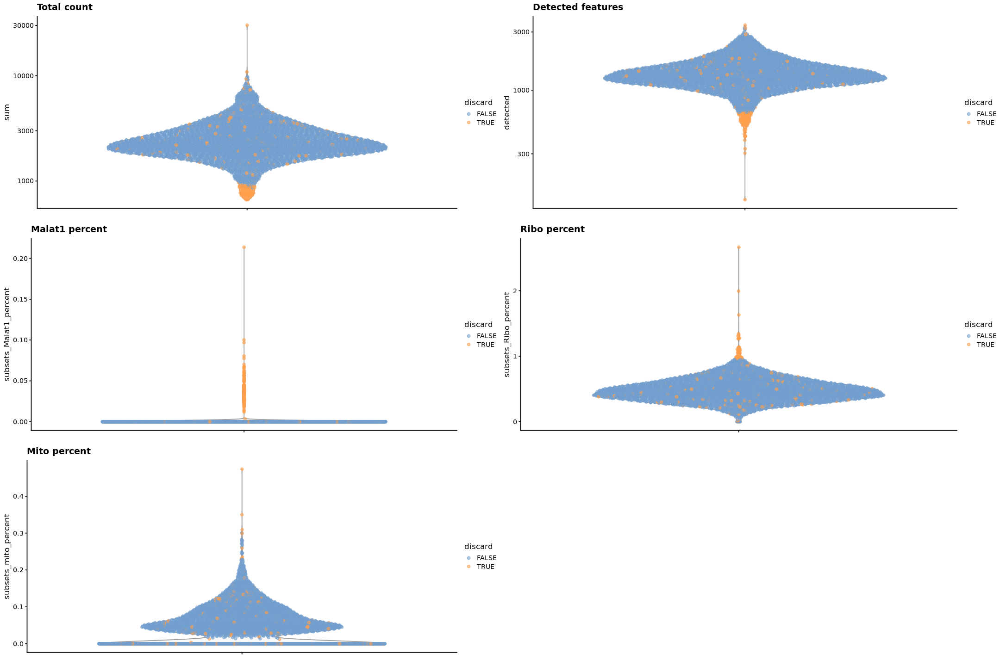

In [50]:
options(repr.plot.width = 18, repr.plot.height = 12)


colData(fish_10x_larv) <- cbind(colData(fish_10x_larv), fish_10x_larv_QC)
fish_10x_larv$discard <- fish_10x_larv_QC$discard

gridExtra::grid.arrange(
    plotColData(fish_10x_larv, y="sum", colour_by="discard") +
        scale_y_log10() + ggtitle("Total count"),
    plotColData(fish_10x_larv, y="detected", colour_by="discard") +
        scale_y_log10() + ggtitle("Detected features"),
     plotColData(fish_10x_larv,y="subsets_Malat1_percent",
        colour_by="discard") + ggtitle("Malat1 percent"),
    plotColData(fish_10x_larv, y="subsets_Ribo_percent",
        colour_by="discard") + ggtitle("Ribo percent"),
    plotColData(fish_10x_larv, y="subsets_mito_percent",
        colour_by="discard") + ggtitle("Mito percent"),
    ncol=2)

The data appears to have been already filtered, so we do not apply any additional filter.

## Doublet detection

The incidence of doublets (two cells encapsulated in a single droplet) is non-negligible in 10X data, as it may create artificial clustering results. 

We use the `scDblFinder` package to identify potential doublets. `scDblFinder` overclusters the data in reduced space and creates artificial doublets across clusters. Then, it uses a nearest-neighbour search to determine which cells in the dataset exhibit a similar profile to the artificial doublets, and flags them. We don't remove doublets yet, but we keep track of them especially to make sense of potentially confusing clustering results.

In [51]:
set.seed(420)
fish_10x_larv <- scDblFinder(fish_10x_larv)

Clustering cells...

11 clusters

Creating ~5000 artifical doublets...

Dimensional reduction

Finding KNN...

Evaluating cell neighborhoods...

Training model...

Finding threshold...

Threshold found:0.611

161 (3.7%) doublets called



In [52]:
table(fish_10x_larv$scDblFinder.class)


singlet doublet 
   4204     161 

A minority of cells has been flagged as doublet. We will show them in the clustering later on.

## Normalization

In this case there is only one 10X larval dataset, so there are no batch effects to control for/correct.

In [53]:
set.seed(46290)

fish_10x_larv_clusters <- quickCluster(fish_10x_larv)

table(fish_10x_larv_clusters)

fish_10x_larv_clusters
  1   2   3   4   5   6   7   8   9  10  11  12  13  14 
266 346 244 107 341 559 438 286 447 243 316 423 141 208 

In [54]:
fish_10x_larv <- computeSumFactors(fish_10x_larv, clusters = fish_10x_larv_clusters)
fish_10x_larv <- logNormCounts(fish_10x_larv)

## Dimensionality reduction

Again, only one dataset and no batch effects, so only one variance estimation is needed, and we select the top 2000 HVGs.

In [55]:
fish_10x_larv_var <- modelGeneVar(fish_10x_larv)

In [56]:
choose_hvgs <- getTopHVGs(fish_10x_larv_var, n = 2000)

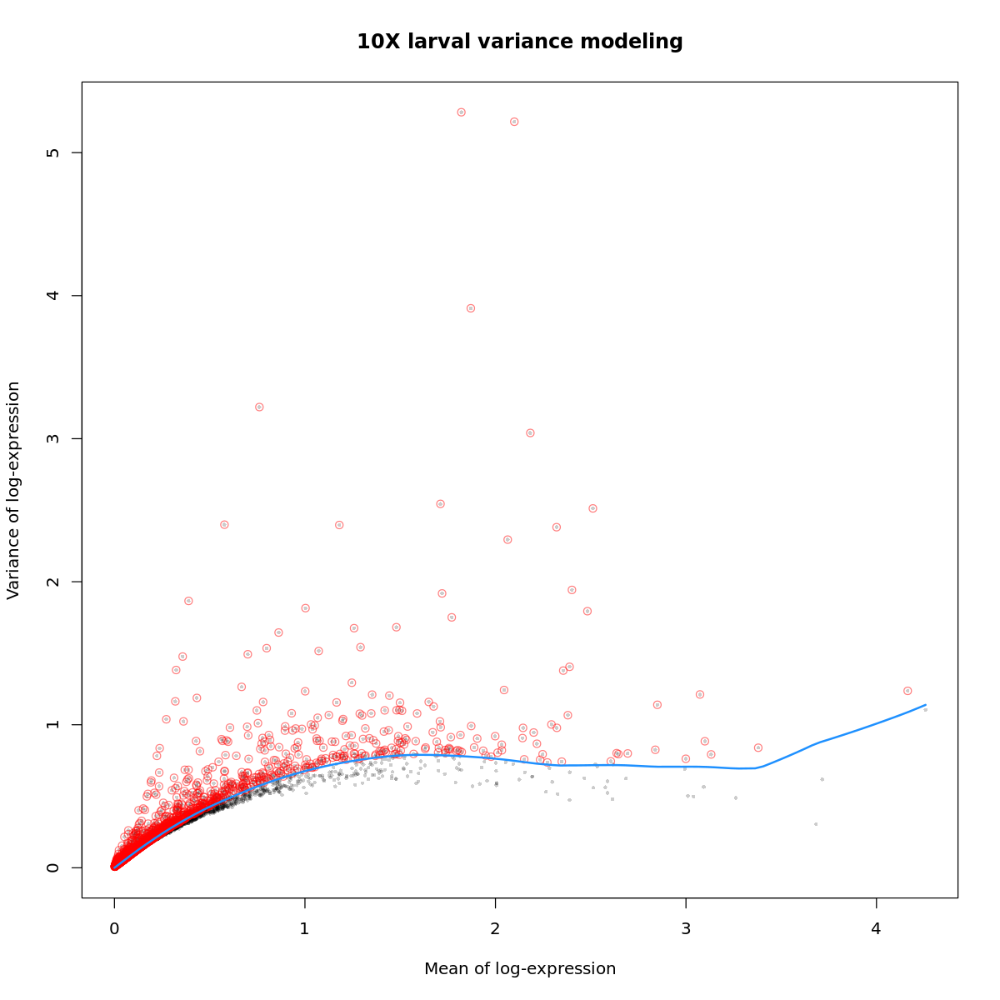

In [57]:
options(repr.plot.width = 10, repr.plot.height = 10)
 
plot(fish_10x_larv_var$mean, 
     fish_10x_larv_var$total, 
     main="10X larval variance modeling", 
     pch=16, 
     cex=0.5,  
     col=rgb(0,0,0,0.2),
     xlab="Mean of log-expression", 
     ylab="Variance of log-expression")

points(fish_10x_larv_var[choose_hvgs, "mean"], 
       fish_10x_larv_var[choose_hvgs, "total"], 
       col = rgb(1,0,0,0.5))

curfit <- metadata(fish_10x_larv_var)

curve(curfit$trend(x), 
      col='dodgerblue', 
      add = TRUE, 
      lwd = 2)

We run dimensionality reduction using the HVGs.

In [58]:
set.seed(64209)

fish_10x_larv <- runPCA(fish_10x_larv, 
                      subset_row = choose_hvgs, 
                      exprs_values = "logcounts") 

Dimensionality estimation:

In [59]:
floor(sqrt(ncol(fish_10x_larv))) # number of neighbours

[1] 66

In [60]:
intrinsicDimension::maxLikGlobalDimEst(reducedDim(fish_10x_larv, "PCA"), k = 66)

Dimension estimate: 11.35494

The authors used 36 dimensions in PCA space to perform their clustering. However, the estimate from `intrinsicDimension` estimates the dimensionality of the dataset at about 11 dimensions (which we will round up to 12). Moreover, the HVG estimation procedure in this workflow is not the same as the one used by the authors.
We can evaluate the differences in clustering results using these two values.

In [61]:
set.seed(69)

fish_10x_larv_12dim <- fish_10x_larv
fish_10x_larv_36dim <- fish_10x_larv

reducedDim(fish_10x_larv_12dim, "UMAP") <- uwot::umap(reducedDim(fish_10x_larv_12dim, "PCA")[,1:12], 
                                                     n_neighbors = 66, 
                                                     min_dist = 0.7)

reducedDim(fish_10x_larv_36dim, "UMAP") <- uwot::umap(reducedDim(fish_10x_larv_36dim, "PCA")[,1:36], 
                                                     n_neighbors = 66, 
                                                     min_dist = 0.7)

fish_10x_larv_12dim <- runTSNE(fish_10x_larv_12dim, 
                               dimred = "PCA", 
                               n_dimred = 1:12)

fish_10x_larv_36dim <- runTSNE(fish_10x_larv_36dim, 
                               dimred = "PCA", 
                               n_dimred = 1:36)

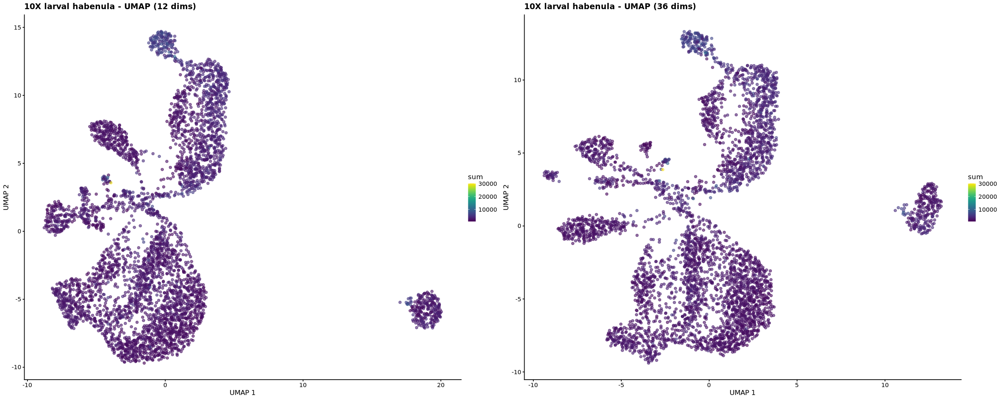

In [62]:
options(repr.plot.width = 20, repr.plot.height = 8)

gridExtra::grid.arrange(
    plotReducedDim(fish_10x_larv_12dim, dimred = "UMAP", colour_by = "sum") + 
    ggtitle("10X larval habenula - UMAP (12 dims)"),
    
    plotReducedDim(fish_10x_larv_36dim, dimred = "UMAP", colour_by = "sum") + 
    ggtitle("10X larval habenula - UMAP (36 dims)"),
    ncol = 2)

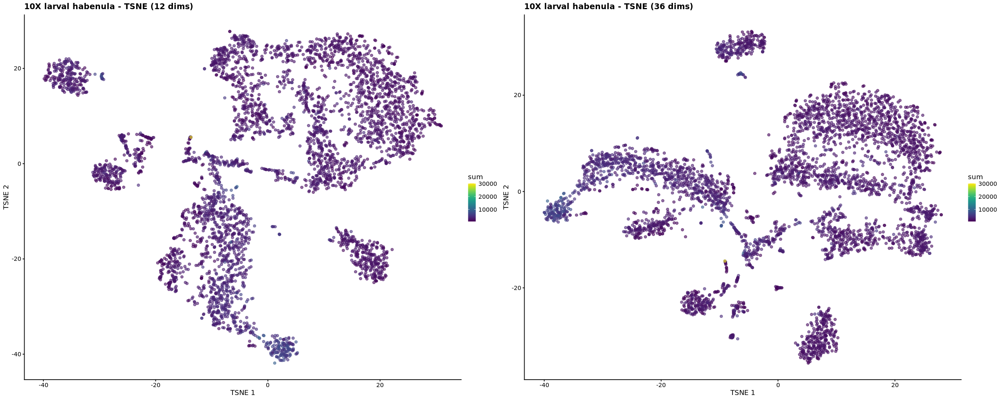

In [63]:
gridExtra::grid.arrange(
    plotReducedDim(fish_10x_larv_12dim, dimred = "TSNE", colour_by = "sum") + 
    ggtitle("10X larval habenula - TSNE (12 dims)"),
    
    plotReducedDim(fish_10x_larv_36dim, dimred = "TSNE", colour_by = "sum") + 
    ggtitle("10X larval habenula - TSNE (36 dims)"),
    ncol = 2)

There are no big differences visualization-wise using 12 or 36 dimensions.

Let's look at doublets (using 12 dimensions):

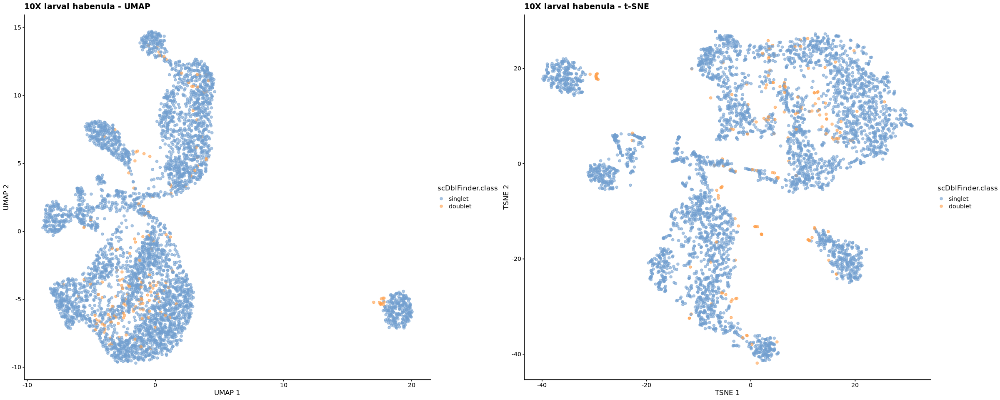

In [64]:
options(repr.plot.width = 20, repr.plot.height = 8)

gridExtra::grid.arrange(
    plotReducedDim(fish_10x_larv_12dim, 
                   dimred = "UMAP", 
                   colour_by = "scDblFinder.class") + 
    ggtitle("10X larval habenula - UMAP"),
    
    plotReducedDim(fish_10x_larv_12dim, 
                   dimred = "TSNE", 
                   colour_by = "scDblFinder.class") + 
    ggtitle("10X larval habenula - t-SNE"),
    ncol = 2)

## Clustering
We perform the graph nearest neighbour search using 12 and 36 dimensions.

In [65]:
set.seed(42096)

reducedDim(fish_10x_larv_12dim, type = "PCA") <- reducedDim(fish_10x_larv_12dim, type = "PCA")[,1:12]
reducedDim(fish_10x_larv_36dim, type = "PCA") <- reducedDim(fish_10x_larv_36dim, type = "PCA")[,1:36]

# 12 dimensions: graph building

fish_10x_larv_12d_SNN_5 <- buildSNNGraph(fish_10x_larv_12dim, use.dimred = "PCA", type = "jaccard", k = 5)
fish_10x_larv_12d_SNN_10 <- buildSNNGraph(fish_10x_larv_12dim, use.dimred = "PCA", type = "jaccard", k = 10)
fish_10x_larv_12d_SNN_15 <- buildSNNGraph(fish_10x_larv_12dim, use.dimred = "PCA", type = "jaccard", k = 15)
fish_10x_larv_12d_SNN_20 <- buildSNNGraph(fish_10x_larv_12dim, use.dimred = "PCA", type = "jaccard", k = 20)
fish_10x_larv_12d_SNN_30 <- buildSNNGraph(fish_10x_larv_12dim, use.dimred = "PCA", type = "jaccard", k = 30)

# 12 dimensions: Louvain clustering

fish_10x_larv_12d_clusters_5  <- igraph::cluster_louvain(fish_10x_larv_12d_SNN_5)
fish_10x_larv_12d_clusters_10  <- igraph::cluster_louvain(fish_10x_larv_12d_SNN_10)
fish_10x_larv_12d_clusters_15  <- igraph::cluster_louvain(fish_10x_larv_12d_SNN_15)
fish_10x_larv_12d_clusters_20  <- igraph::cluster_louvain(fish_10x_larv_12d_SNN_20)
fish_10x_larv_12d_clusters_30  <- igraph::cluster_louvain(fish_10x_larv_12d_SNN_30)

# 36 dimensions: graph building

fish_10x_larv_36d_SNN_5 <- buildSNNGraph(fish_10x_larv_36dim, use.dimred = "PCA", type = "jaccard", k = 5)
fish_10x_larv_36d_SNN_10 <- buildSNNGraph(fish_10x_larv_36dim, use.dimred = "PCA", type = "jaccard", k = 10)
fish_10x_larv_36d_SNN_15 <- buildSNNGraph(fish_10x_larv_36dim, use.dimred = "PCA", type = "jaccard", k = 15)
fish_10x_larv_36d_SNN_20 <- buildSNNGraph(fish_10x_larv_36dim, use.dimred = "PCA", type = "jaccard", k = 20)
fish_10x_larv_36d_SNN_30 <- buildSNNGraph(fish_10x_larv_36dim, use.dimred = "PCA", type = "jaccard", k = 30)

# 36 dimensions: Louvain clustering

fish_10x_larv_36d_clusters_5  <- igraph::cluster_louvain(fish_10x_larv_36d_SNN_5)
fish_10x_larv_36d_clusters_10  <- igraph::cluster_louvain(fish_10x_larv_36d_SNN_10)
fish_10x_larv_36d_clusters_15  <- igraph::cluster_louvain(fish_10x_larv_36d_SNN_15)
fish_10x_larv_36d_clusters_20  <- igraph::cluster_louvain(fish_10x_larv_36d_SNN_20)
fish_10x_larv_36d_clusters_30  <- igraph::cluster_louvain(fish_10x_larv_36d_SNN_30)

In [66]:
clusterings_10x_12d <- as.data.frame(
               cbind(fish_10x_larv_12d_clusters_5$membership,
                     fish_10x_larv_12d_clusters_10$membership,
                     fish_10x_larv_12d_clusters_15$membership,
                     fish_10x_larv_12d_clusters_20$membership,
                     fish_10x_larv_12d_clusters_30$membership))

clusterings_10x_36d <- as.data.frame(
               cbind(fish_10x_larv_36d_clusters_5$membership,
                     fish_10x_larv_36d_clusters_10$membership,
                     fish_10x_larv_36d_clusters_15$membership,
                     fish_10x_larv_36d_clusters_20$membership,
                     fish_10x_larv_36d_clusters_30$membership))

colnames(clusterings_10x_12d) <- c("SNN_5", "SNN_4", "SNN_3", "SNN_2", "SNN_1")
colnames(clusterings_10x_36d) <- c("SNN_5", "SNN_4", "SNN_3", "SNN_2", "SNN_1")

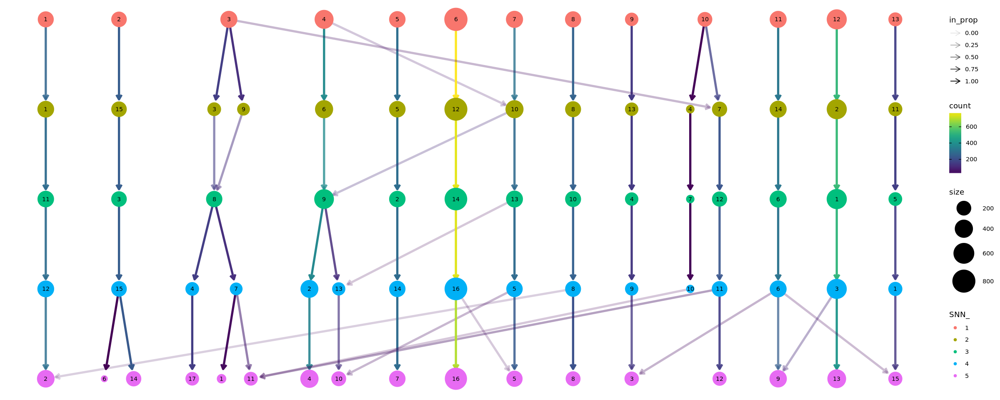

In [67]:
clustree(clusterings_10x_12d, prefix = "SNN_")

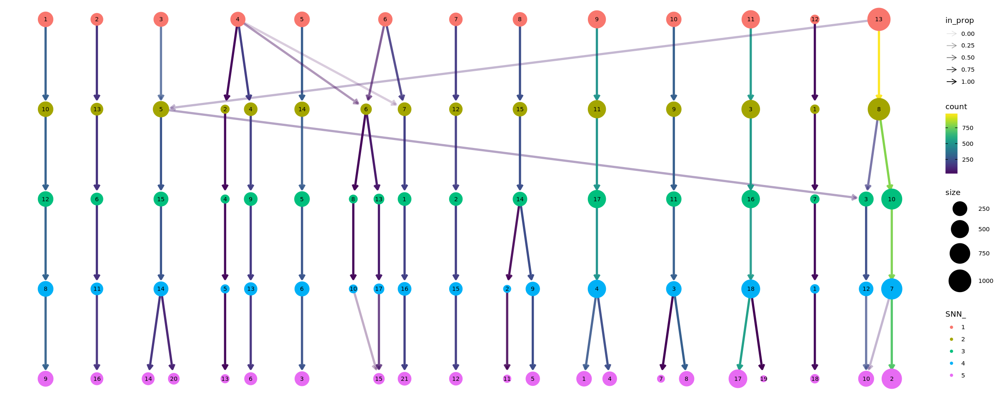

In [68]:
clustree(clusterings_10x_36d, prefix = "SNN_")

We will consider clusterings using 5 and 10 neighbours for 12 dimensions, 10 and 15 neighbours for 36 dimensions, since these parameters yield numbers of clusters similar to the ones identified by the authors of the original publication.

In [69]:
colData(fish_10x_larv_12dim)$clustering_5 <- factor(clusterings_10x_12d$SNN_5)
colData(fish_10x_larv_12dim)$clustering_10 <- factor(clusterings_10x_12d$SNN_4)

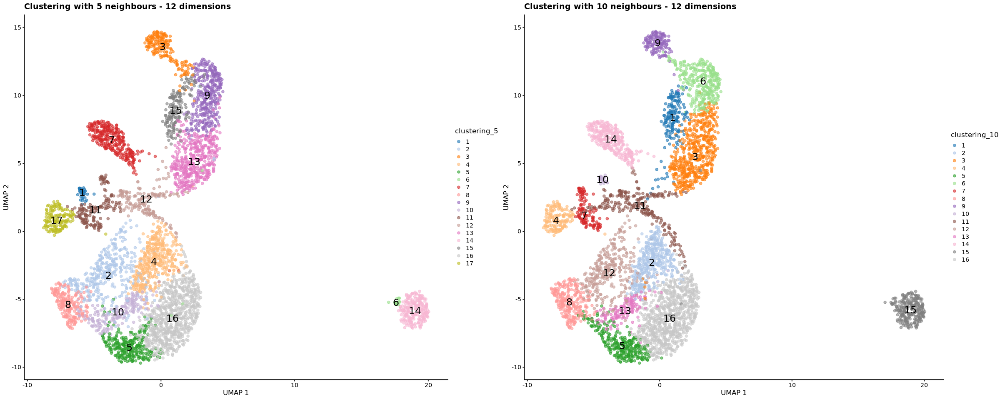

In [70]:
options(repr.plot.width = 20, repr.plot.height = 8)

gridExtra::grid.arrange(
    plotReducedDim(fish_10x_larv_12dim, dimred = "UMAP", colour_by = "clustering_5", text_by = "clustering_5", ) + 
ggtitle("Clustering with 5 neighbours - 12 dimensions") + scale_fill_manual(values = custom_colors$discrete),

plotReducedDim(fish_10x_larv_12dim, dimred = "UMAP", colour_by = "clustering_10", text_by = "clustering_10") + 
ggtitle("Clustering with 10 neighbours - 12 dimensions")  + scale_fill_manual(values = custom_colors$discrete),
    ncol = 2)                                          

Let's see where the doublets fall in terms of clusters:

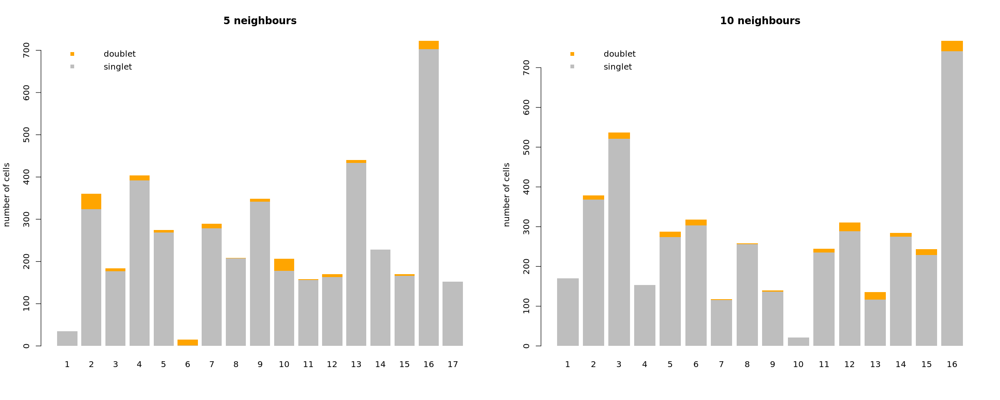

In [71]:
layout(matrix(1:2, nrow = 1))

barplot(table(fish_10x_larv_12dim$scDblFinder.class, fish_10x_larv_12dim$clustering_5), 
        ylab = "number of cells",
        main = '5 neighbours',
        col = c("gray", "orange"),
        border = NA)

legend("topleft", 
       col = c("orange", "gray"), 
       legend = c("doublet", "singlet"), 
       pch = 15,
       bty = 'n')

barplot(table(fish_10x_larv_12dim$scDblFinder.class, fish_10x_larv_12dim$clustering_10), 
        ylab = "number of cells",
        main = '10 neighbours',
        col = c("gray", "orange"),
        border = NA)

legend("topleft", 
       col = c("orange", "gray"), 
       legend = c("doublet", "singlet"), 
       pch = 15,
       bty = 'n')

In the 5-neighbour clustering and using 12 dimensions, cluster 6 is almost entirely made up of doublets. This calls for the removal of the doublets.

In [72]:
colData(fish_10x_larv_36dim)$clustering_10 <- factor(clusterings_10x_36d$SNN_4)
colData(fish_10x_larv_36dim)$clustering_15 <- factor(clusterings_10x_36d$SNN_3)

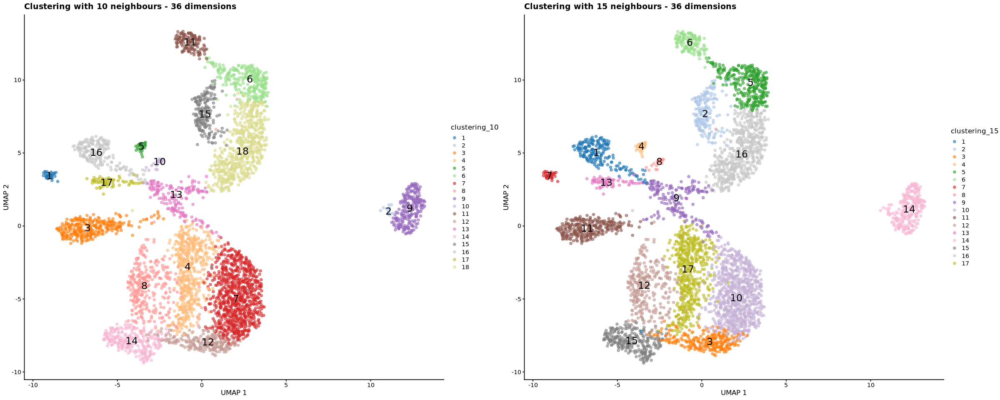

In [73]:
options(repr.plot.width = 20, repr.plot.height = 8)

gridExtra::grid.arrange(
    plotReducedDim(fish_10x_larv_36dim, dimred = "UMAP", colour_by = "clustering_10", text_by = "clustering_10", ) + 
ggtitle("Clustering with 10 neighbours - 36 dimensions") + scale_fill_manual(values = custom_colors$discrete),

plotReducedDim(fish_10x_larv_36dim, dimred = "UMAP", colour_by = "clustering_15", text_by = "clustering_15") + 
ggtitle("Clustering with 15 neighbours - 36 dimensions")  + scale_fill_manual(values = custom_colors$discrete),
    ncol = 2)    

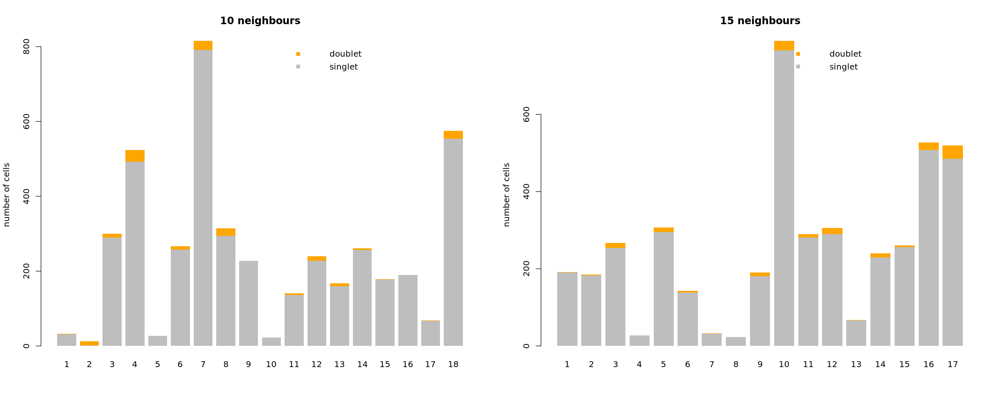

In [74]:
layout(matrix(1:2, nrow = 1))

barplot(table(fish_10x_larv_36dim$scDblFinder.class, fish_10x_larv_36dim$clustering_10), 
        ylab = "number of cells",
        main = '10 neighbours',
        col = c("gray", "orange"),
        border = NA)

legend("topright", 
       col = c("orange", "gray"), 
       legend = c("doublet", "singlet"), 
       pch = 15,
       bty = 'n')

barplot(table(fish_10x_larv_36dim$scDblFinder.class, fish_10x_larv_36dim$clustering_15), 
        ylab = "number of cells",
        main = '15 neighbours',
        col = c("gray", "orange"),
        border = NA)

legend("topright", 
       col = c("orange", "gray"), 
       legend = c("doublet", "singlet"), 
       pch = 15,
       bty = 'n')

The same issue is present in 36-dimensional clustering, so we will remove the doublets and go throught he workflow again.

In [75]:
# Removing doublets
fish_10x_larv_nodbl <- fish_10x_larv[,fish_10x_larv$scDblFinder.class == "singlet"]

set.seed(20694)

# Pre-normalization clustering
fish_10x_larv_nodbl.clusters <- quickCluster(fish_10x_larv_nodbl)

# Normalization
fish_10x_larv_nodbl <- computeSumFactors(fish_10x_larv_nodbl, 
                                         clusters = fish_10x_larv_nodbl.clusters)

fish_10x_larv_nodbl <- logNormCounts(fish_10x_larv_nodbl)

# HVG Selection
fish_10x_larv_nodbl_var <- modelGeneVar(fish_10x_larv_nodbl)

choose_hvgs <- getTopHVGs(fish_10x_larv_nodbl_var, n = 2000)


# Dimensionality reduction
set.seed(24690)

fish_10x_larv_nodbl <- runPCA(fish_10x_larv_nodbl, 
                              subset_row = choose_hvgs, 
                              exprs_values = "logcounts") 

n_neighbors = floor(sqrt(ncol(fish_10x_larv_nodbl)))

intrinsicDimension::maxLikGlobalDimEst(reducedDim(fish_10x_larv_nodbl, "PCA"), 
                                       k = n_neighbors)

Dimension estimate: 11.20791

We round up to 12 again, and keep the 36 dimensions alternative.

We start with 12 dimensions:

In [76]:
set.seed(69)

fish_10x_larv_nodbl_12dim <- fish_10x_larv_nodbl
fish_10x_larv_nodbl_36dim <- fish_10x_larv_nodbl

reducedDim(fish_10x_larv_nodbl_12dim, "UMAP") <- uwot::umap(reducedDim(fish_10x_larv_nodbl_12dim, "PCA")[,1:12], 
                                                     n_neighbors = n_neighbors, 
                                                     min_dist = 0.7)

reducedDim(fish_10x_larv_nodbl_36dim, "UMAP") <- uwot::umap(reducedDim(fish_10x_larv_nodbl_36dim, "PCA")[,1:36], 
                                                     n_neighbors = n_neighbors, 
                                                     min_dist = 0.7)

fish_10x_larv_nodbl_12dim <- runTSNE(fish_10x_larv_nodbl_12dim, 
                                   dimred = "PCA", 
                                   n_dimred = 1:12)

fish_10x_larv_nodbl_36dim <- runTSNE(fish_10x_larv_nodbl_36dim, 
                                   dimred = "PCA", 
                                   n_dimred = 1:36)

In [77]:
fish_10x_larv_nodbl_12dim_reduced <- fish_10x_larv_nodbl_12dim

reducedDim(fish_10x_larv_nodbl_12dim_reduced, type = "PCA") <- reducedDim(fish_10x_larv_nodbl_12dim, type = "PCA")[,1:12]

fish_10x_larv_nodbl_12dim_reduced_SNN_5 <- buildSNNGraph(fish_10x_larv_nodbl_12dim_reduced, 
                                           use.dimred = "PCA", 
                                           type = "jaccard", 
                                           k = 5)

fish_10x_larv_nodbl_12dim_reduced_SNN_10 <- buildSNNGraph(fish_10x_larv_nodbl_12dim_reduced, 
                                                          use.dimred = "PCA", 
                                                          type = "jaccard", 
                                                          k = 10)

fish_10x_larv_nodbl_12dim_clusters_5  <- igraph::cluster_louvain(fish_10x_larv_nodbl_12dim_reduced_SNN_5)
fish_10x_larv_nodbl_12dim_clusters_10  <- igraph::cluster_louvain(fish_10x_larv_nodbl_12dim_reduced_SNN_10)

clusterings_10x_12dim_nodbl <- as.data.frame(
               cbind(fish_10x_larv_nodbl_12dim_clusters_5$membership,
                     fish_10x_larv_nodbl_12dim_clusters_10$membership))

colnames(clusterings_10x_12dim_nodbl) <- c("SNN_5", "SNN_4")

In [78]:
colData(fish_10x_larv_nodbl_12dim_reduced)$clustering_5 <- factor(clusterings_10x_12dim_nodbl$SNN_5)
colData(fish_10x_larv_nodbl_12dim_reduced)$clustering_10 <- factor(clusterings_10x_12dim_nodbl$SNN_4)

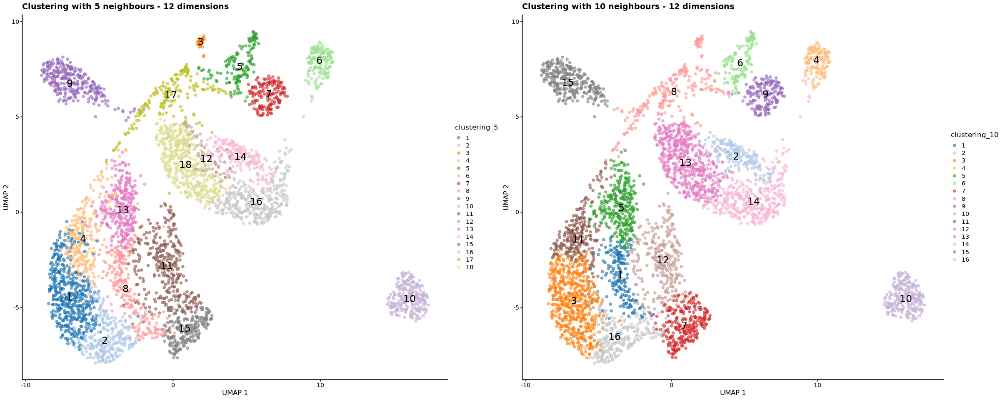

In [79]:
options(repr.plot.width = 20, repr.plot.height = 8)

gridExtra::grid.arrange(
    plotReducedDim(fish_10x_larv_nodbl_12dim_reduced, dimred = "UMAP", colour_by = "clustering_5", text_by = "clustering_5", ) + 
ggtitle("Clustering with 5 neighbours - 12 dimensions") + scale_fill_manual(values = custom_colors$discrete),

plotReducedDim(fish_10x_larv_nodbl_12dim_reduced, dimred = "UMAP", colour_by = "clustering_10", text_by = "clustering_10") + 
ggtitle("Clustering with 10 neighbours - 12 dimensions")  + scale_fill_manual(values = custom_colors$discrete),
    ncol = 2)  

And with 36 dimensions:

In [80]:
fish_10x_larv_nodbl_36dim_reduced <- fish_10x_larv_nodbl_36dim

reducedDim(fish_10x_larv_nodbl_36dim_reduced, type = "PCA") <- reducedDim(fish_10x_larv_nodbl_36dim, type = "PCA")[,1:36]

fish_10x_larv_nodbl_36dim_reduced_SNN_10 <- buildSNNGraph(fish_10x_larv_nodbl_36dim_reduced, 
                                           use.dimred = "PCA", 
                                           type = "jaccard", 
                                           k = 10)

fish_10x_larv_nodbl_36dim_reduced_SNN_15 <- buildSNNGraph(fish_10x_larv_nodbl_36dim_reduced, 
                                                          use.dimred = "PCA", 
                                                          type = "jaccard", 
                                                          k = 15)

fish_10x_larv_nodbl_36dim_clusters_10  <- igraph::cluster_louvain(fish_10x_larv_nodbl_36dim_reduced_SNN_10)
fish_10x_larv_nodbl_36dim_clusters_15  <- igraph::cluster_louvain(fish_10x_larv_nodbl_36dim_reduced_SNN_15)

clusterings_10x_36dim_nodbl <- as.data.frame(
               cbind(fish_10x_larv_nodbl_36dim_clusters_10$membership,
                     fish_10x_larv_nodbl_36dim_clusters_15$membership))

colnames(clusterings_10x_36dim_nodbl) <- c("SNN_4", "SNN_3")

In [81]:
colData(fish_10x_larv_nodbl_36dim_reduced)$clustering_10 <- factor(clusterings_10x_36dim_nodbl$SNN_4)
colData(fish_10x_larv_nodbl_36dim_reduced)$clustering_15 <- factor(clusterings_10x_36dim_nodbl$SNN_3)

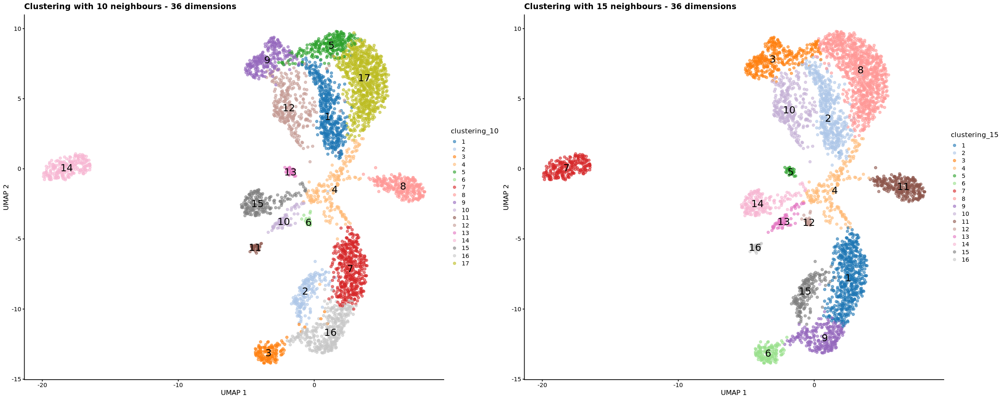

In [82]:
options(repr.plot.width = 20, repr.plot.height = 8)

gridExtra::grid.arrange(
    plotReducedDim(fish_10x_larv_nodbl_36dim_reduced, dimred = "UMAP", colour_by = "clustering_10", text_by = "clustering_10", ) + 
ggtitle("Clustering with 10 neighbours - 36 dimensions") + scale_fill_manual(values = custom_colors$discrete),

plotReducedDim(fish_10x_larv_nodbl_36dim_reduced, dimred = "UMAP", colour_by = "clustering_15", text_by = "clustering_15") + 
ggtitle("Clustering with 15 neighbours - 36 dimensions")  + scale_fill_manual(values = custom_colors$discrete),
    ncol = 2)  

Both 12 and 36 dimensions yield similar clusters (although the numbers of neighbours are different). We can compare both different neighbour choices and different dimensions by comparing their silhouette width distributions:

In [83]:
options(repr.plot.width = 20, repr.plot.height = 10)

# 12 dimensions, 5 and 10 neighbours

silhouette_5_12dim_10x <- as.data.frame(approxSilhouette(reducedDim(fish_10x_larv_nodbl_12dim_reduced, type = "PCA"), 
                               colData(fish_10x_larv_nodbl_12dim_reduced)$clustering_5))

silhouette_10_12dim_10x <- as.data.frame(approxSilhouette(reducedDim(fish_10x_larv_nodbl_12dim_reduced, type = "PCA"), 
                               colData(fish_10x_larv_nodbl_12dim_reduced)$clustering_10))

# 36 dimensions, 10 and 15 neighbours

silhouette_10_36dim_10x <- as.data.frame(approxSilhouette(reducedDim(fish_10x_larv_nodbl_12dim_reduced, type = "PCA"), 
                               colData(fish_10x_larv_nodbl_36dim_reduced)$clustering_10))

silhouette_15_36dim_10x <- as.data.frame(approxSilhouette(reducedDim(fish_10x_larv_nodbl_12dim_reduced, type = "PCA"), 
                               colData(fish_10x_larv_nodbl_36dim_reduced)$clustering_15))

# Clusters and closest alternatives

silhouette_5_12dim_10x$cluster <-  colData(fish_10x_larv_nodbl_12dim_reduced)$clustering_5
silhouette_10_12dim_10x$cluster <-  colData(fish_10x_larv_nodbl_12dim_reduced)$clustering_10

silhouette_5_12dim_10x$closest <- factor(ifelse(silhouette_5_12dim_10x$width > 0, silhouette_5_12dim_10x$cluster, silhouette_5_12dim_10x$other))
silhouette_10_12dim_10x$closest <- factor(ifelse(silhouette_10_12dim_10x$width > 0, silhouette_10_12dim_10x$cluster, silhouette_10_12dim_10x$other))

silhouette_10_36dim_10x$cluster <-  colData(fish_10x_larv_nodbl_36dim_reduced)$clustering_10
silhouette_15_36dim_10x$cluster <-  colData(fish_10x_larv_nodbl_36dim_reduced)$clustering_15

silhouette_10_36dim_10x$closest <- factor(ifelse(silhouette_10_36dim_10x$width > 0, silhouette_10_36dim_10x$cluster, silhouette_10_36dim_10x$other))
silhouette_15_36dim_10x$closest <- factor(ifelse(silhouette_15_36dim_10x$width > 0, silhouette_15_36dim_10x$cluster, silhouette_15_36dim_10x$other))


Visualizing silhouette width distributions for 12 dimensions:

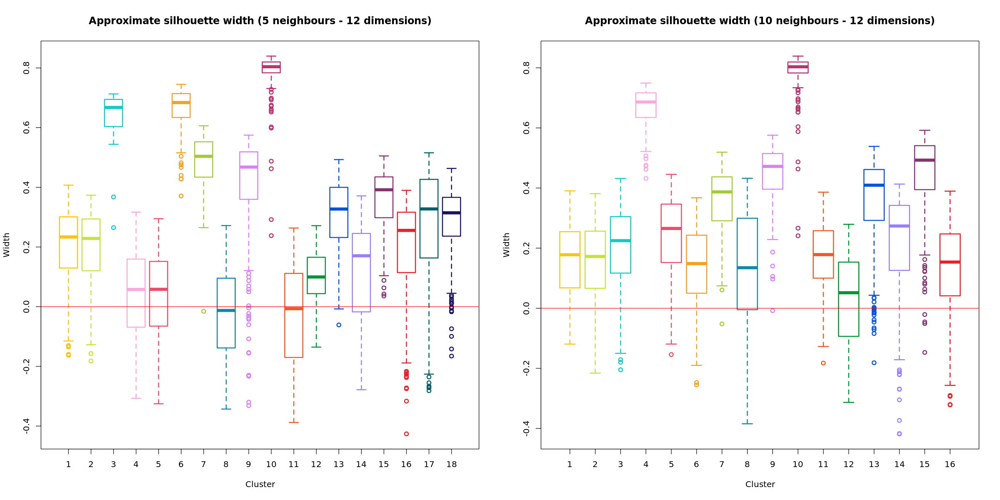

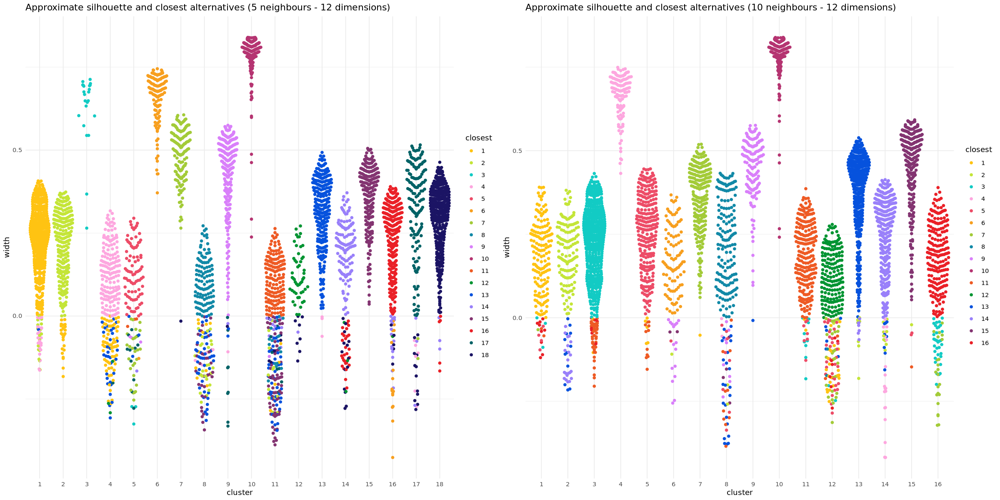

In [84]:
layout(matrix(1:2, nrow  = 1))

boxplot(silhouette_5_12dim_10x$width ~ silhouette_5_12dim_10x$cluster, 
        main = "Approximate silhouette width (5 neighbours - 12 dimensions)", 
        ylab = "Width", 
        xlab = "Cluster",
        border = custom_colors$discrete,
        col = NA,
        lwd = 2)
abline(h = 0, col = 'red')

boxplot(silhouette_10_12dim_10x$width ~ silhouette_10_12dim_10x$cluster, 
        main = "Approximate silhouette width (10 neighbours - 12 dimensions)", 
        ylab = "Width", 
        xlab = "Cluster",
        border = custom_colors$discrete,
        col = NA,
        lwd = 2)
abline(h = 0, col = 'red')

gridExtra::grid.arrange(
ggplot(silhouette_5_12dim_10x, aes(x=cluster, y=width, colour=closest)) + 
    ggbeeswarm::geom_quasirandom(method="smiley")  + 
scale_colour_manual(values = custom_colors$discrete) +
theme_minimal() +
ggtitle("Approximate silhouette and closest alternatives (5 neighbours - 12 dimensions)"),

ggplot(silhouette_10_12dim_10x, aes(x=cluster, y=width, colour=closest)) + 
    ggbeeswarm::geom_quasirandom(method="smiley")  + 
scale_colour_manual(values = custom_colors$discrete) +
theme_minimal() +
ggtitle("Approximate silhouette and closest alternatives (10 neighbours - 12 dimensions)"),
ncol = 2)

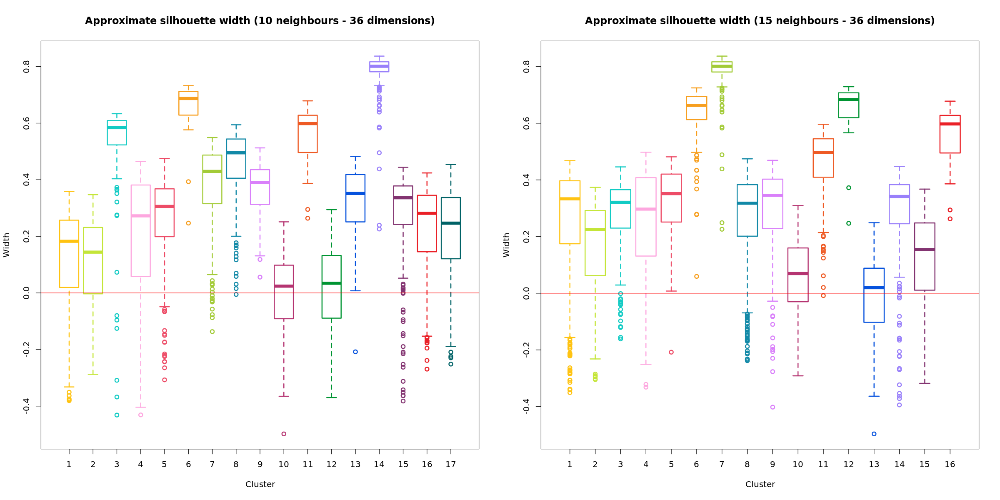

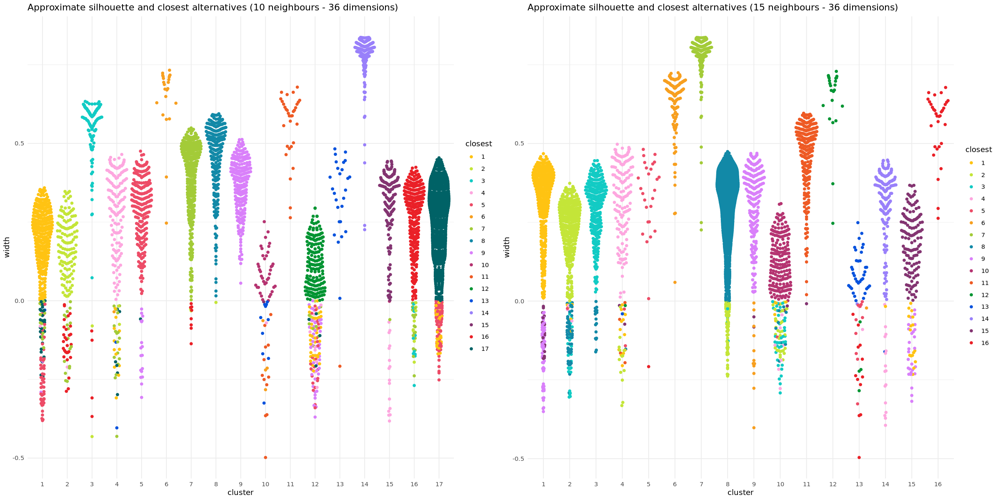

In [85]:
layout(matrix(1:2, nrow  = 1))

boxplot(silhouette_10_36dim_10x$width ~ silhouette_10_36dim_10x$cluster, 
        main = "Approximate silhouette width (10 neighbours - 36 dimensions)", 
        ylab = "Width", 
        xlab = "Cluster",
        border = custom_colors$discrete,
        col = NA,
        lwd = 2)
abline(h = 0, col = 'red')

boxplot(silhouette_15_36dim_10x$width ~ silhouette_15_36dim_10x$cluster, 
        main = "Approximate silhouette width (15 neighbours - 36 dimensions)", 
        ylab = "Width", 
        xlab = "Cluster",
        border = custom_colors$discrete,
        col = NA,
        lwd = 2)
abline(h = 0, col = 'red')

gridExtra::grid.arrange(
ggplot(silhouette_10_36dim_10x, aes(x=cluster, y=width, colour=closest)) + 
    ggbeeswarm::geom_quasirandom(method="smiley")  + 
scale_colour_manual(values = custom_colors$discrete) +
theme_minimal() +
ggtitle("Approximate silhouette and closest alternatives (10 neighbours - 36 dimensions)"),

ggplot(silhouette_15_36dim_10x, aes(x=cluster, y=width, colour=closest)) + 
    ggbeeswarm::geom_quasirandom(method="smiley")  + 
scale_colour_manual(values = custom_colors$discrete) +
theme_minimal() +
ggtitle("Approximate silhouette and closest alternatives (15 neighbours - 36 dimensions)"),
ncol = 2)

The size of this dataset does not allow us to calculate the neighbour purity, but we have a rough idea of how clustering with 15 neighbours in 36 dimensions or 10 neighbours in 12 dimensions affords us a better silhouette width overall. We can compare the modularity scores of these two alternatives:

In [86]:
ratio_10x_10_12dim <- pairwiseModularity(fish_10x_larv_nodbl_12dim_reduced_SNN_10, 
                                         clusterings_10x_12dim_nodbl$SNN_4, 
                                         as.ratio = TRUE)

ratio_10x_15_36dim <- pairwiseModularity(fish_10x_larv_nodbl_36dim_reduced_SNN_15, 
                                         clusterings_10x_36dim_nodbl$SNN_3, 
                                         as.ratio = TRUE)

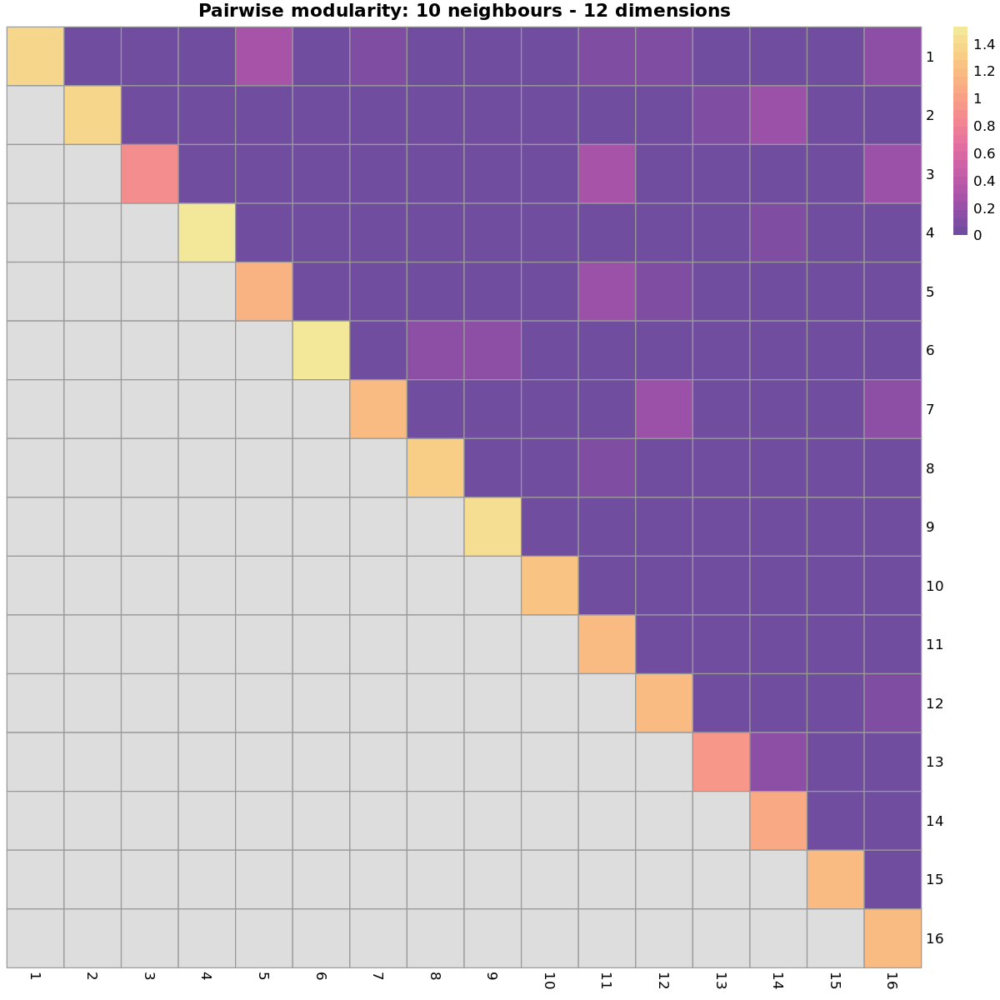

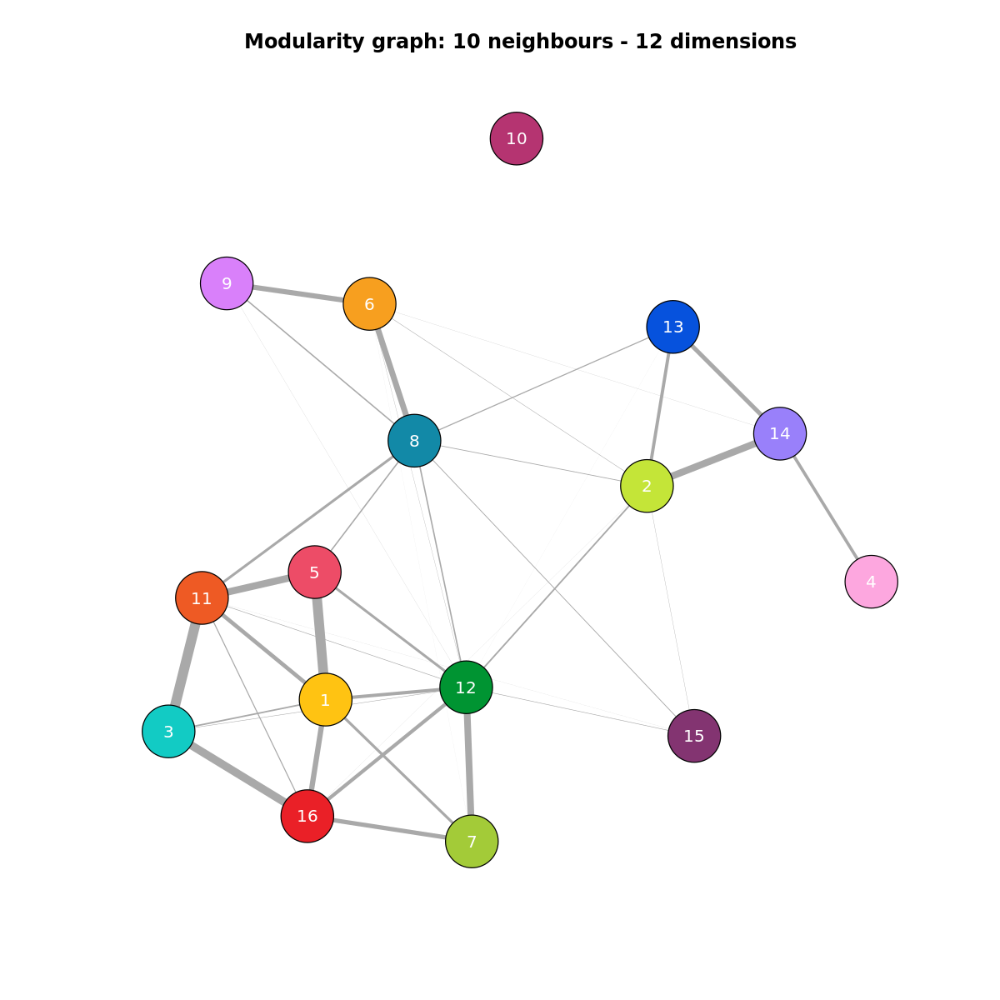

In [87]:
options(repr.plot.width = 10, repr.plot.height = 10)

ratio_10x_10_12dim_mat <- log10(ratio_10x_10_12dim + 1)

pheatmap(ratio_10x_10_12dim_mat, 
        cluster_cols = FALSE, 
        cluster_rows=FALSE,
        col = colorspace::sequential_hcl("Sunset", n = 25),
        main = "Pairwise modularity: 10 neighbours - 12 dimensions")

mod_cluster_10x_10_12dim_graph <- igraph::graph_from_adjacency_matrix(log2(ratio_10x_10_12dim + 1), 
                                                                      mode="upper",
                                                                      weighted=TRUE, 
                                                                      diag=FALSE)

igraph::V(mod_cluster_10x_10_12dim_graph)$color = custom_colors$discrete
igraph::V(mod_cluster_10x_10_12dim_graph)$label.color = "white"
igraph::V(mod_cluster_10x_10_12dim_graph)$label.family = "sans"

set.seed(42069)
plot(mod_cluster_10x_10_12dim_graph, edge.width=igraph::E(mod_cluster_10x_10_12dim_graph)$weight*10,
    layout=igraph::layout_with_fr,
    main = "Modularity graph: 10 neighbours - 12 dimensions")

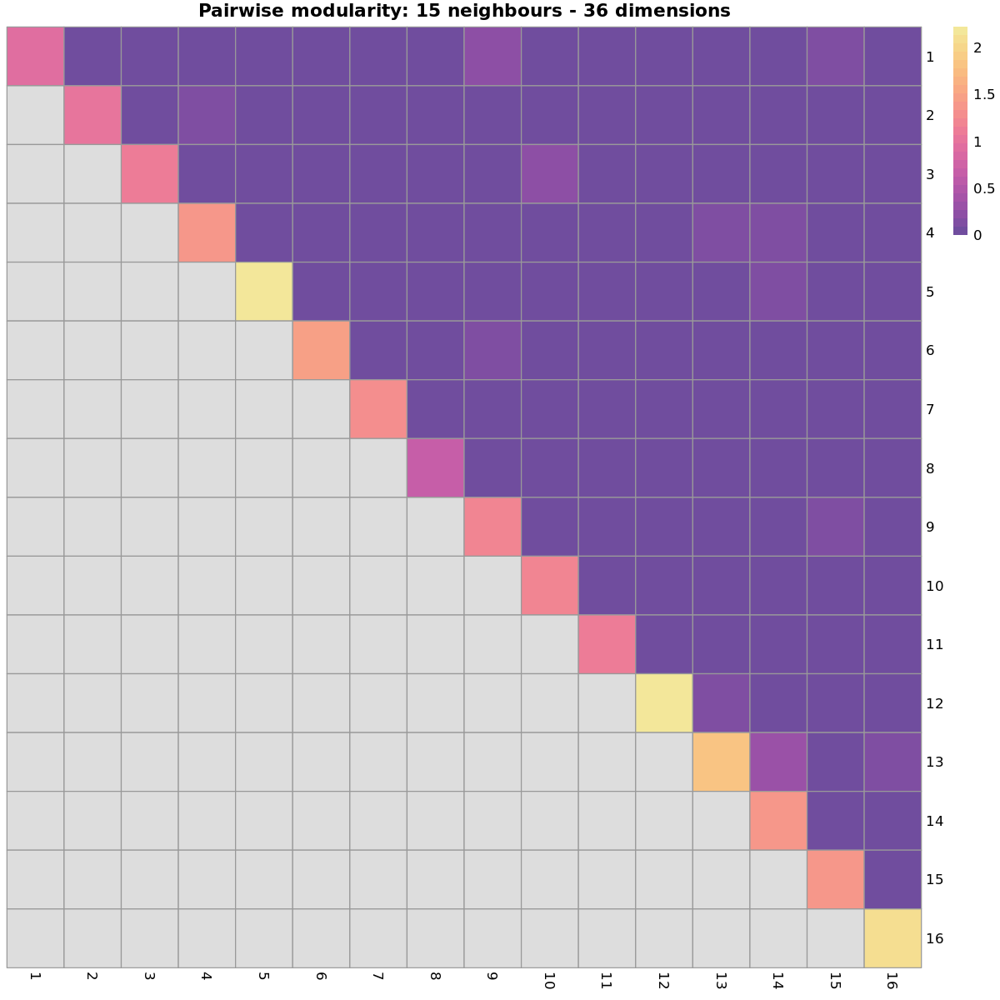

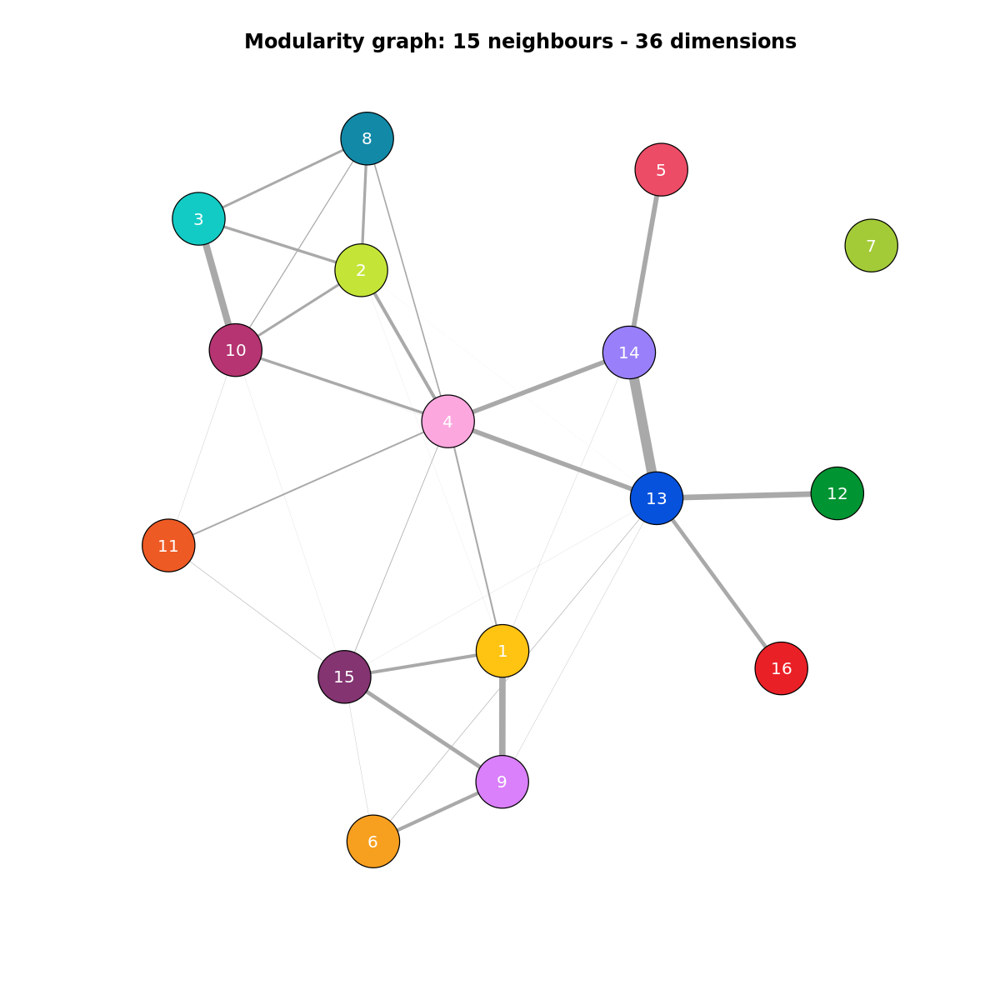

In [88]:
options(repr.plot.width = 10, repr.plot.height = 10)

ratio_10x_15_36dim_mat <- log10(ratio_10x_15_36dim + 1)

pheatmap(ratio_10x_15_36dim_mat, 
        cluster_cols = FALSE, 
        cluster_rows=FALSE,
        col = colorspace::sequential_hcl("Sunset", n = 25),
        main = "Pairwise modularity: 15 neighbours - 36 dimensions")

mod_cluster_10x_10_36dim_graph <- igraph::graph_from_adjacency_matrix(log2(ratio_10x_15_36dim + 1), 
                                                                      mode="upper",
                                                                      weighted=TRUE, 
                                                                      diag=FALSE)

igraph::V(mod_cluster_10x_10_36dim_graph)$color = custom_colors$discrete
igraph::V(mod_cluster_10x_10_36dim_graph)$label.color = "white"
igraph::V(mod_cluster_10x_10_36dim_graph)$label.family = "sans"

set.seed(42069)
plot(mod_cluster_10x_10_36dim_graph, edge.width=igraph::E(mod_cluster_10x_10_36dim_graph)$weight*10,
    layout=igraph::layout_with_fr,
    main = "Modularity graph: 15 neighbours - 36 dimensions")

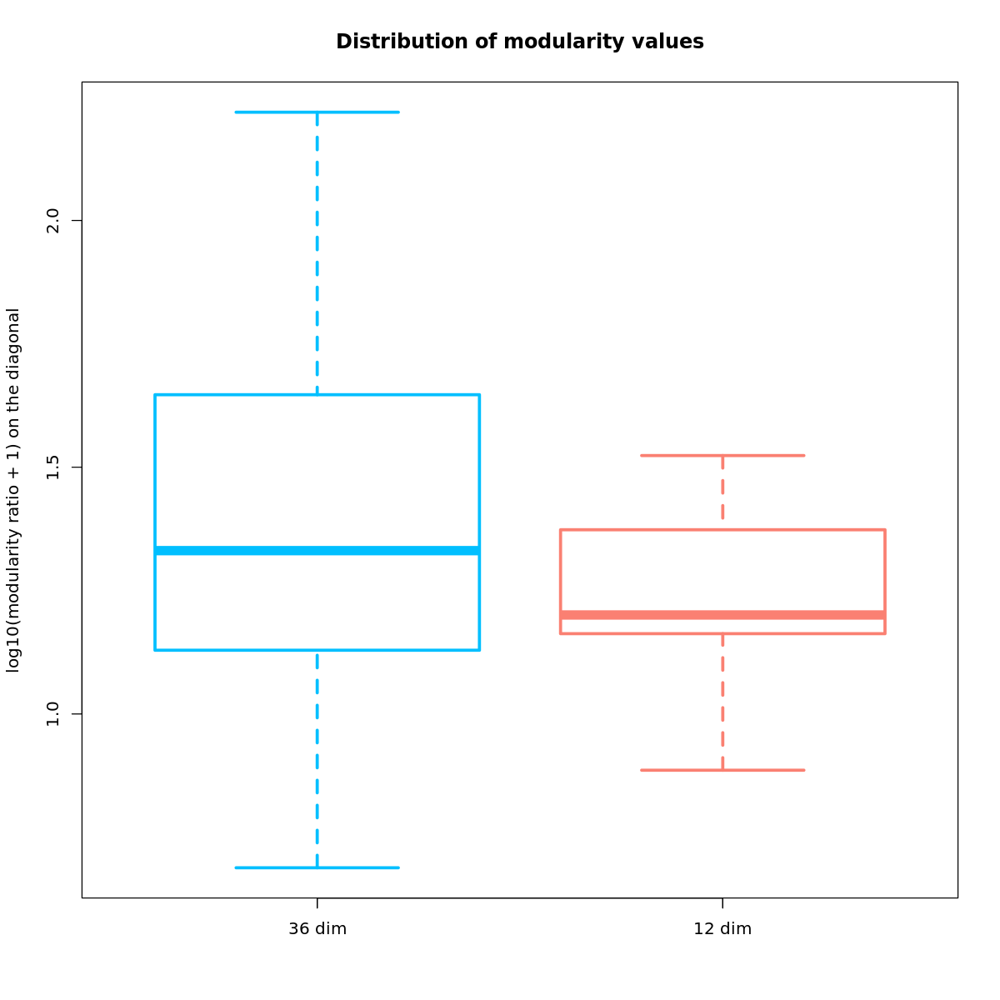

In [89]:
boxplot(diag(ratio_10x_15_36dim_mat), 
        diag(ratio_10x_10_12dim_mat),
        border = c("deepskyblue", "salmon"),
        col = NA,
        lwd = 3,
        ylab = "log10(modularity ratio + 1) on the diagonal",
        main = "Distribution of modularity values")

axis(1, at = c(1,2), labels = c("36 dim", "12 dim"))
     

The clustering in 36 dimensions appears to be slightly more modular. Moreover, as it yields 17 clusters (as opposed to the clusgtering in 12 dimensions which yields 15 clusters), it is easier to merge one cluster with another than to split one cluster in two.

In [90]:
fish_10x_larv_nodbl_reduced <- fish_10x_larv_nodbl_36dim_reduced

fish_10x_larv_nodbl_reduced$clusters_36 <- as.factor(clusterings_10x_36dim_nodbl$SNN_3)
fish_10x_larv_nodbl_reduced$clusters_12 <- as.factor(clusterings_10x_12dim_nodbl$SNN_4)

## Comparison with published clusters

We follow the same workflow using `AUCell`, which should yield better results considering that the larval markers the authors provided were determined using the same 10x dataset.

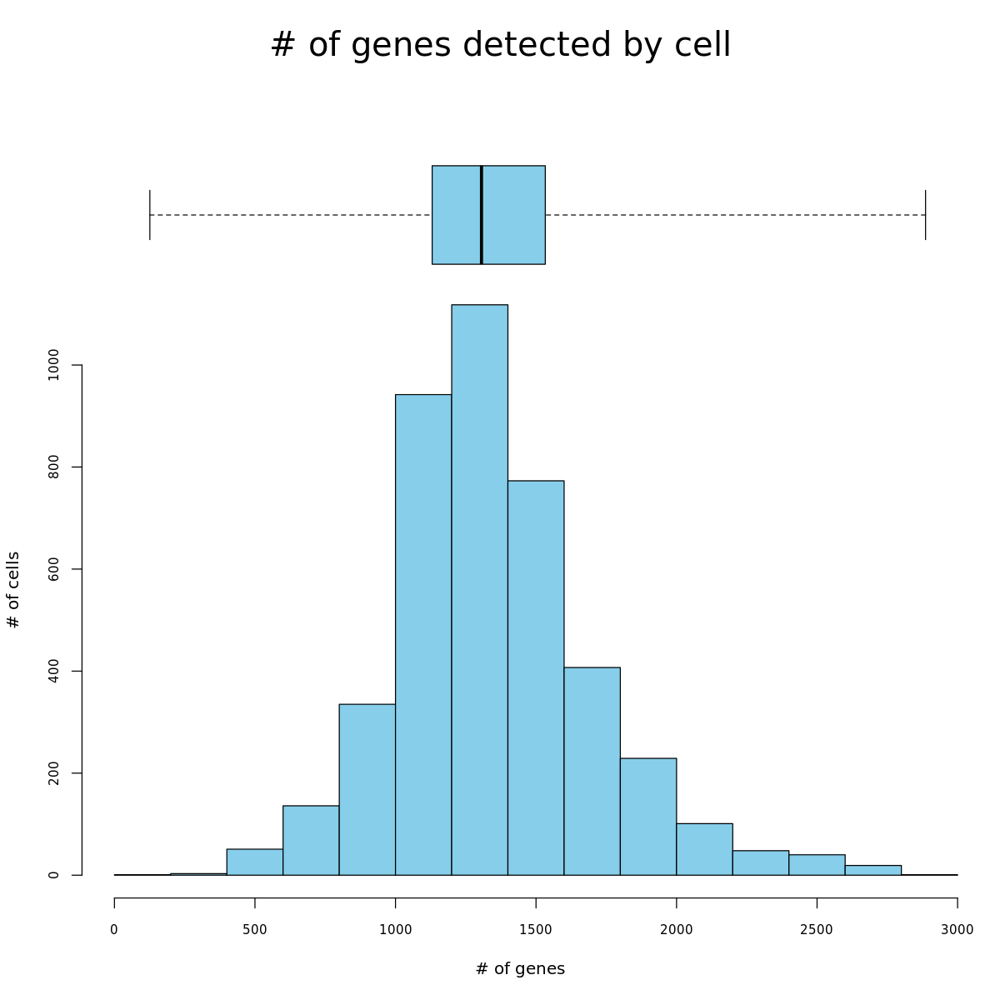

In [91]:
rankings_10X <- AUCell_buildRankings(counts(fish_10x_larv_nodbl_reduced),
    plotStats = TRUE,
    verbose = FALSE)

In [92]:
cell_aucs_10X <- AUCell_calcAUC(all_sets, 
                                rankings_10X,  
                                aucMaxRank = ceiling(0.2 * nrow(rankings_10X)))

results_10X <- t(assay(cell_aucs_10X))

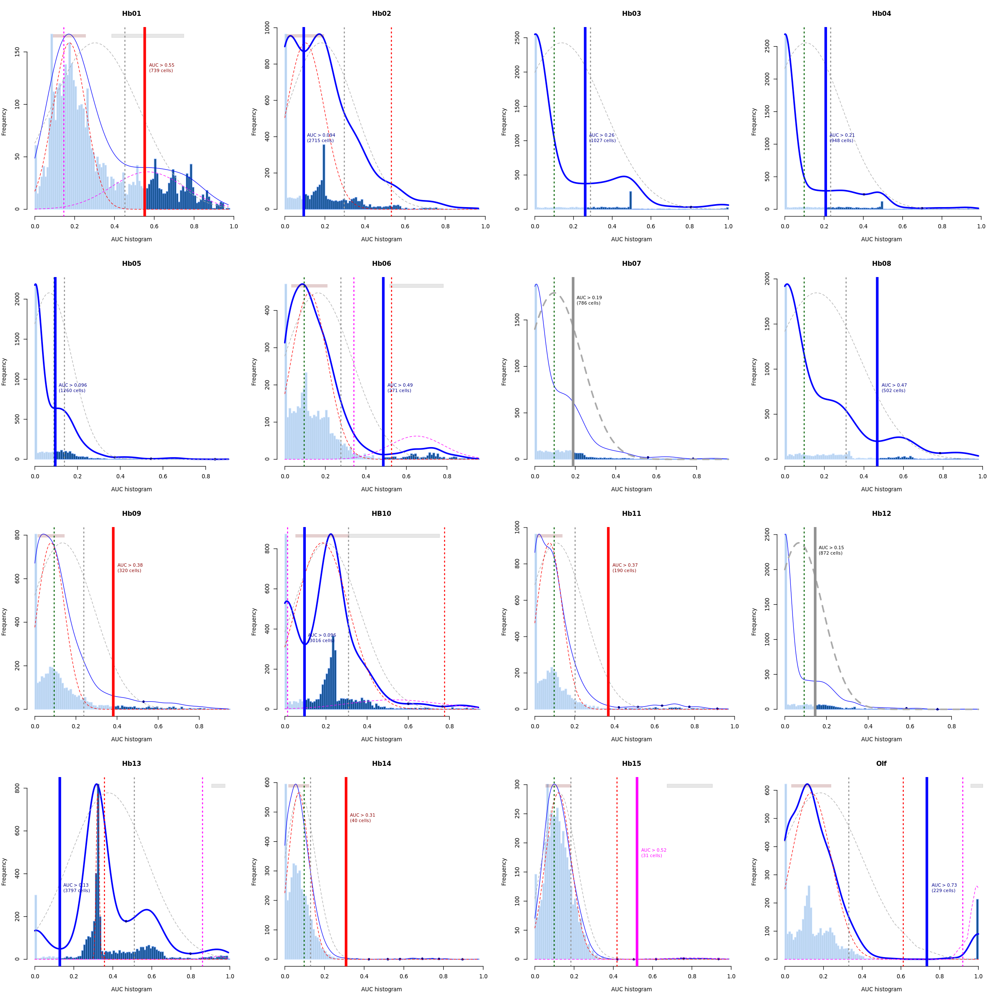

In [93]:
options(repr.plot.width = 20, repr.plot.height = 20)

set.seed(123)
layout(matrix(1:16, nrow = 4, byrow = TRUE))

cells_assignment_10X_stats <- AUCell_exploreThresholds(cell_aucs_10X, 
                                                       plotHist = TRUE, 
                                                       assign = TRUE) 

In order to better evaluate the results of `AUCell`, we introduce some selection criteria: not only we will pick the highest AUC value for each cell/each marker set, but we will also determine whether the selection is ambiguous if the highest value and the second highest value differ less than 20%. In other words, if the two best matching sets are "close enough", we label them as ambiguous. 

We will demonstrate the usefulness of this approach as follows. 

We initially only consider the best assignments, without considering whether they are ambiguous or not:

In [94]:
# All assignments
cells_assignment_10x <- as.data.frame(t(assay(cell_aucs_10X)))

# Best overall score
cells_assignment_10x$first_max_score <- apply(cells_assignment_10x, 1, max)

# Second best score
cells_assignment_10x$second_max_score <- apply(cells_assignment_10x[,1:(ncol(cells_assignment_10x) - 1)], 1, function(x) {
  return(max(x[x != max(x)]))
    })

# Ambiguous labels 
cells_assignment_10x$ambiguous <- (cells_assignment_10x$first_max_score - cells_assignment_10x$second_max_score)/(cells_assignment_10x$first_max_score + cells_assignment_10x$second_max_score) <= 0.2

cells_assignment_10x$best_label = colnames(cells_assignment_10x)[apply(cells_assignment_10x[,1:(ncol(cells_assignment_10x) - 3)], 1, which.max)]

colData(fish_10x_larv_nodbl_reduced)$labels <- cells_assignment_10x$best_label

We plot the label assignments in reduced dimensions to inspect them.

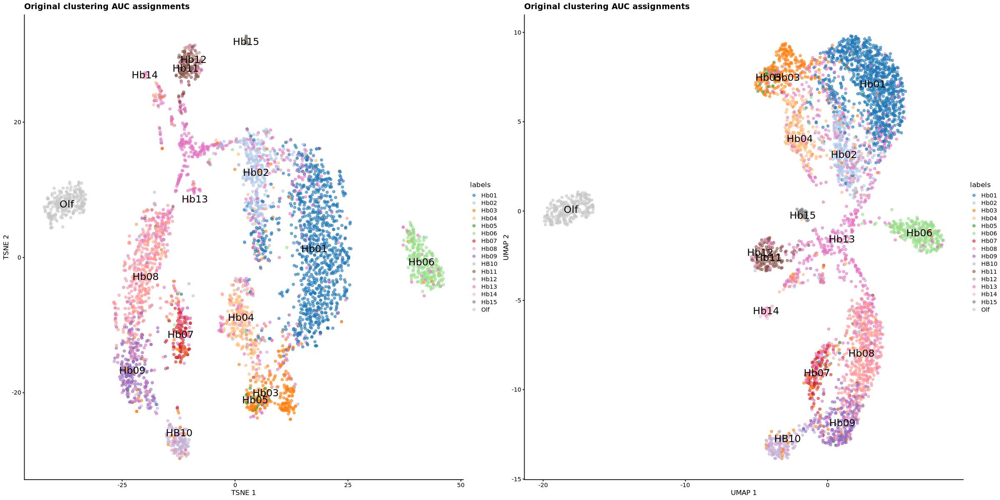

In [95]:
options(repr.plot.width = 20, repr.plot.height = 10)

gridExtra::grid.arrange(
    
    plotReducedDim(fish_10x_larv_nodbl_reduced, dimred="TSNE", colour_by = "labels", text_by = "labels") + 
    ggtitle("Original clustering AUC assignments")  + 
    scale_fill_manual(values = custom_colors$discrete),
    
    plotReducedDim(fish_10x_larv_nodbl_reduced, dimred="UMAP", colour_by = "labels", text_by = "labels") + 
    ggtitle("Original clustering AUC assignments")  + 
    scale_fill_manual(values = custom_colors$discrete),
    
    ncol = 2
    )
 

It can be easily observed that some of these assignments appear to be ambiguous; especially many cells assigned to cluster Hb13 overlap markedly with Hb02, Hb01, Hb08 and Hb04. This can be confirmed by the silhouette width calculated for these AUC-assigned labels:

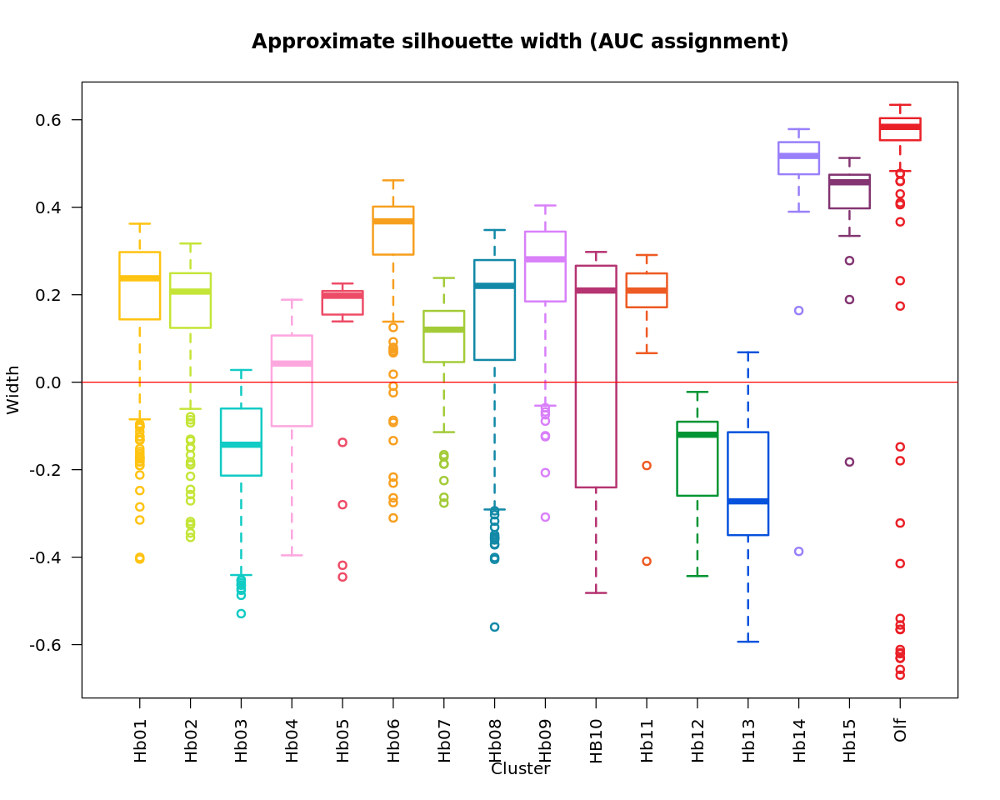

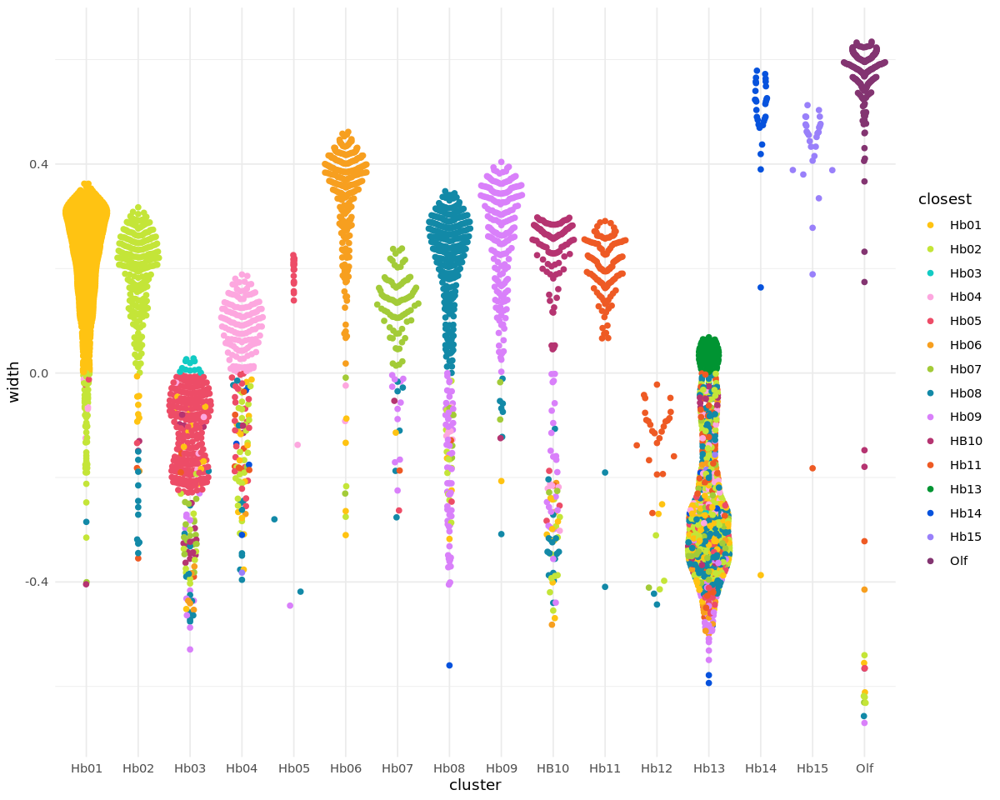

In [96]:
options(repr.plot.width = 10, repr.plot.height = 8)

silhouette_orig_10x <- as.data.frame(approxSilhouette(reducedDim(fish_10x_larv_nodbl_reduced, type = "PCA"), 
                               colData(fish_10x_larv_nodbl_reduced)$labels))

silhouette_orig_10x$cluster <-  colData(fish_10x_larv_nodbl_reduced)$labels

silhouette_orig_10x$closest <- factor(ifelse(silhouette_orig_10x$width > 0, silhouette_orig_10x$cluster, silhouette_orig_10x$other))


boxplot(silhouette_orig_10x$width ~ silhouette_orig_10x$cluster, 
        main = "Approximate silhouette width (AUC assignment)", 
        ylab = "Width", 
        xlab = "Cluster",
        border = custom_colors$discrete,
        col = NA,
        lwd = 2,
        las = 2)

abline(h = 0, col = 'red')

ggplot(silhouette_orig_10x, aes(x=cluster, y=width, colour=closest)) + 
    ggbeeswarm::geom_quasirandom(method="smiley")  + 
scale_colour_manual(values = custom_colors$discrete) +
theme_minimal()


Indeed, Hb03 and Hb13 show a mostly negative silhouette score, suggesting that in our reduced space most of the cells labelled by `AUCell` as either cluster seem to lie amongst cells with other, better defined labels.

We can also compare this labelling with how our clustering results using the pairwise Jaccard matrix as before:

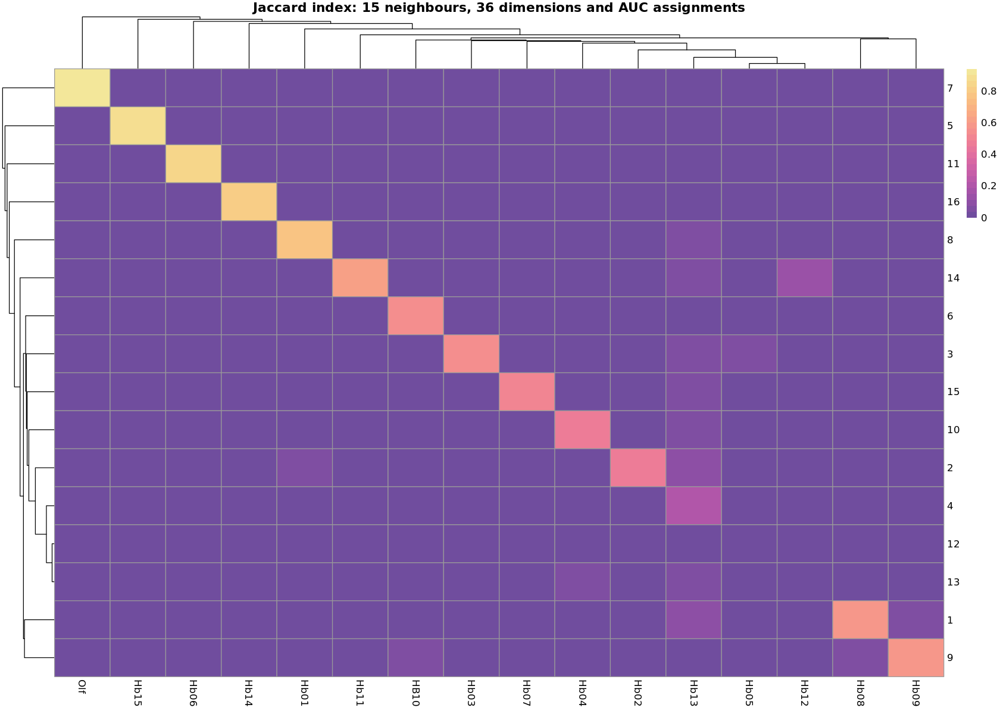

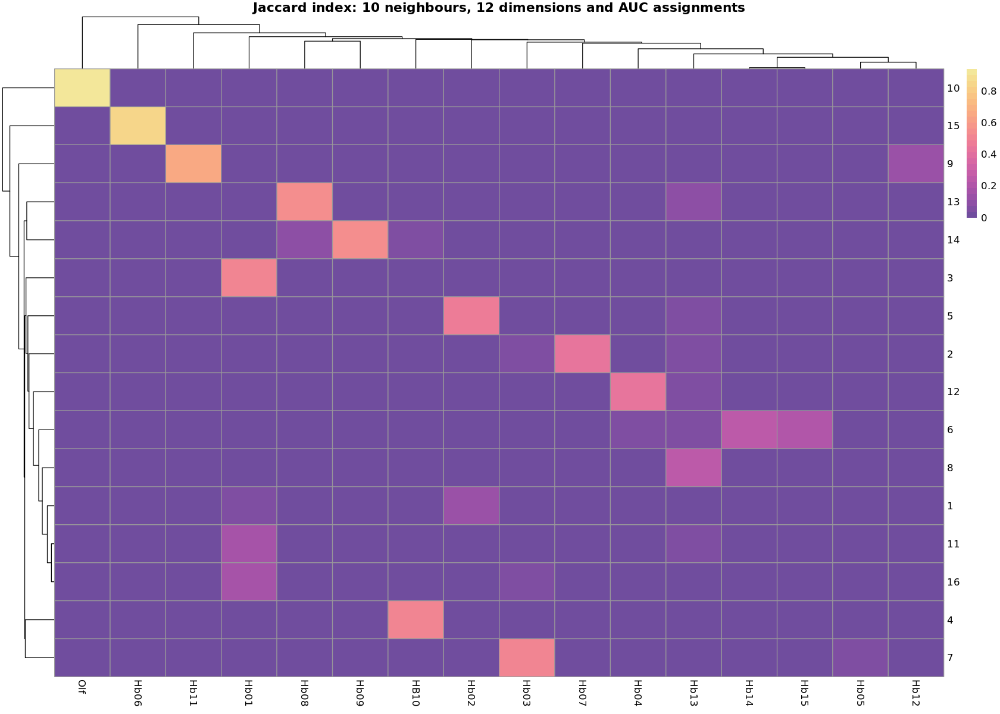

In [97]:
options(repr.plot.width = 14, repr.plot.height = 10)

intersections <- as.matrix(table(colData(fish_10x_larv_nodbl_reduced)$clusters_36, 
                              colData(fish_10x_larv_nodbl_reduced)$labels))

unions <- matrix(rowSums(expand.grid(rowSums(intersections), 
                                     colSums(intersections))), 
                 nrow = nrow(intersections), byrow = FALSE) - intersections

jacmat_10x_36 <- intersections/unions

intersections <- as.matrix(table(colData(fish_10x_larv_nodbl_reduced)$clusters_12, 
                              colData(fish_10x_larv_nodbl_reduced)$labels))

unions <- matrix(rowSums(expand.grid(rowSums(intersections), 
                                     colSums(intersections))), 
                 nrow = nrow(intersections), byrow = FALSE) - intersections

jacmat_10x_12 <- intersections/unions


pheatmap(jacmat_10x_36, 
        cluster_cols = TRUE, 
        cluster_rows = TRUE,
        col = colorspace::sequential_hcl("Sunset", n = 25),
        main = "Jaccard index: 15 neighbours, 36 dimensions and AUC assignments")


pheatmap(jacmat_10x_12, 
        cluster_cols = TRUE, 
        cluster_rows = TRUE,
        col = colorspace::sequential_hcl("Sunset", n = 25),
        main = "Jaccard index: 10 neighbours, 12 dimensions and AUC assignments")

While our 15-neighbour/36-dimension clustering would appear to better agree with the labelling, we can make a clearer comparison by calculating the per-cluster maximum Jaccard score and taking the median maximum score. Higher numbers should indicate a better overlap of our clustering with the labels.

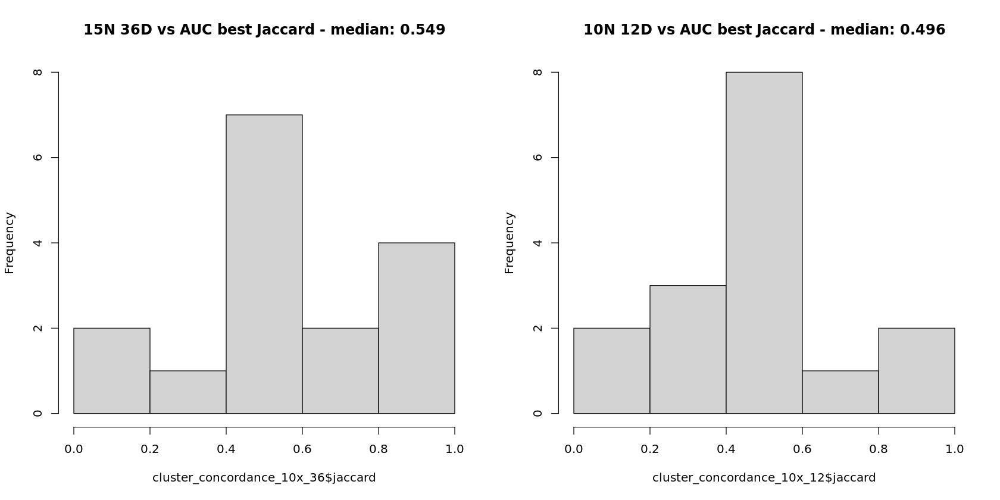

In [98]:
options(repr.plot.width = 14, repr.plot.height = 7)

cluster_concordance_10x_36 <- as.data.frame(cbind(colnames(jacmat_10x_36), 
                                                 rownames(jacmat_10x_36)[apply(jacmat_10x_36, 2, which.max)], 
                                                 apply(jacmat_10x_36, 2, max)))

colnames(cluster_concordance_10x_36) <- c("cluster", "original_label", "jaccard")
cluster_concordance_10x_36$jaccard <- as.numeric(cluster_concordance_10x_36$jaccard)

cluster_concordance_10x_12 <- as.data.frame(cbind(colnames(jacmat_10x_12), 
                                                  rownames(jacmat_10x_12)[apply(jacmat_10x_12, 2, which.max)], 
                                                  apply(jacmat_10x_12, 2, max)))

colnames(cluster_concordance_10x_12) <- c("cluster", "original_label", "jaccard")
cluster_concordance_10x_12$jaccard <- as.numeric(cluster_concordance_10x_12$jaccard)


layout(matrix(1:2, nrow = 1))

hist(cluster_concordance_10x_36$jaccard, main = paste0('15N 36D vs AUC best Jaccard - median: ', round(median(cluster_concordance_10x_36$jaccard), digits = 3)), ylim = c(0,8))

hist(cluster_concordance_10x_12$jaccard, main = paste0('10N 12D vs AUC best Jaccard - median: ', round(median(cluster_concordance_10x_12$jaccard), digits = 3)),  ylim = c(0,8))


Clustering with 15 neighbours in 36 dimensions (15N 36D) seems to agree more with the labels imputed by `AUCell`. However, we can increase this agreement by considering ambiguous labels using the criteria outlined earlier. 

We reassign all cells with an "ambiguous" flag as "ND" (not defined), and we look at how the ND label is spread through the dataset:

In [99]:
table(cells_assignment_10x$best_label, cells_assignment_10x$ambiguous)

cells_assignment_10x$best_label_nd <- cells_assignment_10x$best_label
cells_assignment_10x$best_label_nd[cells_assignment_10x$ambiguous] <- "ND"

colData(fish_10x_larv_nodbl_reduced)$labels <- cells_assignment_10x$best_label
colData(fish_10x_larv_nodbl_reduced)$labels_nd <- cells_assignment_10x$best_label_nd
colData(fish_10x_larv_nodbl_reduced)$ambiguous <- cells_assignment_10x$ambiguous

      
       FALSE TRUE
  Hb01   594  382
  Hb02   113  164
  Hb03   132  183
  Hb04   100  125
  Hb05     3   20
  Hb06   174   89
  Hb07    49   54
  Hb08   227  184
  Hb09    75  137
  HB10    52  136
  Hb11    67   55
  Hb12     5   27
  Hb13   288  467
  Hb14    16   14
  Hb15    23    5
  Olf    224   20

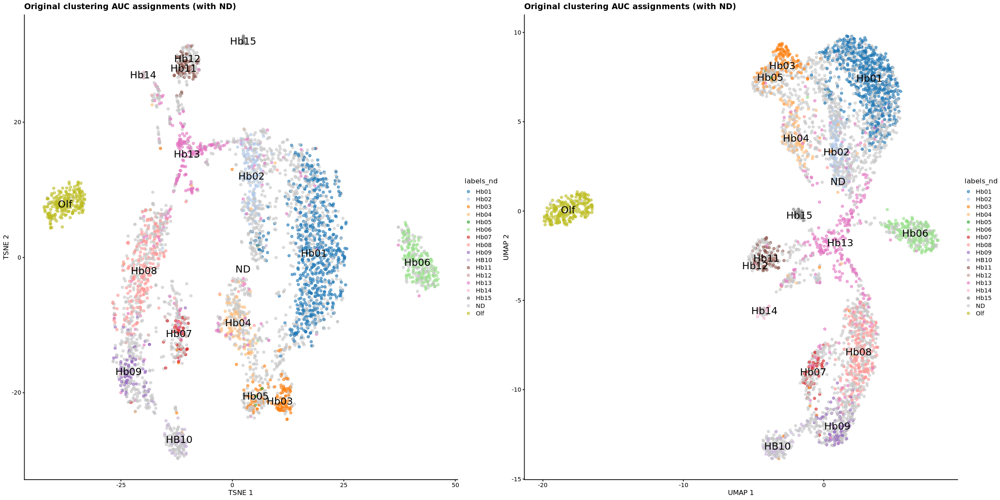

In [100]:
options(repr.plot.width = 20, repr.plot.height = 10)

gridExtra::grid.arrange(
    
    plotReducedDim(fish_10x_larv_nodbl_reduced, dimred="TSNE", colour_by = "labels_nd", text_by = "labels_nd") + 
    ggtitle("Original clustering AUC assignments (with ND)")  + 
    scale_fill_manual(values = custom_colors$discrete),
    
    plotReducedDim(fish_10x_larv_nodbl_reduced, dimred="UMAP", colour_by = "labels_nd", text_by = "labels_nd") + 
    ggtitle("Original clustering AUC assignments (with ND)")  + 
    scale_fill_manual(values = custom_colors$discrete),
    
    ncol = 2
    )

A large number of cells, mostly (but not exclusively) lying on boundary regions, appears to be undetermined. We can see that this is confirmed by a completely negative distribution of silhouette widths:

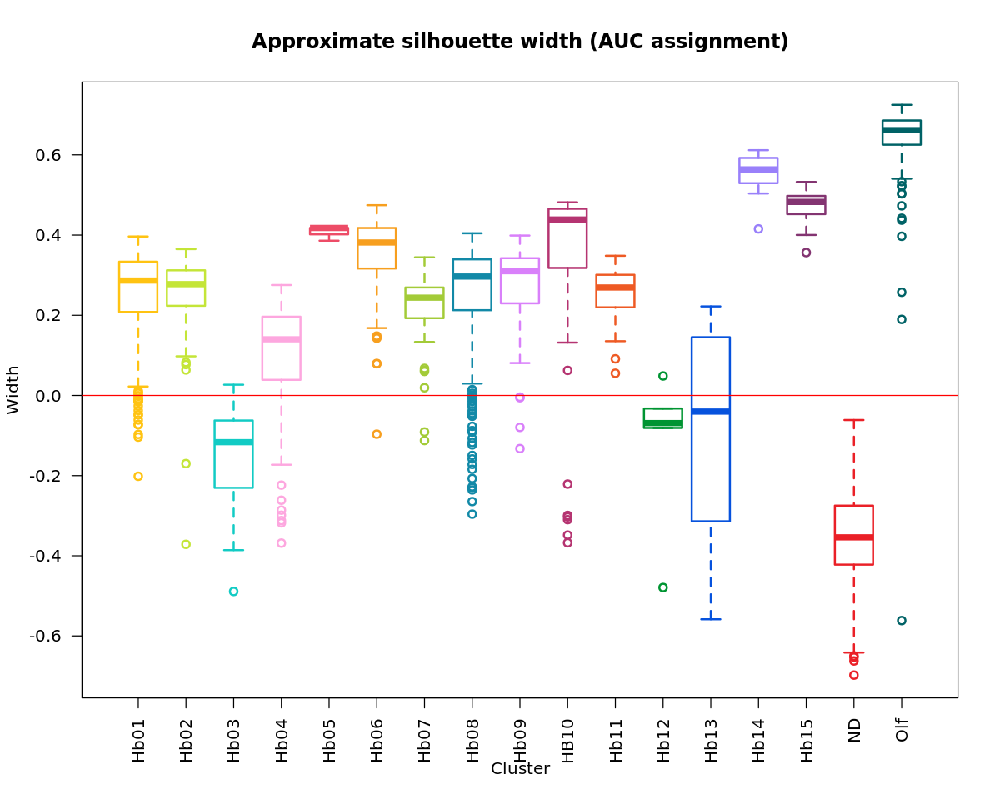

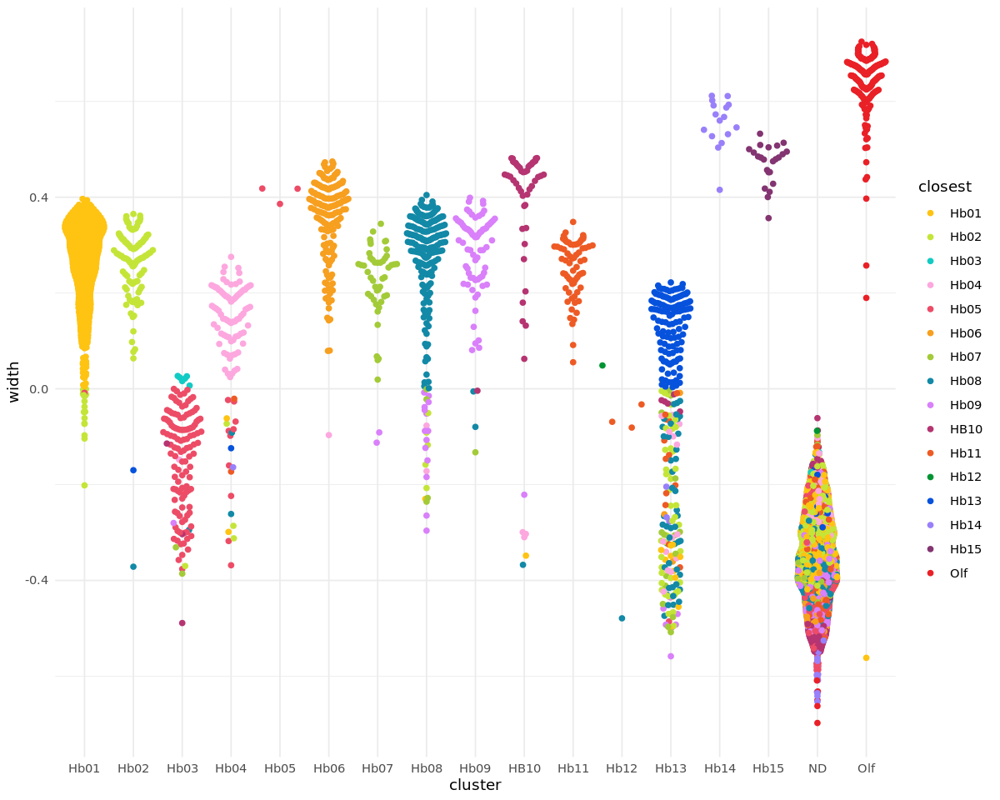

In [101]:
options(repr.plot.width = 10, repr.plot.height = 8)

silhouette_orig_10x <- as.data.frame(approxSilhouette(reducedDim(fish_10x_larv_nodbl_reduced, type = "PCA"), 
                               colData(fish_10x_larv_nodbl_reduced)$labels_nd))

silhouette_orig_10x$cluster <-  colData(fish_10x_larv_nodbl_reduced)$labels_nd

silhouette_orig_10x$closest <- factor(ifelse(silhouette_orig_10x$width > 0, silhouette_orig_10x$cluster, silhouette_orig_10x$other))


boxplot(silhouette_orig_10x$width ~ silhouette_orig_10x$cluster, 
        main = "Approximate silhouette width (AUC assignment)", 
        ylab = "Width", 
        xlab = "Cluster",
        border = custom_colors$discrete,
        col = NA,
        lwd = 2,
        las = 2)

abline(h = 0, col = 'red')

ggplot(silhouette_orig_10x, aes(x=cluster, y=width, colour=closest)) + 
    ggbeeswarm::geom_quasirandom(method="smiley")  + 
scale_colour_manual(values = custom_colors$discrete) +
theme_minimal()


All ambiguous identities have a negative silhouette width. This is somewhat expected, but we can explore the relationship further.
As an example we can plot the AUC values for Hb13 against their silhouette width, and calculate with Fisher's exact test the significante of the association between ambiguity and negativity of the silhouette:

           is_ambiguous
is_positive FALSE TRUE
      FALSE   159  467
      TRUE    129    0


	Fisher's Exact Test for Count Data

data:  table(is_positive, is_ambiguous)
p-value < 2.2e-16
alternative hypothesis: true odds ratio is not equal to 1
95 percent confidence interval:
 0.00000000 0.01012186
sample estimates:
odds ratio 
         0 


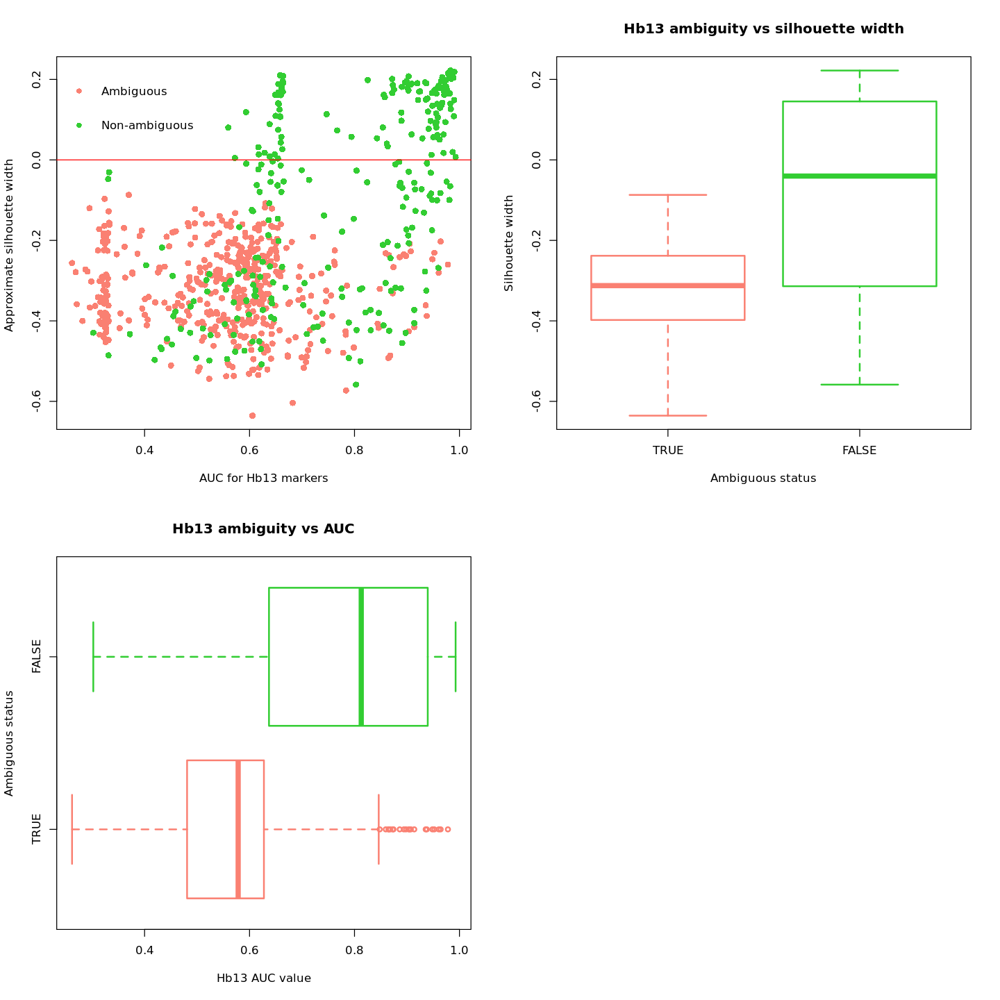

In [102]:
options(repr.plot.width = 12, repr.plot.height = 12)


silhouette_with_AUC <- cbind(silhouette_orig_10x, cells_assignment_10x)

layout(matrix(1:4, nrow = 2, byrow = TRUE))
plot(silhouette_with_AUC[silhouette_with_AUC$best_label == "Hb13", c("Hb13", "width")], pch = 16, cex = 0, xlab = "AUC for Hb13 markers", ylab = "Approximate silhouette width ")
points(silhouette_with_AUC[silhouette_with_AUC$best_label == "Hb13" & silhouette_with_AUC$ambiguous == TRUE, c("Hb13", "width")], col = 'salmon', cex = 1.2, pch = 16)
points(silhouette_with_AUC[silhouette_with_AUC$best_label == "Hb13" & silhouette_with_AUC$ambiguous == FALSE, c("Hb13", "width")], col = 'limegreen', cex = 1.2, pch = 16)
abline(h = 0, col = 'red')
legend("topleft", pch = 16, col = c('salmon', "limegreen"), legend = c("Ambiguous", "Non-ambiguous"), bty = 'n')


ambig_hb13 <- silhouette_with_AUC[silhouette_with_AUC$best_label == "Hb13", c("width", "Hb13", "ambiguous")]
boxplot(ambig_hb13$width ~ factor(ambig_hb13$ambiguous, levels = c(TRUE, FALSE)), 
        border = c('salmon', "limegreen"), 
        col = "NA", 
        lwd = 2, 
        xlab = "Ambiguous status",
        ylab = "Silhouette width",
        main = "Hb13 ambiguity vs silhouette width",
        horizontal = FALSE)


boxplot(ambig_hb13$Hb13 ~ factor(ambig_hb13$ambiguous, levels = c(TRUE, FALSE)), 
        border = c('salmon', "limegreen"), 
        col = "NA", 
        lwd = 2,
        xlab = "Hb13 AUC value",
        ylab = "Ambiguous status",
        main = "Hb13 ambiguity vs AUC",
        horizontal = TRUE)


is_positive <- silhouette_with_AUC[silhouette_with_AUC$best_label == "Hb13", "width"] > 0
is_ambiguous <- silhouette_with_AUC[silhouette_with_AUC$best_label == "Hb13", "ambiguous"]
table(is_positive, is_ambiguous)

fisher.test(table(is_positive, is_ambiguous))


Actually the test was not needed, as we have no ambiguous cell with a positive silhouette width.

We can also see how ND cells have low but widespread Jaccard indices, meaning that they are mostly overlapping with all clusters from our own clustering attempt:

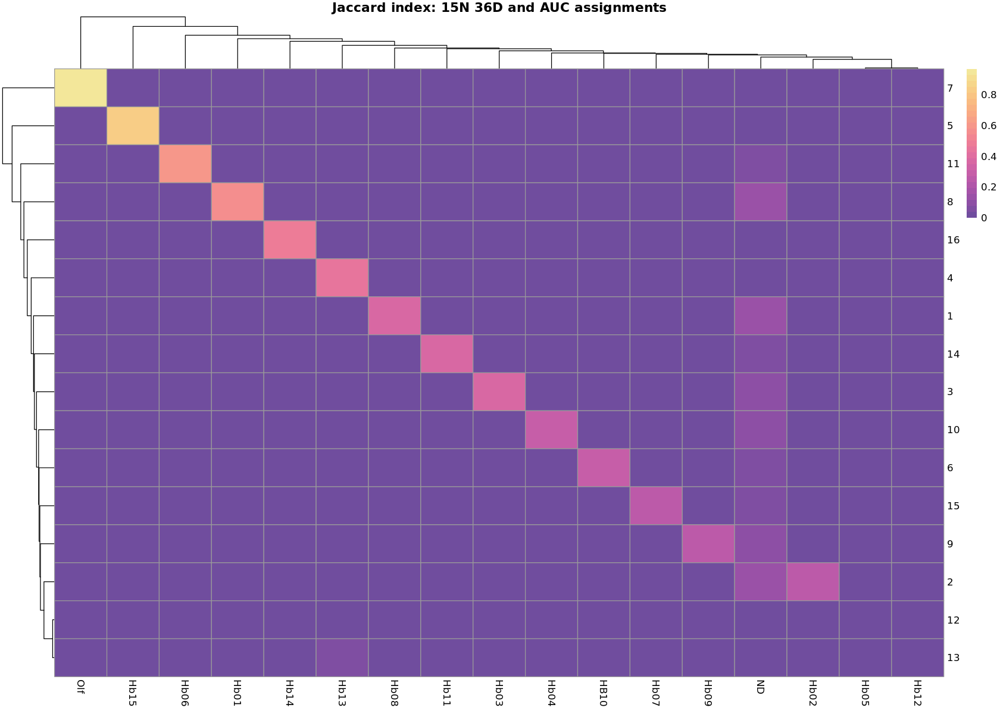

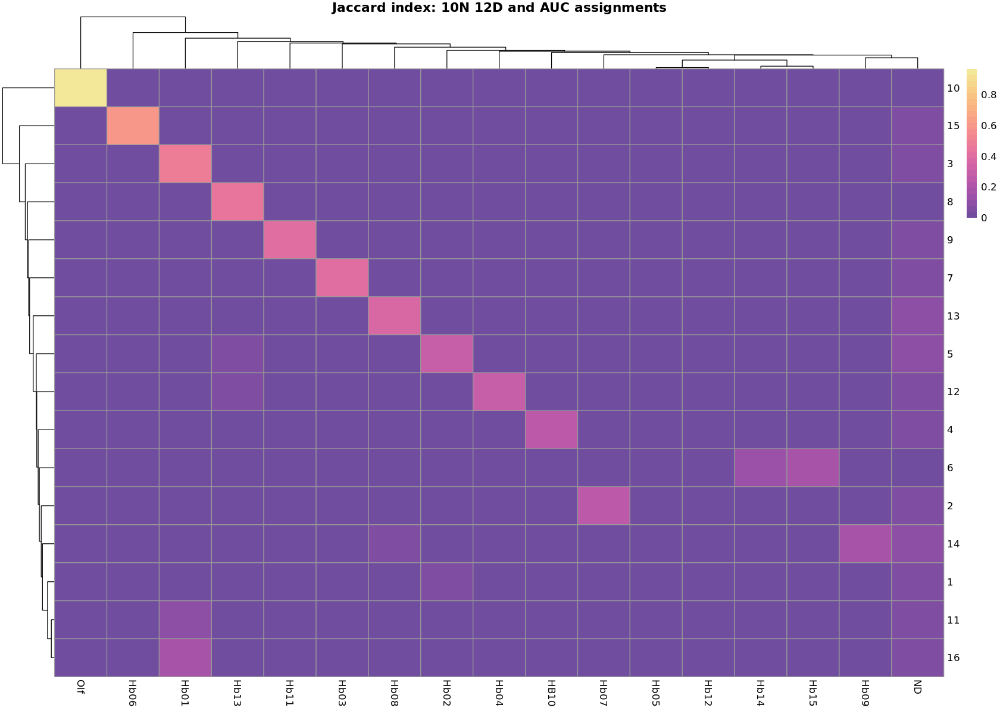

In [103]:
options(repr.plot.width = 14, repr.plot.height = 10)

intersections <- as.matrix(table(colData(fish_10x_larv_nodbl_reduced)$clusters_36, 
                              colData(fish_10x_larv_nodbl_reduced)$labels_nd))

unions <- matrix(rowSums(expand.grid(rowSums(intersections), 
                                     colSums(intersections))), 
                 nrow = nrow(intersections), byrow = FALSE) - intersections

jacmat_10x_36 <- intersections/unions



intersections <- as.matrix(table(colData(fish_10x_larv_nodbl_reduced)$clusters_12, 
                              colData(fish_10x_larv_nodbl_reduced)$labels_nd))

unions <- matrix(rowSums(expand.grid(rowSums(intersections), 
                                     colSums(intersections))), 
                 nrow = nrow(intersections), byrow = FALSE) - intersections

jacmat_10x_12 <- intersections/unions


pheatmap(jacmat_10x_36, 
        cluster_cols = TRUE, 
        cluster_rows = TRUE,
        col = colorspace::sequential_hcl("Sunset", n = 25),
        main = "Jaccard index: 15N 36D and AUC assignments")


pheatmap(jacmat_10x_12, 
        cluster_cols = TRUE, 
        cluster_rows = TRUE,
        col = colorspace::sequential_hcl("Sunset", n = 25),
        main = "Jaccard index: 10N 12D and AUC assignments")

However, having calculated the approximate silhouette width, we also know which is the closest centroid for each of these ND cells. In other words, we can reassign all of the ND cells to the best matching cluster based on silhouette width:

In [104]:
fish_10x_larv_nodbl_reduced_reassigned <- fish_10x_larv_nodbl_reduced

colData(fish_10x_larv_nodbl_reduced_reassigned)[rownames(silhouette_orig_10x[silhouette_orig_10x$cluster == "ND",]), "labels"] <- as.character(silhouette_orig_10x[silhouette_orig_10x$cluster == "ND", "closest"])

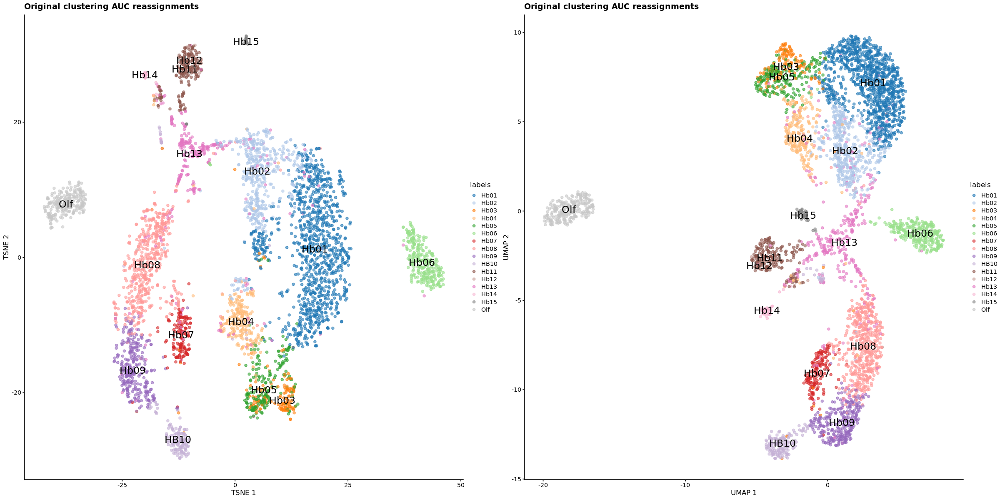

In [105]:
options(repr.plot.width = 20, repr.plot.height = 10)

gridExtra::grid.arrange(
    
    plotReducedDim(fish_10x_larv_nodbl_reduced_reassigned, dimred = "TSNE", colour_by = "labels", text_by = "labels") + 
    ggtitle("Original clustering AUC reassignments")  + 
    scale_fill_manual(values = custom_colors$discrete),
    
    plotReducedDim(fish_10x_larv_nodbl_reduced_reassigned, dimred = "UMAP", colour_by = "labels", text_by = "labels") + 
    ggtitle("Original clustering AUC reassignments")  + 
    scale_fill_manual(values = custom_colors$discrete),
    
    ncol = 2
    )

In [106]:
pdf(file = "10X_larva_expression_tSNE.pdf", width = 10, height = 10, useDingbats = FALSE)

plotReducedDim(fish_10x_larv_nodbl_reduced_reassigned, dimred="TSNE", colour_by = "labels", text_by = "labels") + 
    ggtitle("Original clustering AUC assignments")  + 
    scale_fill_manual(values = custom_colors$discrete)
dev.off()

png 
  2

While this doesn't completely solve the issue, it shows some improvement in retrieving more cells for original cluster labels that were not initially well determined (e.g. Hb12, Hb05). The silhouette widths for borderline cells slightly increase.

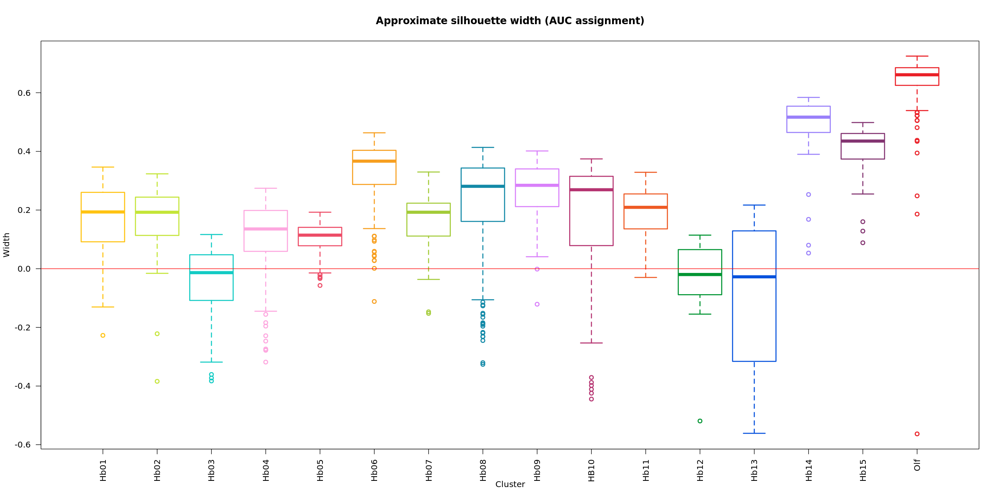

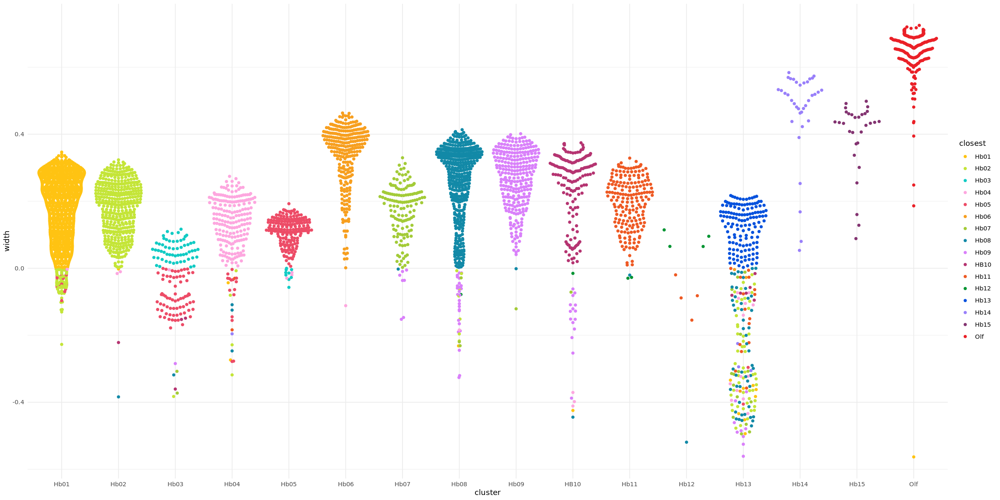

In [107]:
silhouette_orig_10x_reassigned <- as.data.frame(approxSilhouette(reducedDim(fish_10x_larv_nodbl_reduced_reassigned, type = "PCA"), 
                               colData(fish_10x_larv_nodbl_reduced_reassigned)$labels))

silhouette_orig_10x_reassigned$cluster <-  colData(fish_10x_larv_nodbl_reduced_reassigned)$labels

silhouette_orig_10x_reassigned$closest <- factor(ifelse(silhouette_orig_10x_reassigned$width > 0, silhouette_orig_10x_reassigned$cluster, silhouette_orig_10x_reassigned$other))


boxplot(silhouette_orig_10x_reassigned$width ~ silhouette_orig_10x_reassigned$cluster, 
        main = "Approximate silhouette width (AUC assignment)", 
        ylab = "Width", 
        xlab = "Cluster",
        border = custom_colors$discrete,
        col = NA,
        lwd = 2,
        las = 2)

abline(h = 0, col = 'red')

ggplot(silhouette_orig_10x_reassigned, aes(x = cluster, y = width, colour = closest)) + 
    ggbeeswarm::geom_quasirandom(method="smiley")  + 
scale_colour_manual(values = custom_colors$discrete) +
theme_minimal()

And, again expectedly, since we are making the AUC labels conform more to our reduced space (which is the same in which clustering was performed), Jaccard scores increase:

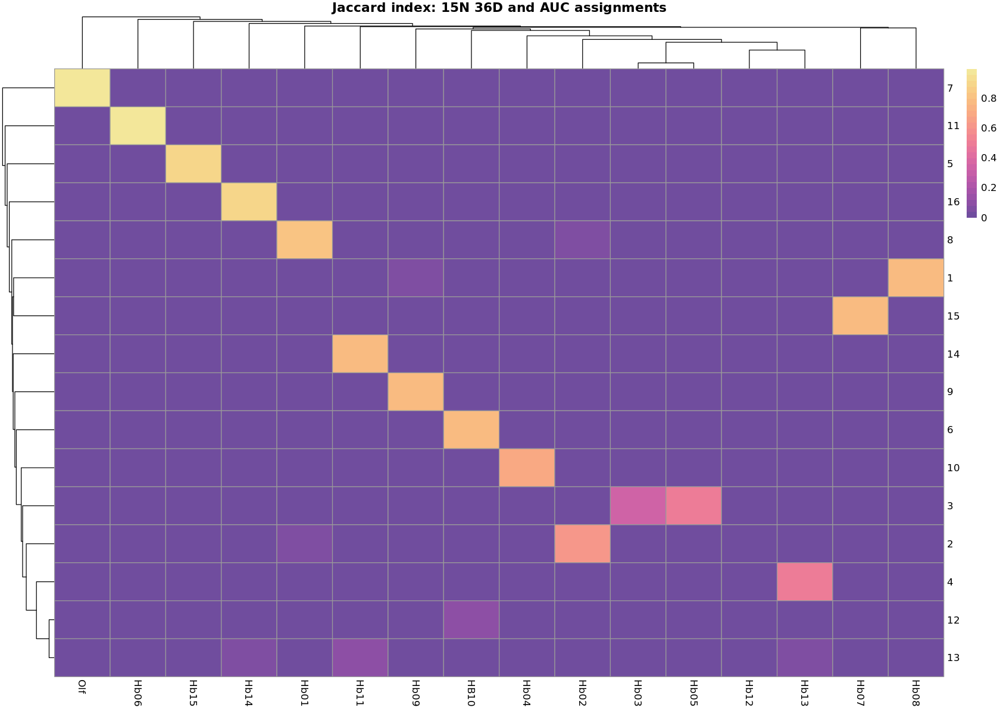

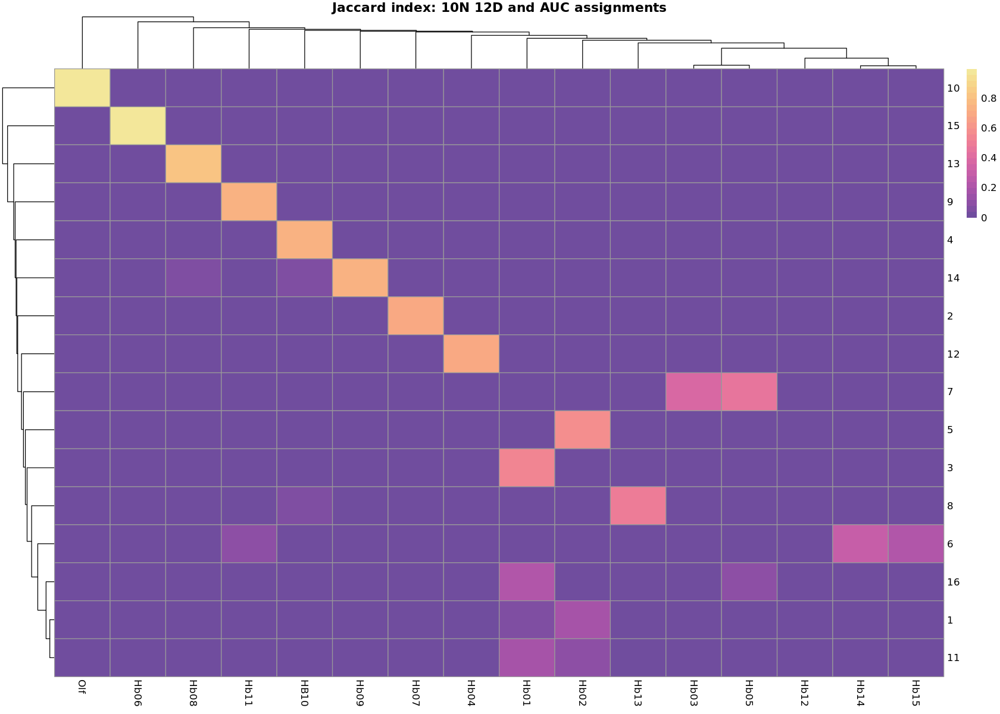

In [108]:
options(repr.plot.width = 14, repr.plot.height = 10)

intersections <- as.matrix(table(colData(fish_10x_larv_nodbl_reduced_reassigned)$clusters_36, 
                              colData(fish_10x_larv_nodbl_reduced_reassigned)$labels))

unions <- matrix(rowSums(expand.grid(rowSums(intersections), 
                                     colSums(intersections))), 
                 nrow = nrow(intersections), byrow = FALSE) - intersections

jacmat_10x_36 <- intersections/unions



intersections <- as.matrix(table(colData(fish_10x_larv_nodbl_reduced_reassigned)$clusters_12, 
                              colData(fish_10x_larv_nodbl_reduced_reassigned)$labels))

unions <- matrix(rowSums(expand.grid(rowSums(intersections), 
                                     colSums(intersections))), 
                 nrow = nrow(intersections), byrow = FALSE) - intersections

jacmat_10x_12 <- intersections/unions


pheatmap(jacmat_10x_36, 
        cluster_cols = TRUE, 
        cluster_rows = TRUE,
        col = colorspace::sequential_hcl("Sunset", n = 25),
        main = "Jaccard index: 15N 36D and AUC assignments")


pheatmap(jacmat_10x_12, 
        cluster_cols = TRUE, 
        cluster_rows = TRUE,
        col = colorspace::sequential_hcl("Sunset", n = 25),
        main = "Jaccard index: 10N 12D and AUC assignments")

In [109]:
cluster_concordance_10x_36 <- as.data.frame(cbind(colnames(jacmat_10x_36), 
                                                 rownames(jacmat_10x_36)[apply(jacmat_10x_36, 2, which.max)], 
                                                 apply(jacmat_10x_36, 2, max)))

colnames(cluster_concordance_10x_36) <- c("cluster", "original_label", "jaccard")
cluster_concordance_10x_36$jaccard <- as.numeric(cluster_concordance_10x_36$jaccard)

cluster_concordance_10x_12 <- as.data.frame(cbind(colnames(jacmat_10x_12), 
                                                  rownames(jacmat_10x_12)[apply(jacmat_10x_12, 2, which.max)], 
                                                  apply(jacmat_10x_12, 2, max)))

colnames(cluster_concordance_10x_12) <- c("cluster", "original_label", "jaccard")
cluster_concordance_10x_12$jaccard <- as.numeric(cluster_concordance_10x_12$jaccard)

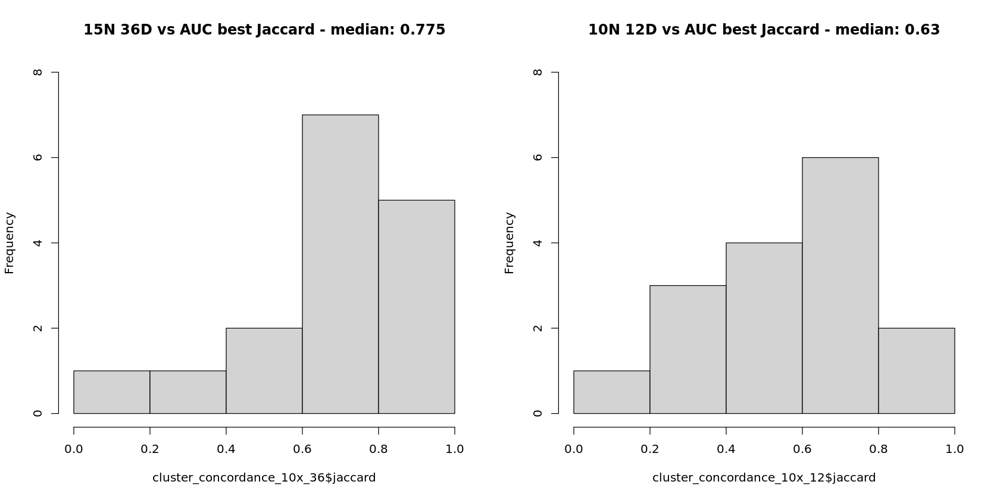

In [110]:
options(repr.plot.width = 14, repr.plot.height = 7)

layout(matrix(1:2, nrow = 1))

hist(cluster_concordance_10x_36$jaccard, main = paste0('15N 36D vs AUC best Jaccard - median: ', round(median(cluster_concordance_10x_36$jaccard), digits = 3)), ylim = c(0,8))
hist(cluster_concordance_10x_12$jaccard, main = paste0('10N 12D vs AUC best Jaccard - median: ', round(median(cluster_concordance_10x_12$jaccard), digits = 3)), ylim = c(0,8))

Several improvements could be made by tweaking the clustering parameters, AUCell performance and changing the ambiguity criteria.

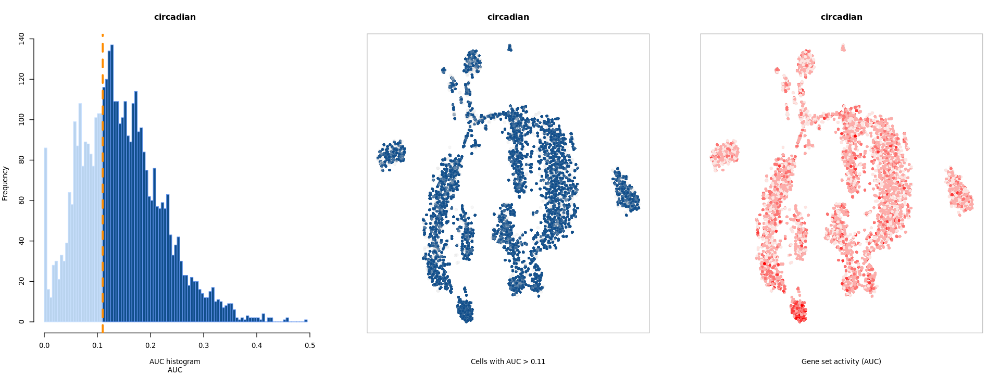

In [111]:
options(repr.plot.width = 16, repr.plot.height = 6)


cell_aucs_circ_10X <- AUCell_calcAUC(circ_geneset, 
                                  rankings_10X, 
                                     aucMaxRank = ceiling(0.2 * nrow(rankings_10X)))

results_circ <- t(assay(cell_aucs_circ_10X ))

layout(matrix(1:3, nrow = 1))
AUCell_plotTSNE(tSNE = reducedDim(fish_10x_larv_nodbl_reduced_reassigned, type = "TSNE"), 
                exprMat = assay(fish_10x_larv_nodbl_reduced_reassigned, "logcounts"), 
                cellsAUC = cell_aucs_circ_10X, thresholds = 0.11) 


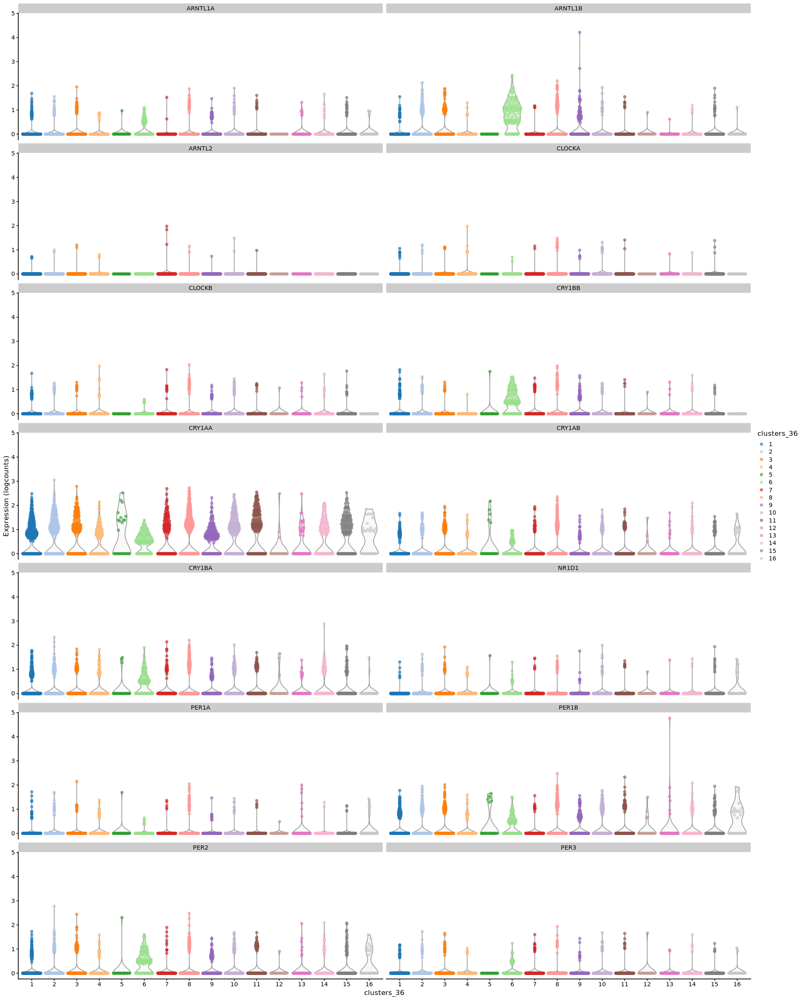

In [112]:
options(repr.plot.width = 16, repr.plot.height = 20)
scater::plotExpression(fish_10x_larv_nodbl_reduced_reassigned, circ_genes, x = "clusters_36", colour_by = "clusters_36") +
scale_fill_manual(values = custom_colors$discrete)

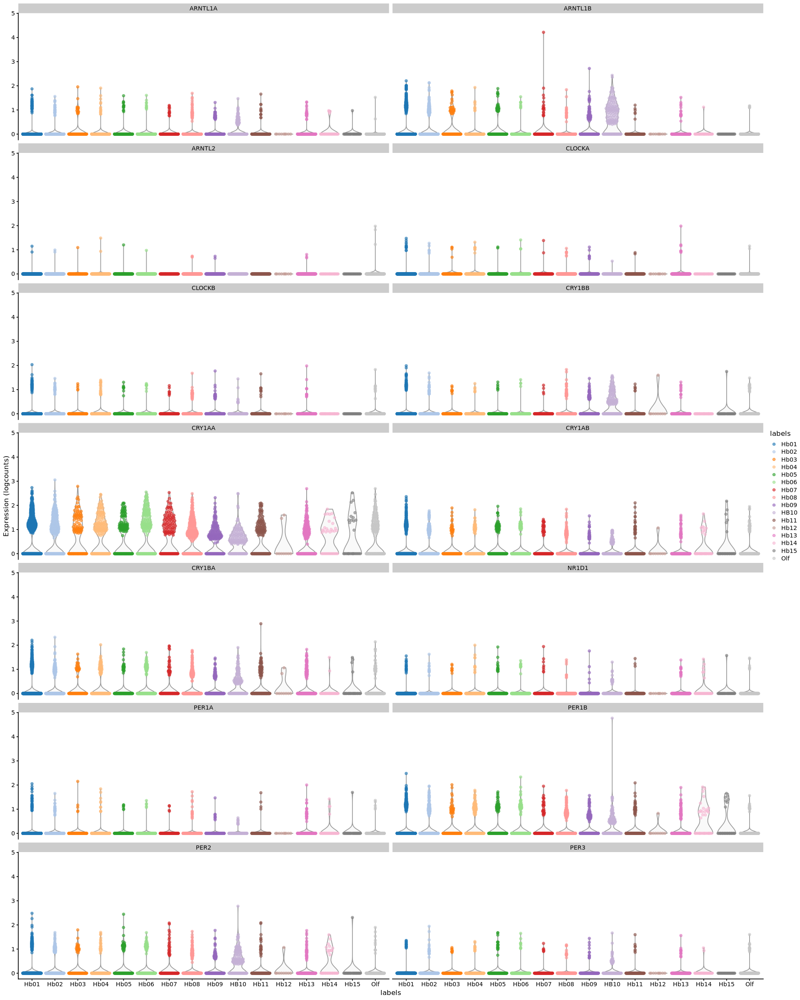

In [113]:
options(repr.plot.width = 16, repr.plot.height = 20)

scater::plotExpression(fish_10x_larv_nodbl_reduced_reassigned, circ_genes, x = "labels", colour_by = "labels") +
scale_fill_manual(values = custom_colors$discrete)


In [114]:
options(repr.plot.width = 16, repr.plot.height = 10)

circ_list_auc <- lapply(unique(colData(fish_10x_larv_nodbl_reduced_reassigned)$clusters_36), function(x) {
    
    pick_cells <- which(colData(fish_10x_larv_nodbl_reduced_reassigned)$clusters_36 == x)
    pick_expr <- assay(fish_10x_larv_nodbl_reduced_reassigned, "logcounts")[circ_genes,pick_cells]
    rwm <- rowMeans(pick_expr)
    rwp <- as.numeric(apply(pick_expr, 1, function(x) sum(x > 0)))/length(pick_cells) * 100
    rdf <- as.data.frame(cbind(as.numeric(rwm), as.numeric(rwp), rep(x, length(circ_genes)), circ_genes))
    return(rdf)
})
                      
circ_df_auc <- do.call(rbind, circ_list_auc)
colnames(circ_df_auc) <- c("rwm", "rwp", "cluster", "gene")                    

circ_df_auc$rwm <- as.numeric(circ_df_auc$rwm)
circ_df_auc$rwp <- as.numeric(circ_df_auc$rwp)
circ_df_auc$prod <- circ_df$rwm * log10(circ_df_auc$rwm + 1)

gene_order <-  hclust(dist(matrix(circ_df_auc$prod, nrow = length(circ_genes))))$order
cluster_order <- hclust(dist(t(matrix(circ_df_auc$prod, nrow = length(circ_genes)))))$order

circ_df_auc$gene <- factor(tolower(circ_df_auc$gene), levels = tolower(circ_df_auc$gene)[gene_order])
circ_df_auc$cluster <- factor(circ_df_auc$cluster, levels = unique(circ_df_auc$cluster)[cluster_order])

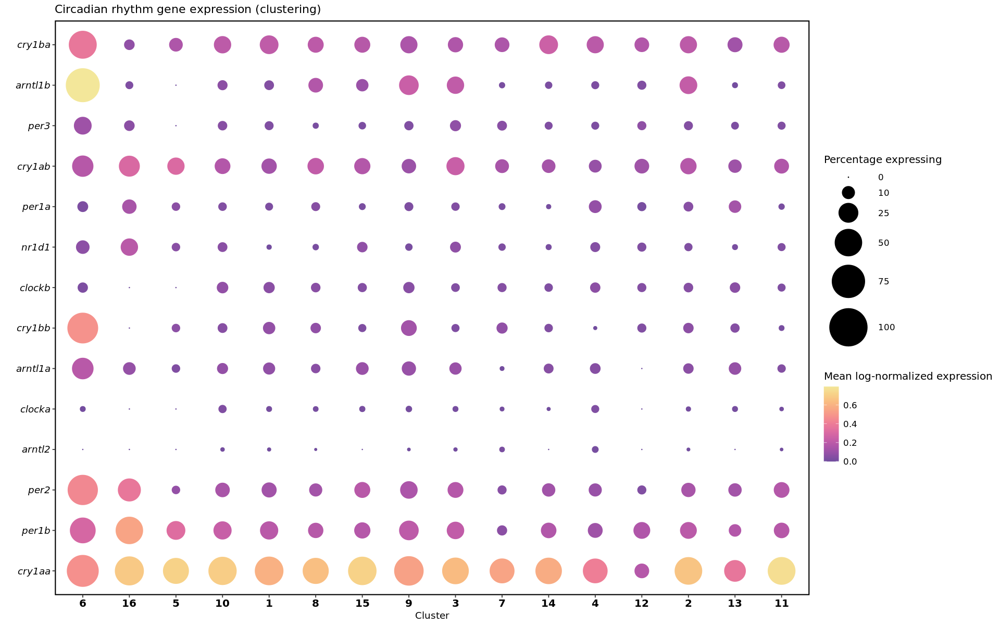

In [115]:
ggplot(circ_df_auc, aes(col = rwm, size = rwp, x = cluster, y = gene)) + 
geom_point() +
scale_size_continuous(limits = c(0,100), range = c(0.1,20), breaks = c(0, 10, 25, 50, 75, 100)) +
scale_colour_continuous_sequential(palette = "Sunset", rev = FALSE) +
labs(x = "Cluster", y = "", size = "Percentage expressing", colour = "Mean log-normalized expression") +
theme(legend.key=element_blank(), 
  axis.text.x = element_text(colour = "black", size = 12, face = "bold"), 
  axis.text.y = element_text(colour = "black", face = "italic", size = 11), 
  legend.text = element_text(size = 10, colour ="black"), 
  legend.title = element_text(size = 12), 
  panel.background = element_blank(), panel.border = element_rect(colour = "black", fill = NA, size = 1.2), 
  legend.position = "right") +
ggtitle("Circadian rhythm gene expression (clustering)")

In [116]:
circ_list_auc <- lapply(unique(colData(fish_10x_larv_nodbl_reduced_reassigned)$labels), function(x) {
    
    pick_cells <- which(colData(fish_10x_larv_nodbl_reduced_reassigned)$labels == x)
    pick_expr <- assay(fish_10x_larv_nodbl_reduced_reassigned, "logcounts")[circ_genes,pick_cells]
    rwm <- rowMeans(pick_expr)
    rwp <- as.numeric(apply(pick_expr, 1, function(x) sum(x > 0)))/length(pick_cells) * 100
    rdf <- as.data.frame(cbind(as.numeric(rwm), as.numeric(rwp), rep(x, length(circ_genes)), circ_genes))
    return(rdf)
})
                      
circ_df_auc <- do.call(rbind, circ_list_auc)
colnames(circ_df_auc) <- c("rwm", "rwp", "cluster", "gene")                    

circ_df_auc$rwm <- as.numeric(circ_df_auc$rwm)
circ_df_auc$rwp <- as.numeric(circ_df_auc$rwp)
circ_df_auc$prod <- circ_df$rwm * log10(circ_df_auc$rwm + 1)

gene_order <-  hclust(dist(matrix(circ_df_auc$prod, nrow = length(circ_genes))), method = "ward.D2")$order
cluster_order <- hclust(dist(t(matrix(circ_df_auc$prod, nrow = length(circ_genes)))))$order

circ_df_auc$gene <- factor(tolower(circ_df_auc$gene), levels = tolower(circ_df_auc$gene)[gene_order])
circ_df_auc$cluster <- factor(circ_df_auc$cluster, levels = unique(circ_df_auc$cluster)[cluster_order])
       

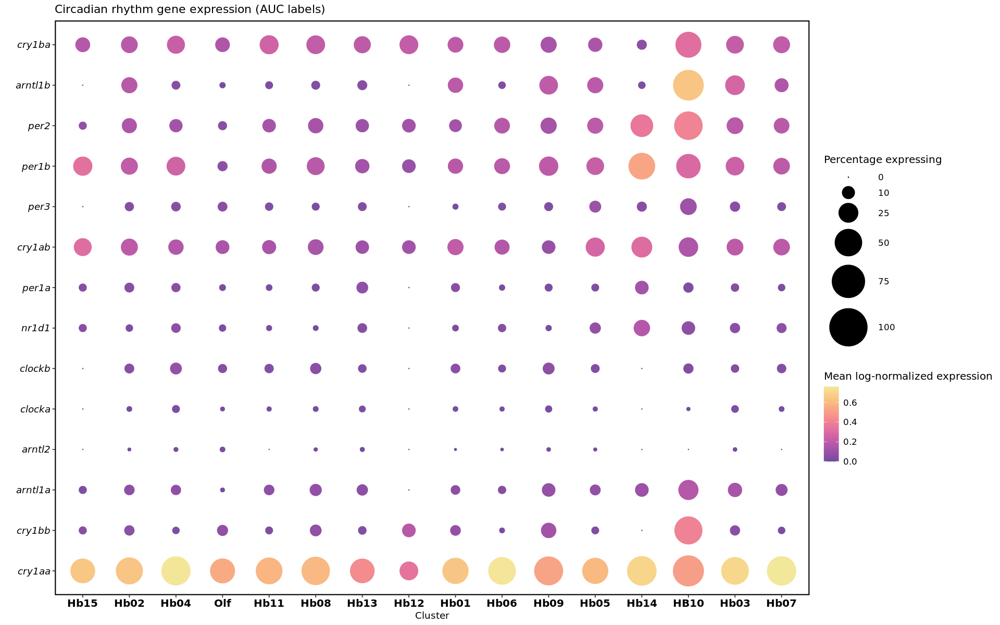

In [117]:
options(repr.plot.width = 16, repr.plot.height = 10)


ggplot(circ_df_auc, aes(col = rwm, size = rwp, x = cluster, y = gene)) + 
geom_point() +
scale_size_continuous(limits = c(0,100), range = c(0.1,20), breaks = c(0, 10, 25, 50, 75, 100)) +
scale_colour_continuous_sequential(palette = "Sunset", rev = FALSE) +
labs(x = "Cluster", y = "", size = "Percentage expressing", colour = "Mean log-normalized expression") +
theme(legend.key=element_blank(), 
  axis.text.x = element_text(colour = "black", size = 12, face = "bold"), 
  axis.text.y = element_text(colour = "black", face = "italic", size = 11), 
  legend.text = element_text(size = 10, colour ="black"), 
  legend.title = element_text(size = 12), 
  panel.background = element_blank(), panel.border = element_rect(colour = "black", fill = NA, size = 1.2), 
  legend.position = "right") +
ggtitle("Circadian rhythm gene expression (AUC labels)")

The Hb10 cluster, dorsal and left-enriched according to the authors, is the one expressing many of the circadian rhythm genes. 

## Adult habenula 10x data

The same workflow applies to the adult 10X data. There are two experiments that have to be merged and their batch effects accounted for.


In [119]:
rawdata_ad <- as.matrix(cbind(rawdata_10x_2, rawdata_10x_3))

fish_10x_ad <- SingleCellExperiment(assays = list("counts" = rawdata_ad), 
                           colData = colnames(rawdata_ad),
                           rowData = rownames(rawdata_ad))

### QC and filtering


In [120]:
fish_10x_ad_feat_QC <- scater::perFeatureQCMetrics(fish_10x_ad)

rowData(fish_10x_ad) <- cbind(rowData(fish_10x_ad), fish_10x_ad_feat_QC)

# Experimental batch

colData(fish_10x_ad)$batch <- factor(c(rep("A", ncol(rawdata_10x_2)), rep("B", ncol(rawdata_10x_3))))

In [121]:
fish_10x_ad_feat_QC <- perCellQCMetrics(fish_10x_ad, subsets = list(mito = grep("^MT-", rownames(fish_sm)), Malat1 = grep("MALAT1", rownames(fish_sm)), Ribo = grep("^MRPL|^MRPS|^RPL|^RPS", rownames(fish_sm))))

low.lib <- isOutlier(log10(fish_10x_ad_feat_QC$sum), type = "lower", nmad=3, batch = colData(fish_10x_ad)$batch)

low.genes <- isOutlier(log10(fish_10x_ad_feat_QC$detected), type = "lower", nmad = 3, batch = colData(fish_10x_ad)$batch)

high.mt <- isOutlier(fish_10x_ad_feat_QC$subsets_mito_percent, type = "higher", nmad = 4, batch = colData(fish_10x_ad)$batch)

high.malat1 <- isOutlier(fish_10x_ad_feat_QC$subsets_Malat1_percent, type = "higher", nmad = 3, batch = colData(fish_10x_ad)$batch)

high.ribo <- isOutlier(fish_10x_ad_feat_QC$subsets_Ribo_percent, type = "higher", nmad = 3, batch = colData(fish_10x_ad)$batch)


data.frame(LowLib = sum(low.lib), 
           LowNgenes = sum(low.genes), 
           HighMT = sum(high.mt),
           HighMalat1 = sum(high.malat1), 
           HighRibo = sum(high.ribo))

fish_10x_ad_feat_QC$discard <- low.lib | low.genes | high.mt | high.malat1 | high.ribo

table(fish_10x_ad_feat_QC$discard)

LowLib,LowNgenes,HighMT,HighMalat1,HighRibo
<int>,<int>,<int>,<int>,<int>
0,0,2322,113,97



FALSE  TRUE 
 5235  2476 

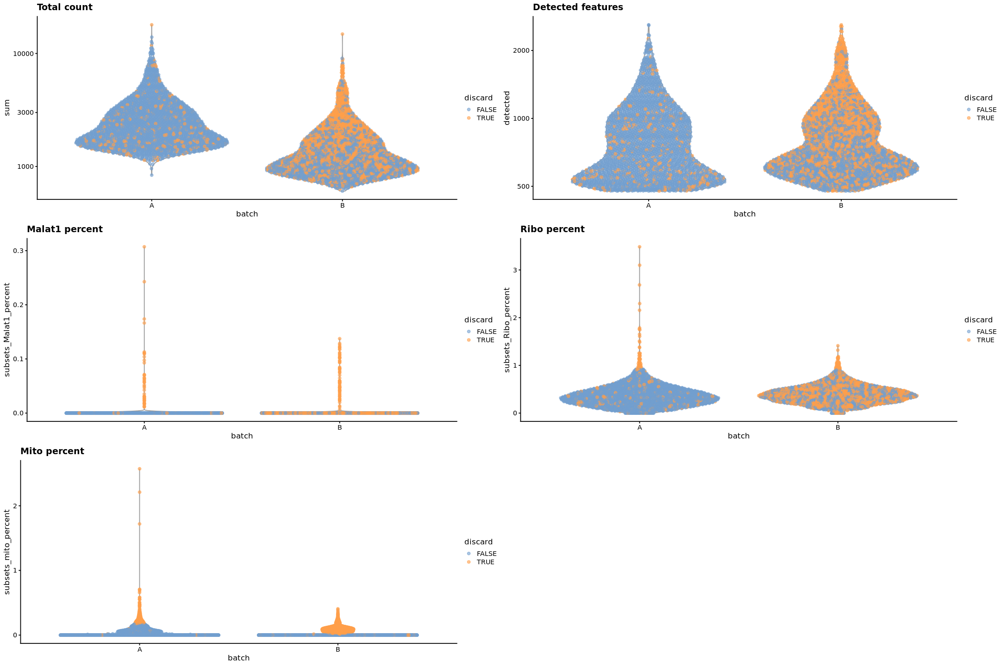

In [122]:
options(repr.plot.width = 18, repr.plot.height = 12)


colData(fish_10x_ad) <- cbind(colData(fish_10x_ad), fish_10x_ad_feat_QC)
fish_10x_ad$discard <- fish_10x_ad_feat_QC$discard

gridExtra::grid.arrange(
    plotColData(fish_10x_ad, y="sum", x= "batch", colour_by="discard") +
        scale_y_log10() + ggtitle("Total count"),
    plotColData(fish_10x_ad, y="detected", x= "batch", colour_by="discard") +
        scale_y_log10() + ggtitle("Detected features"),
     plotColData(fish_10x_ad, y="subsets_Malat1_percent", x= "batch",
        colour_by="discard") + ggtitle("Malat1 percent"),
    plotColData(fish_10x_ad, y="subsets_Ribo_percent", x= "batch",
        colour_by="discard") + ggtitle("Ribo percent"),
    plotColData(fish_10x_ad, y="subsets_mito_percent", x= "batch",
        colour_by="discard") + ggtitle("Mito percent"),
    
    ncol=2
)

Judging by the relatively low (< 3%/4%) values of MT and Ribo transcripts, the data has been already filtered, so we will not apply any of the filters above.

In [123]:
set.seed(420)

# Doublet identification
fish_10x_ad <- scDblFinder(fish_10x_ad, samples = fish_10x_ad$batch)

In [124]:
table(fish_10x_ad$scDblFinder.class)


singlet doublet 
   7418     293 

A minority of barcodes is estimated as doublet.

### Normalization

In [125]:
set.seed(46290)

# Normalization: quick clustering

fish_10x_ad_clusters <- quickCluster(fish_10x_ad, block = fish_10x_ad$batch)

table(fish_10x_ad_clusters)

fish_10x_ad_clusters
  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20 
349 615 314 135 619 511 104 229 289 129 261 616 208 204 746 123 200 920 292 259 
 21  22  23 
302 119 167 

In [126]:
# Normalization by batch

fish_10x_ad <- computeSumFactors(fish_10x_ad, clusters = fish_10x_ad_clusters)
fish_10x_ad <- logNormCounts(fish_10x_ad)
fish_10x_ad_mbn <- multiBatchNorm(fish_10x_ad, batch = "batch")

### Dimensionality reduction and batch effect correction

In [127]:
# Variance modelling accounting for batch

fish_10x_ad_var <- modelGeneVar(fish_10x_ad_mbn, block = fish_10x_ad$batch)

In [128]:
# HVG selection
vars_combined <- combineVar(fish_10x_ad_var$per.block[["A"]], 
                    fish_10x_ad_var$per.block[["B"]])

choose_hvgs <- getTopHVGs(vars_combined, n = 2000)

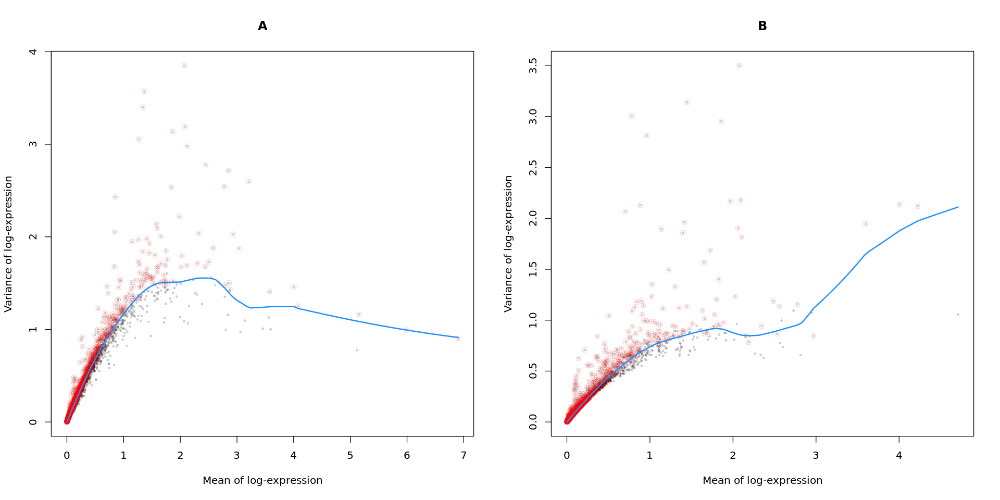

In [129]:
options(repr.plot.width = 16, repr.plot.height = 8)

# Visualization of mean-variance trend and HVGs

blocked.stats <- fish_10x_ad_var$per.block
layout(matrix(1:2, nrow = 1, byrow = TRUE))

for (i in colnames(blocked.stats)) {
    current <- blocked.stats[[i]]
    plot(current$mean, current$total, main=i, pch=16, cex=0.5,  col=rgb(0,0,0,0.2),
        xlab="Mean of log-expression", ylab="Variance of log-expression")
    points(current[choose_hvgs, "mean"], current[choose_hvgs, "total"], col = rgb(1,0,0,0.2))
    curfit <- metadata(current)
    curve(curfit$trend(x), col='dodgerblue', add=TRUE, lwd=2)
}

In [130]:
# Dimensionality reduction and batch effect correction

fish_10x_ad_mbn <- runPCA(fish_10x_ad_mbn, 
                      subset_row = choose_hvgs, 
                      exprs_values = "logcounts") 

fish_10x_ad_corrected <- fastMNN(fish_10x_ad, batch = fish_10x_ad_mbn$batch, subset.row = choose_hvgs)

We visualize the correction plotting the first two Principal Components

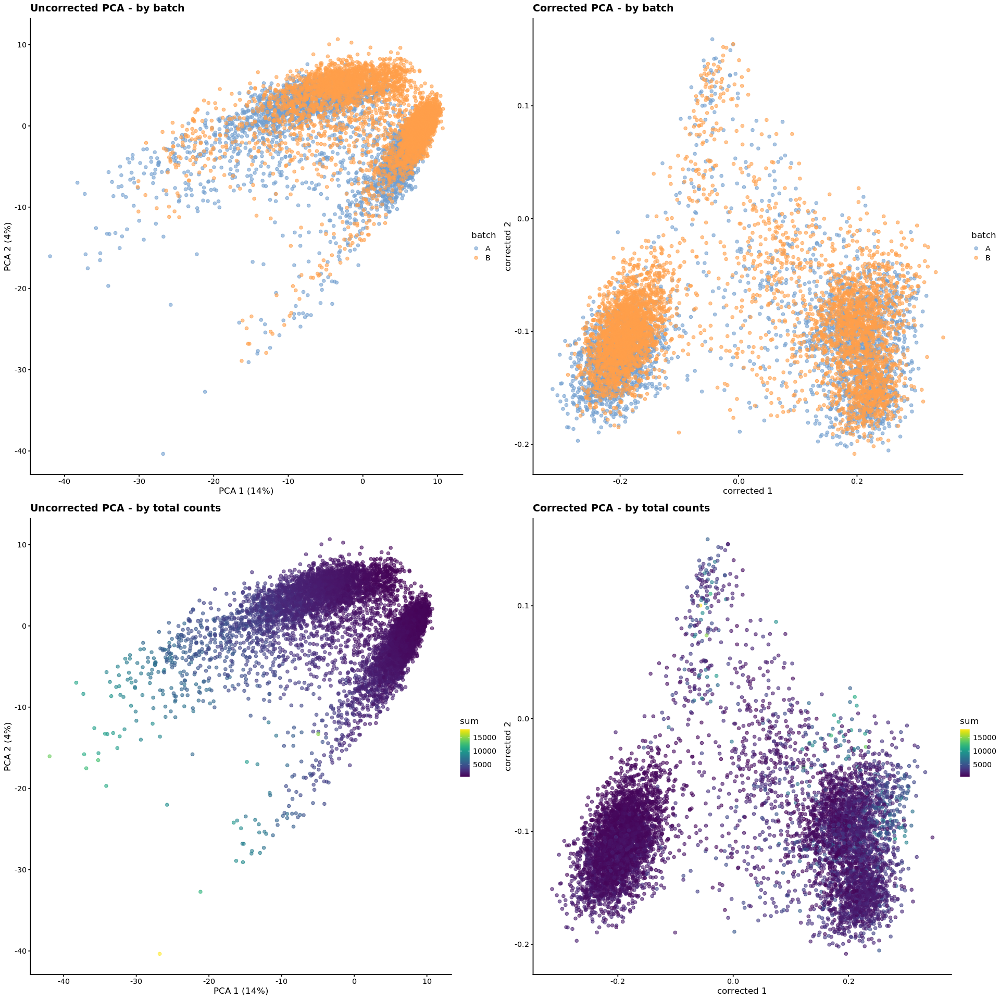

In [131]:
options(repr.plot.width = 16, repr.plot.height = 16)

fish_10x_ad_corrected$batch <- fish_10x_ad_mbn$batch
fish_10x_ad_corrected$sum <- fish_10x_ad_mbn$sum

gridExtra::grid.arrange(
plotReducedDim(fish_10x_ad_mbn, dimred = "PCA", 
               colour_by = "batch"
              ) + labs(title = "Uncorrected PCA - by batch"),

plotReducedDim(fish_10x_ad_corrected, dimred = "corrected", 
               colour_by = "batch"
              ) + labs(title = "Corrected PCA - by batch"),

plotReducedDim(fish_10x_ad_mbn, dimred = "PCA", 
               colour_by = "sum"
              ) + labs(title = "Uncorrected PCA - by total counts"),

plotReducedDim(fish_10x_ad_corrected, dimred = "corrected", 
               colour_by = "sum"
              ) + labs(title = "Corrected PCA - by total counts"),
ncol = 2)

Dimensionality estimation:

In [132]:
n_neighbours = round(sqrt(ncol(fish_10x_ad_corrected)))

In [133]:
intrinsicDimension::maxLikGlobalDimEst(reducedDim(fish_10x_ad_corrected, "corrected"), k = n_neighbours)

Dimension estimate: 15.7541

In [134]:
set.seed(420)

fish_10x_ad_corrected <- runTSNE(fish_10x_ad_corrected, 
                                 dimred = "corrected", 
                                 n_dimred = 1:16)

reducedDim(fish_10x_ad_corrected, "UMAP") <- uwot::umap(reducedDim(fish_10x_ad_corrected, "corrected")[,1:16], 
                                                     n_neighbors = n_neighbours, 
                                                     min_dist = 0.7)


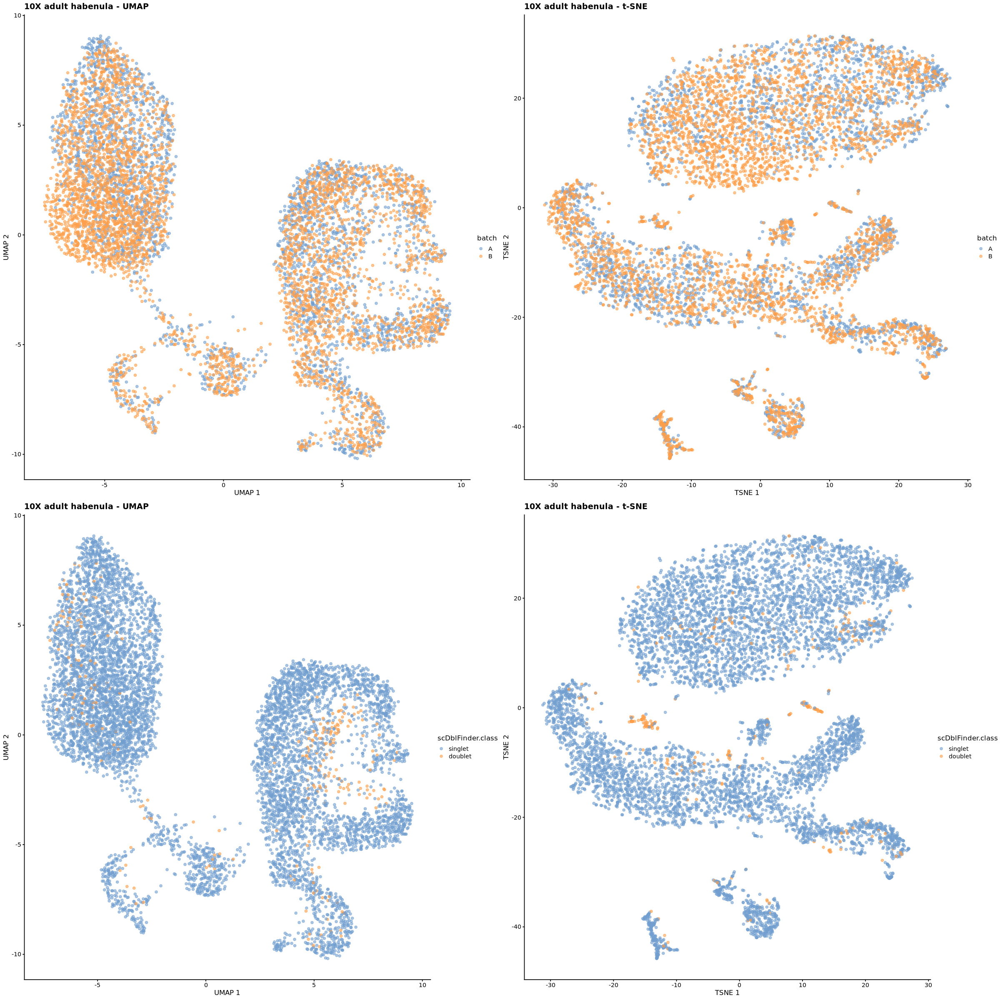

In [135]:
options(repr.plot.width = 20, repr.plot.height = 20)

fish_10x_ad_corrected$scDblFinder.class <- fish_10x_ad_mbn$scDblFinder.class

gridExtra::grid.arrange(
    plotReducedDim(fish_10x_ad_corrected, dimred = "UMAP", colour_by = "batch") + ggtitle("10X adult habenula - UMAP"),
    plotReducedDim(fish_10x_ad_corrected, dimred = "TSNE", colour_by = "batch") + ggtitle("10X adult habenula - t-SNE"),
    plotReducedDim(fish_10x_ad_corrected, dimred = "UMAP", colour_by = "scDblFinder.class") + ggtitle("10X adult habenula - UMAP"),
    plotReducedDim(fish_10x_ad_corrected, dimred = "TSNE", colour_by = "scDblFinder.class") + ggtitle("10X adult habenula - t-SNE"),
    ncol = 2)


We remove the doublets.

In [136]:
fish_10x_ad_corrected <- fish_10x_ad_corrected[,fish_10x_ad_corrected$scDblFinder.class == "singlet"]

### Clustering

Like before, we have 2 different numbers of dimensions: 16 (as estimated earlier) and 30 (as used by the authors). We run the pipeline using both dimension numbers in parallel.

In [137]:
fish_10x_ad_corrected_16dim <- fish_10x_ad_corrected
fish_10x_ad_corrected_30dim <- fish_10x_ad_corrected

reducedDim(fish_10x_ad_corrected_16dim, type = "corrected") <- reducedDim(fish_10x_ad_corrected_16dim, type = "corrected")[,1:16]
reducedDim(fish_10x_ad_corrected_30dim, type = "corrected") <- reducedDim(fish_10x_ad_corrected_30dim, type = "corrected")[,1:30]

In [138]:
# 16 dimensions: SNN graph building

fish_10x_ad_corrected_16dim_SNN_4 <- buildSNNGraph(fish_10x_ad_corrected_16dim, use.dimred = "corrected", type = "jaccard", k = 4)
fish_10x_ad_corrected_16dim_SNN_5 <- buildSNNGraph(fish_10x_ad_corrected_16dim, use.dimred = "corrected", type = "jaccard", k = 5)
fish_10x_ad_corrected_16dim_SNN_10 <- buildSNNGraph(fish_10x_ad_corrected_16dim, use.dimred = "corrected", type = "jaccard", k = 10)
fish_10x_ad_corrected_16dim_SNN_20 <- buildSNNGraph(fish_10x_ad_corrected_16dim, use.dimred = "corrected", type = "jaccard", k = 20)
fish_10x_ad_corrected_16dim_SNN_30 <- buildSNNGraph(fish_10x_ad_corrected_16dim, use.dimred = "corrected", type = "jaccard", k = 30)
fish_10x_ad_corrected_16dim_SNN_40 <- buildSNNGraph(fish_10x_ad_corrected_16dim, use.dimred = "corrected", type = "jaccard", k = 40)

# 16 dimensions: Louvain clustering

fish_10x_ad_corrected_16dim_clusters_4  <- igraph::cluster_louvain(fish_10x_ad_corrected_16dim_SNN_4)
fish_10x_ad_corrected_16dim_clusters_5  <- igraph::cluster_louvain(fish_10x_ad_corrected_16dim_SNN_5)
fish_10x_ad_corrected_16dim_clusters_10  <- igraph::cluster_louvain(fish_10x_ad_corrected_16dim_SNN_10)
fish_10x_ad_corrected_16dim_clusters_20  <- igraph::cluster_louvain(fish_10x_ad_corrected_16dim_SNN_20)
fish_10x_ad_corrected_16dim_clusters_30  <- igraph::cluster_louvain(fish_10x_ad_corrected_16dim_SNN_30)
fish_10x_ad_corrected_16dim_clusters_40  <- igraph::cluster_louvain(fish_10x_ad_corrected_16dim_SNN_40)

clusterings_10x_ad_16dim <- as.data.frame(
               cbind(fish_10x_ad_corrected_16dim_clusters_4$membership,
                     fish_10x_ad_corrected_16dim_clusters_5$membership,
                     fish_10x_ad_corrected_16dim_clusters_10$membership,
                     fish_10x_ad_corrected_16dim_clusters_20$membership,
                     fish_10x_ad_corrected_16dim_clusters_30$membership,
                     fish_10x_ad_corrected_16dim_clusters_40$membership))

colnames(clusterings_10x_ad_16dim) <- c("SNN_6", "SNN_5", "SNN_4", "SNN_3", "SNN_2", "SNN_1")

In [139]:
# 30 dimensions: SNN graph building

fish_10x_ad_corrected_30dim_SNN_4 <- buildSNNGraph(fish_10x_ad_corrected_30dim, use.dimred = "corrected", type = "jaccard", k = 4)
fish_10x_ad_corrected_30dim_SNN_5 <- buildSNNGraph(fish_10x_ad_corrected_30dim, use.dimred = "corrected", type = "jaccard", k = 5)
fish_10x_ad_corrected_30dim_SNN_10 <- buildSNNGraph(fish_10x_ad_corrected_30dim, use.dimred = "corrected", type = "jaccard", k = 10)
fish_10x_ad_corrected_30dim_SNN_20 <- buildSNNGraph(fish_10x_ad_corrected_30dim, use.dimred = "corrected", type = "jaccard", k = 20)
fish_10x_ad_corrected_30dim_SNN_30 <- buildSNNGraph(fish_10x_ad_corrected_30dim, use.dimred = "corrected", type = "jaccard", k = 30)
fish_10x_ad_corrected_30dim_SNN_40 <- buildSNNGraph(fish_10x_ad_corrected_30dim, use.dimred = "corrected", type = "jaccard", k = 40)

# 30 dimensions: Louvain clustering

fish_10x_ad_corrected_30dim_clusters_4  <- igraph::cluster_louvain(fish_10x_ad_corrected_30dim_SNN_4)
fish_10x_ad_corrected_30dim_clusters_5  <- igraph::cluster_louvain(fish_10x_ad_corrected_30dim_SNN_5)
fish_10x_ad_corrected_30dim_clusters_10  <- igraph::cluster_louvain(fish_10x_ad_corrected_30dim_SNN_10)
fish_10x_ad_corrected_30dim_clusters_20  <- igraph::cluster_louvain(fish_10x_ad_corrected_30dim_SNN_20)
fish_10x_ad_corrected_30dim_clusters_30  <- igraph::cluster_louvain(fish_10x_ad_corrected_30dim_SNN_30)
fish_10x_ad_corrected_30dim_clusters_40  <- igraph::cluster_louvain(fish_10x_ad_corrected_30dim_SNN_40)

clusterings_10x_ad_30dim <- as.data.frame(
               cbind(fish_10x_ad_corrected_30dim_clusters_4$membership,
                     fish_10x_ad_corrected_30dim_clusters_5$membership,
                     fish_10x_ad_corrected_30dim_clusters_10$membership,
                     fish_10x_ad_corrected_30dim_clusters_20$membership,
                     fish_10x_ad_corrected_30dim_clusters_30$membership,
                     fish_10x_ad_corrected_30dim_clusters_40$membership))

colnames(clusterings_10x_ad_30dim) <- c("SNN_6", "SNN_5", "SNN_4", "SNN_3", "SNN_2", "SNN_1")

Clustering tree in 16 dimensions:

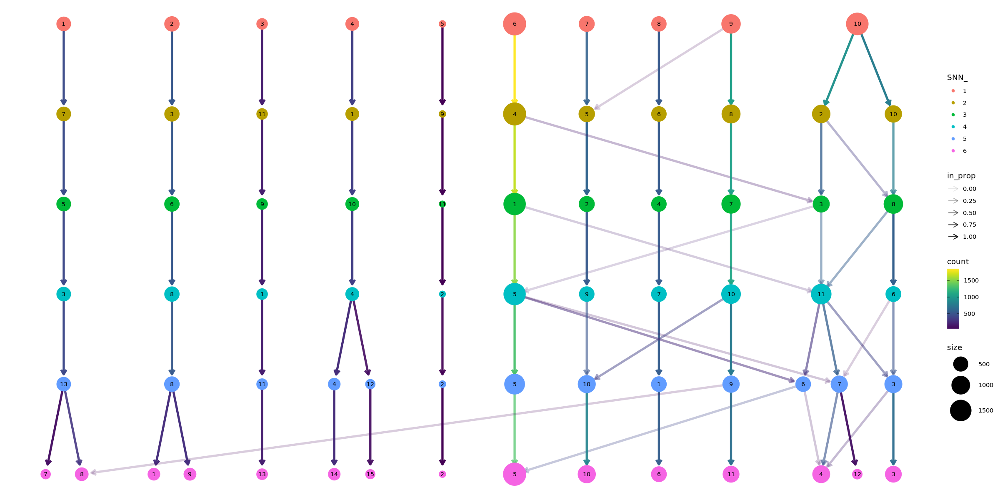

In [140]:
options(repr.plot.width = 20, repr.plot.height = 10)

clustree(clusterings_10x_ad_16dim, prefix = "SNN_")

Clustering tree in 30 dimensions:

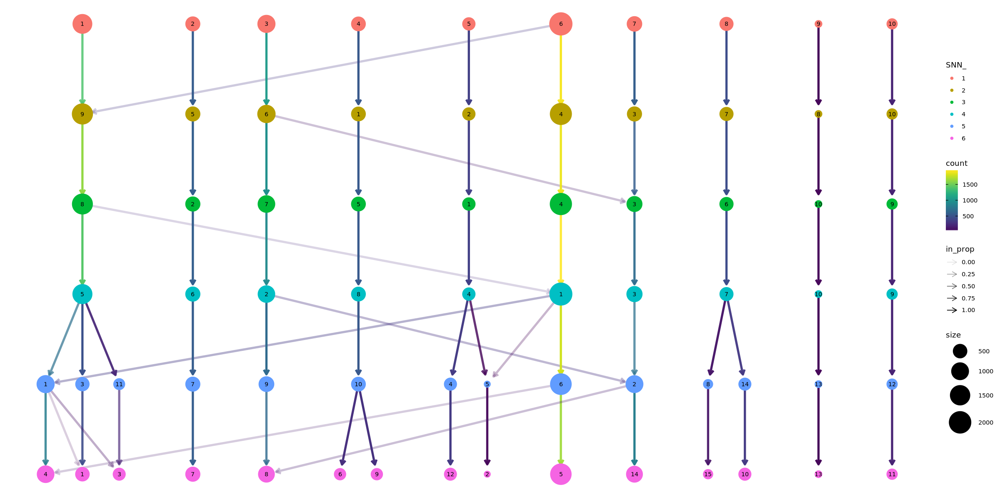

In [141]:
options(repr.plot.width = 20, repr.plot.height = 10)

clustree(clusterings_10x_ad_30dim, prefix = "SNN_")

In [142]:
colData(fish_10x_ad_corrected_16dim)$clustering <- factor(clusterings_10x_ad_16dim$SNN_6)
colData(fish_10x_ad_corrected_30dim)$clustering <- factor(clusterings_10x_ad_30dim$SNN_6)

In [143]:
reducedDim(fish_10x_ad_corrected_30dim, "UMAP") <- uwot::umap(reducedDim(fish_10x_ad_corrected, "corrected")[,1:30], 
                                                     n_neighbors = n_neighbors, 
                                                     min_dist = 0.7)

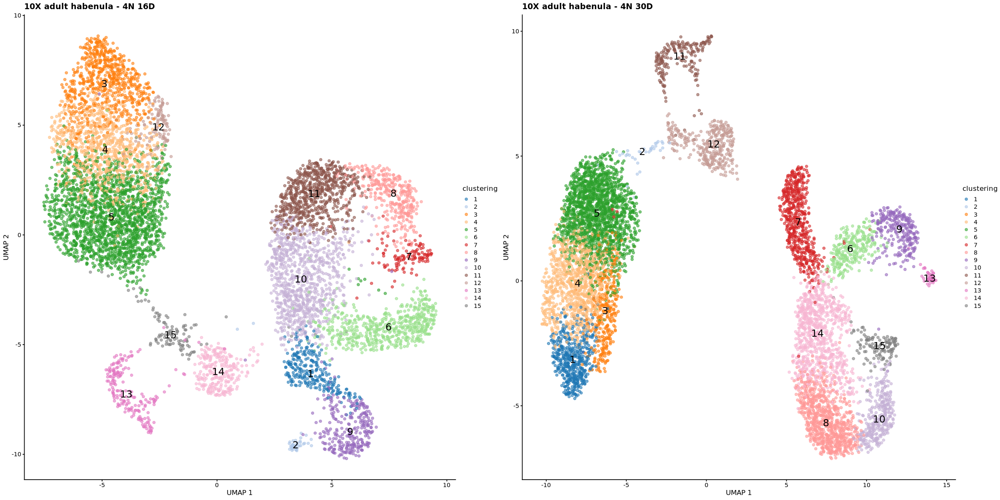

In [144]:
options(repr.plot.width = 20, repr.plot.height = 10)

gridExtra::grid.arrange(
    plotReducedDim(fish_10x_ad_corrected_16dim, dimred = "UMAP", colour_by = "clustering", text_by = "clustering") + 
    ggtitle("10X adult habenula - 4N 16D") +
    scale_fill_manual(values = custom_colors$discrete),
    plotReducedDim(fish_10x_ad_corrected_30dim, dimred = "UMAP", colour_by = "clustering", text_by = "clustering") + 
    ggtitle("10X adult habenula - 4N 30D") +
    scale_fill_manual(values = custom_colors$discrete),
    ncol = 2)

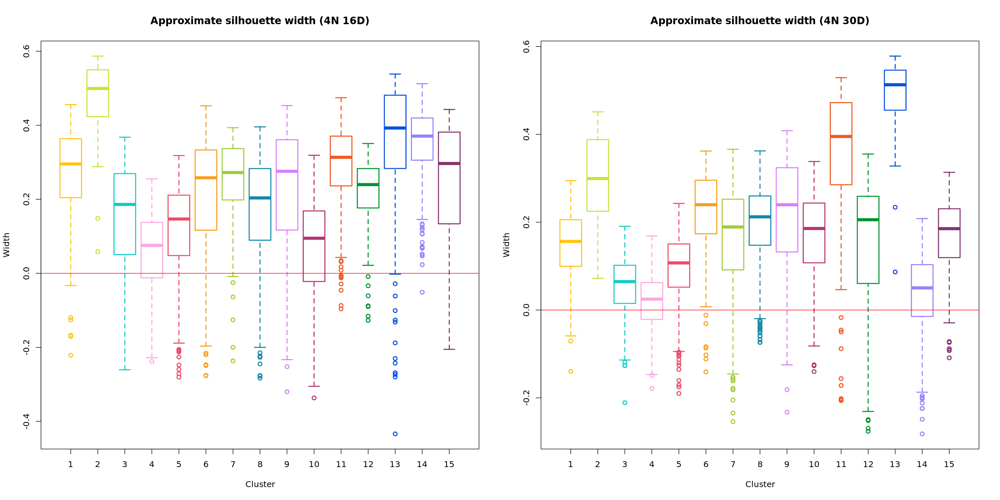

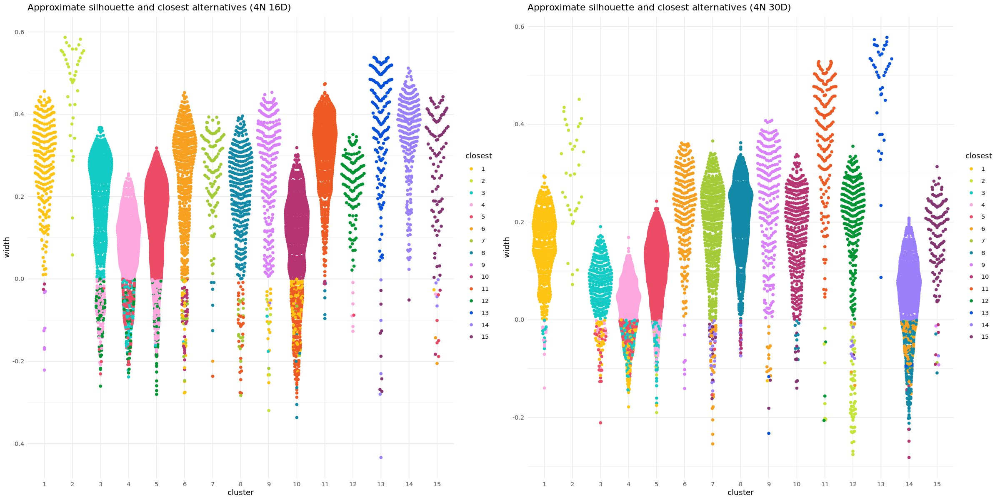

In [145]:
options(repr.plot.width = 20, repr.plot.height = 10)


silhouette_10x_ad_16dim <- as.data.frame(approxSilhouette(reducedDim(fish_10x_ad_corrected_16dim, type = "corrected"), 
                               colData(fish_10x_ad_corrected_16dim)$clustering))

silhouette_10x_ad_30dim <- as.data.frame(approxSilhouette(reducedDim(fish_10x_ad_corrected_30dim, type = "corrected"), 
                               colData(fish_10x_ad_corrected_30dim)$clustering))

silhouette_10x_ad_16dim$cluster <-  colData(fish_10x_ad_corrected_16dim)$clustering
silhouette_10x_ad_30dim$cluster <-  colData(fish_10x_ad_corrected_30dim)$clustering

silhouette_10x_ad_16dim$closest <- factor(ifelse(silhouette_10x_ad_16dim$width > 0, silhouette_10x_ad_16dim$cluster, silhouette_10x_ad_16dim$other))
silhouette_10x_ad_30dim$closest <- factor(ifelse(silhouette_10x_ad_30dim$width > 0, silhouette_10x_ad_30dim$cluster, silhouette_10x_ad_30dim$other))

layout(matrix(1:2, nrow  = 1))

boxplot(silhouette_10x_ad_16dim$width ~ silhouette_10x_ad_16dim$cluster, 
        main = "Approximate silhouette width (4N 16D)", 
        ylab = "Width", 
        xlab = "Cluster",
        border = custom_colors$discrete,
        col = NA,
        lwd = 2)
abline(h = 0, col = 'red')

boxplot(silhouette_10x_ad_30dim$width ~ silhouette_10x_ad_30dim$cluster, 
        main = "Approximate silhouette width (4N 30D)", 
        ylab = "Width", 
        xlab = "Cluster",
        border = custom_colors$discrete,
        col = NA,
        lwd = 2)
abline(h = 0, col = 'red')

gridExtra::grid.arrange(
ggplot(silhouette_10x_ad_16dim, aes(x=cluster, y=width, colour=closest)) + 
    ggbeeswarm::geom_quasirandom(method="smiley")  + 
scale_colour_manual(values = custom_colors$discrete) +
theme_minimal() +
ggtitle("Approximate silhouette and closest alternatives (4N 16D)"),

ggplot(silhouette_10x_ad_30dim, aes(x=cluster, y=width, colour=closest)) + 
    ggbeeswarm::geom_quasirandom(method="smiley")  + 
scale_colour_manual(values = custom_colors$discrete) +
theme_minimal() +
ggtitle("Approximate silhouette and closest alternatives (4N 30D)"),
ncol = 2)

In [146]:
ratio_10x_ad_16dim <- pairwiseModularity(fish_10x_ad_corrected_16dim_SNN_4, 
                                         clusterings_10x_ad_16dim$SNN_6, 
                                         as.ratio = TRUE)

ratio_10x_ad_30dim <- pairwiseModularity(fish_10x_ad_corrected_30dim_SNN_4, 
                                         clusterings_10x_ad_30dim$SNN_6, 
                                         as.ratio = TRUE)

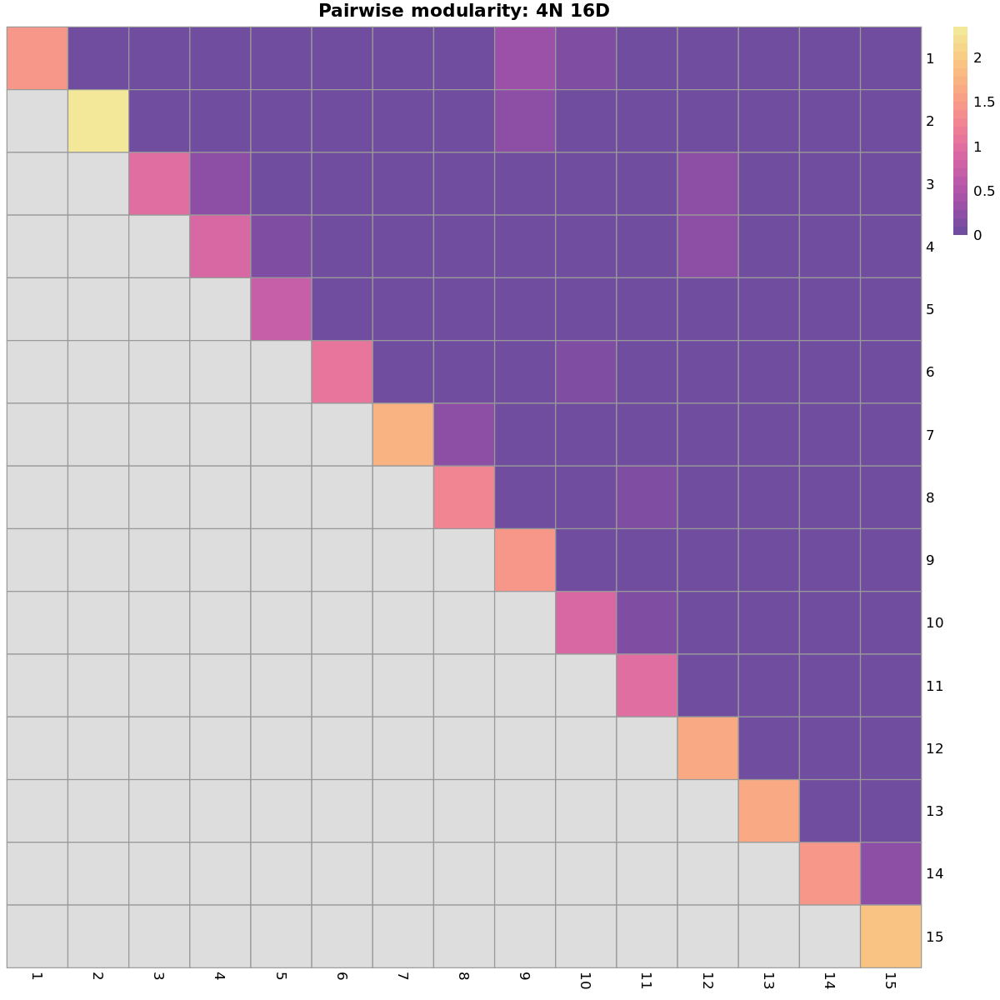

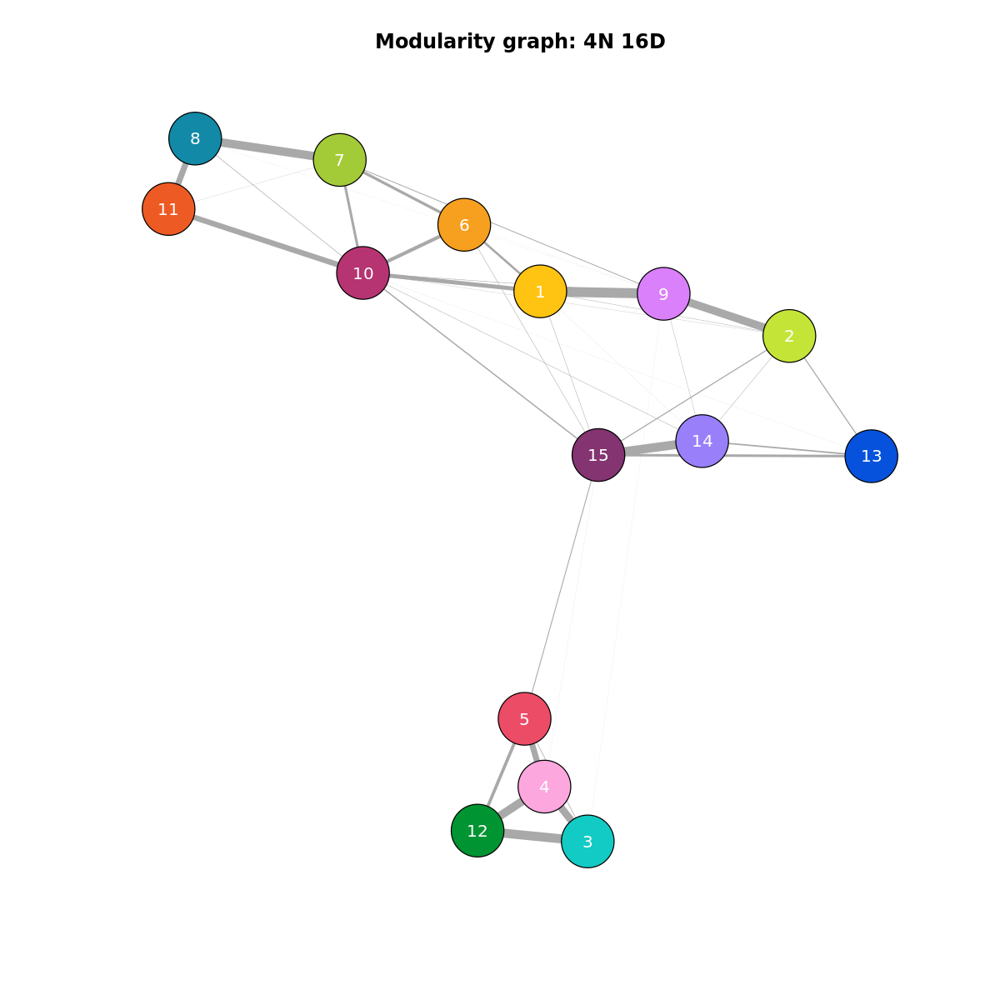

In [147]:
options(repr.plot.width = 10, repr.plot.height = 10)

pheatmap(log10(ratio_10x_ad_16dim + 1), 
        cluster_cols = FALSE, 
        cluster_rows=FALSE,
        col = colorspace::sequential_hcl("Sunset", n = 25),
        main = "Pairwise modularity: 4N 16D")

mod_cluster_10x_ad_16dim_graph <- igraph::graph_from_adjacency_matrix(log2(ratio_10x_ad_16dim + 1), 
                                                                  mode="upper", 
                                                                  weighted=TRUE, 
                                                                  diag=FALSE)

igraph::V(mod_cluster_10x_ad_16dim_graph)$color = custom_colors$discrete
igraph::V(mod_cluster_10x_ad_16dim_graph)$label.color = "white"
igraph::V(mod_cluster_10x_ad_16dim_graph)$label.family = "sans"

set.seed(42069)
plot(mod_cluster_10x_ad_16dim_graph, edge.width=igraph::E(mod_cluster_10x_ad_16dim_graph)$weight*10,
    layout=igraph::layout_with_fr,
    main = "Modularity graph: 4N 16D")

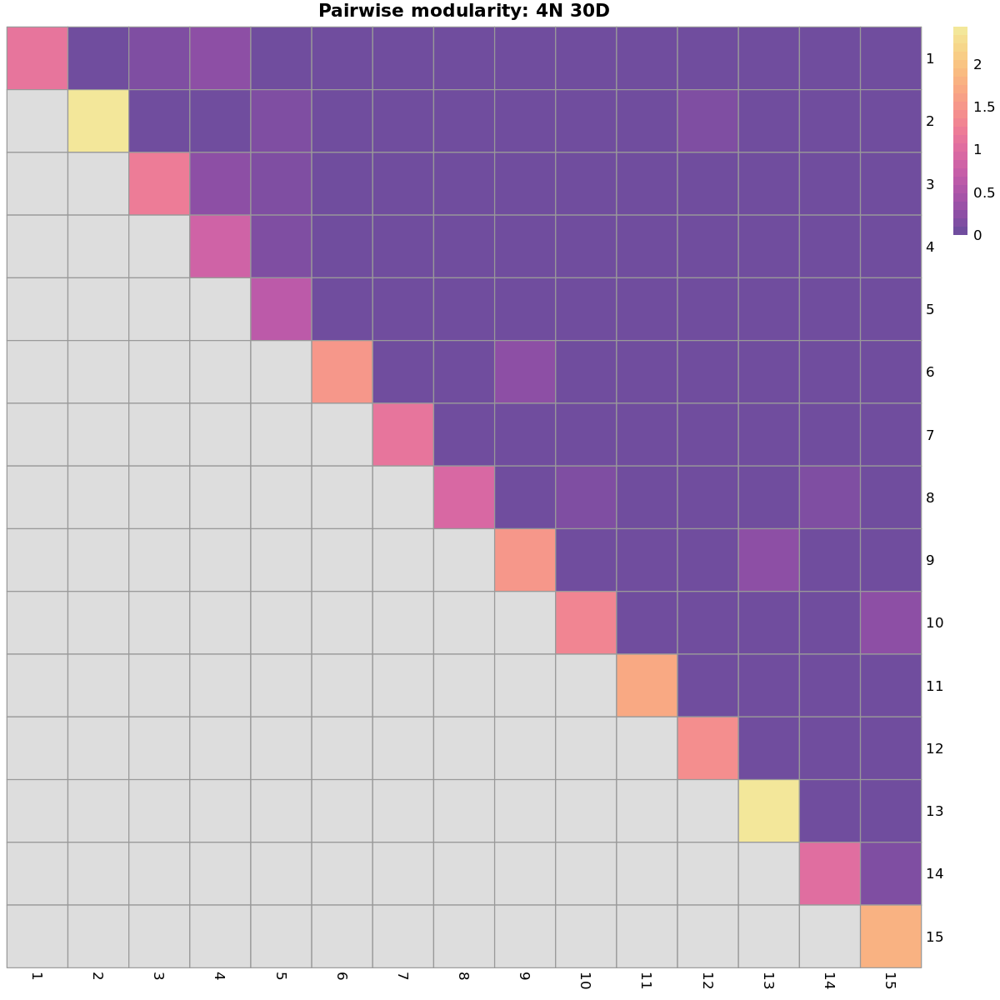

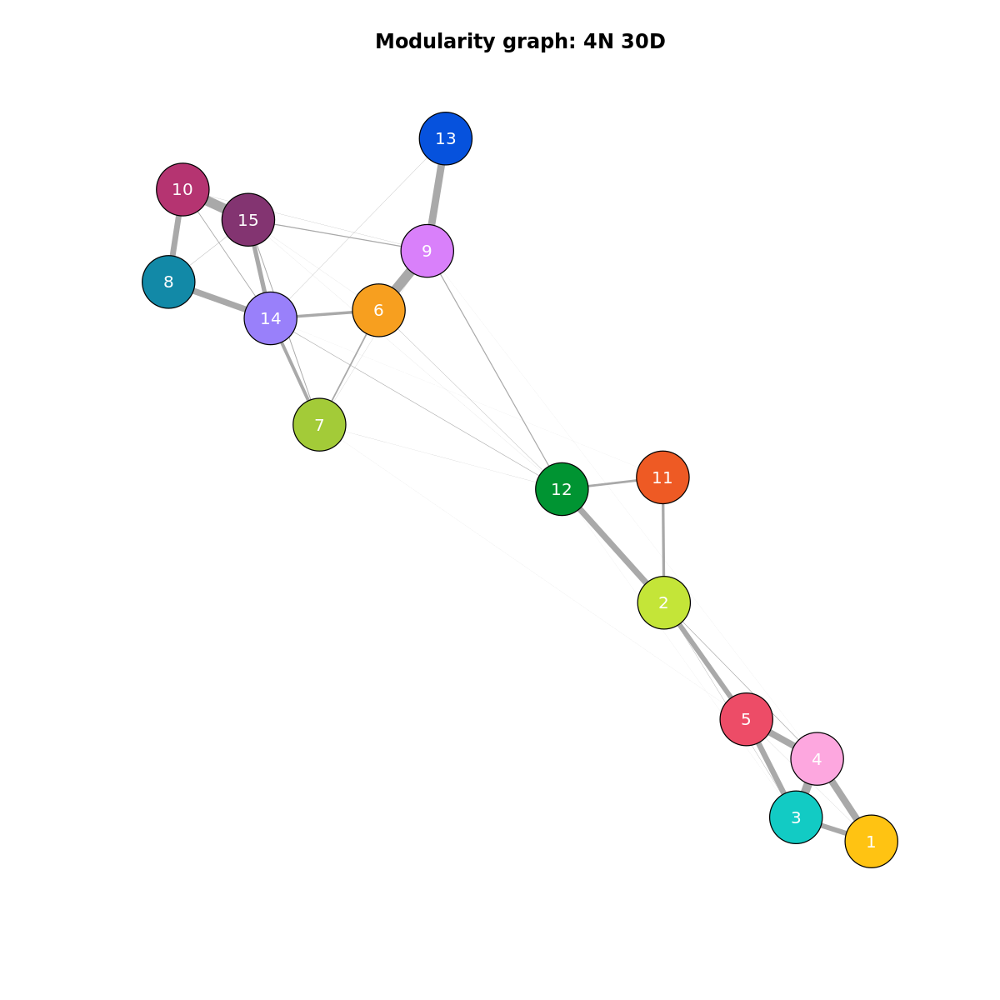

In [148]:
pheatmap(log10(ratio_10x_ad_30dim + 1), 
        cluster_cols = FALSE, 
        cluster_rows=FALSE,
        col = colorspace::sequential_hcl("Sunset", n = 25),
        main = "Pairwise modularity: 4N 30D")

mod_cluster_10x_ad_30dim_graph <- igraph::graph_from_adjacency_matrix(log2(ratio_10x_ad_30dim + 1), 
                                                                      mode="upper", 
                                                                      weighted=TRUE, 
                                                                      diag=FALSE)

igraph::V(mod_cluster_10x_ad_30dim_graph)$color = custom_colors$discrete
igraph::V(mod_cluster_10x_ad_30dim_graph)$label.color = "white"
igraph::V(mod_cluster_10x_ad_30dim_graph)$label.family = "sans"

set.seed(42069)
plot(mod_cluster_10x_ad_30dim_graph, edge.width=igraph::E(mod_cluster_10x_ad_30dim_graph)$weight*10,
    layout=igraph::layout_with_fr,
    main = "Modularity graph: 4N 30D")

Judging by silhouette width distributions and graph modularity values, 16 dimensions with 4 neighbours yield a better partition of the space.

### Comparison with published cell types

We follow the exact same pipeline as before. We start by building rankings as input to `AUCell`:

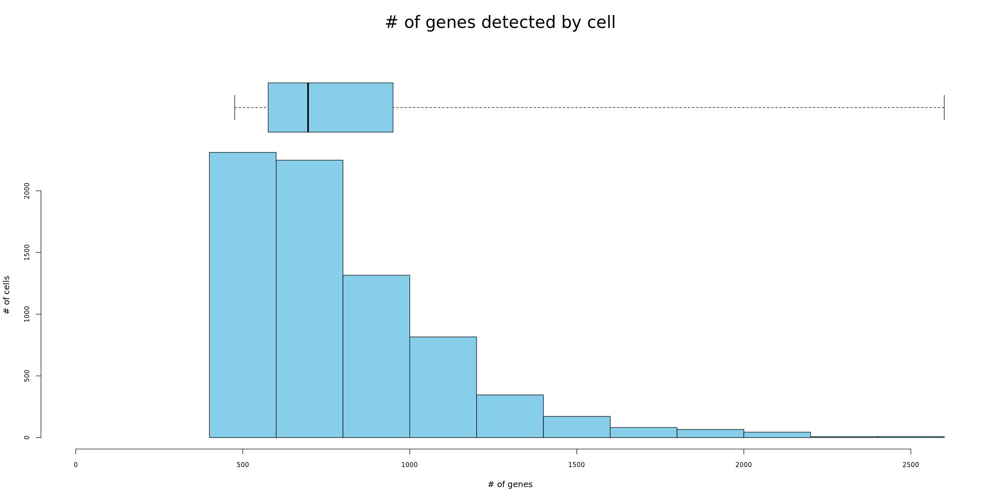

In [149]:
options(repr.plot.width = 20, repr.plot.height = 10)
rankings_10X_ad <- AUCell_buildRankings(counts(fish_10x_ad_mbn[,fish_10x_ad_mbn$scDblFinder.class == "singlet"]),
    plotStats = TRUE,
    verbose = FALSE)                                                 

Using the adult markers we loaded before as genesets:

In [150]:
set.seed(489)

all_sets_ad <- lapply(names(mks_adult_list), function(x) {
    GeneSet(mks_adult_list[[x]], setName=x)        
})
                           
all_sets_ad <- GeneSetCollection(all_sets_ad)
                                        
cell_aucs_10X_ad <- AUCell_calcAUC(all_sets_ad, 
                                   rankings_10X_ad,  
                                   aucMaxRank = ceiling(0.2 * nrow(rankings_10X_ad)))

results_10X_ad <- t(assay(cell_aucs_10X_ad))

Identity assignment and ambiguous type scoring:

In [151]:
cells_assignment_10x_ad <- as.data.frame(results_10X_ad)

cells_assignment_10x_ad$first_max_score <- apply(cells_assignment_10x_ad, 1, max)
cells_assignment_10x_ad$second_max_score <- apply(cells_assignment_10x_ad[,1:(ncol(cells_assignment_10x_ad) - 1)], 1, function(x) {
  return(max(x[x != max(x)]))
    })

cells_assignment_10x_ad$ambiguous <- (cells_assignment_10x_ad$first_max_score - cells_assignment_10x_ad$second_max_score)/(cells_assignment_10x_ad$first_max_score + cells_assignment_10x_ad$second_max_score) <= 0.2
cells_assignment_10x_ad$best_label = colnames(cells_assignment_10x_ad)[apply(cells_assignment_10x_ad[,1:(ncol(cells_assignment_10x_ad) - 3)], 1, which.max)]
colData(fish_10x_ad_corrected_16dim)$labels <- cells_assignment_10x_ad$best_label

Visualizing labels on UMAP:

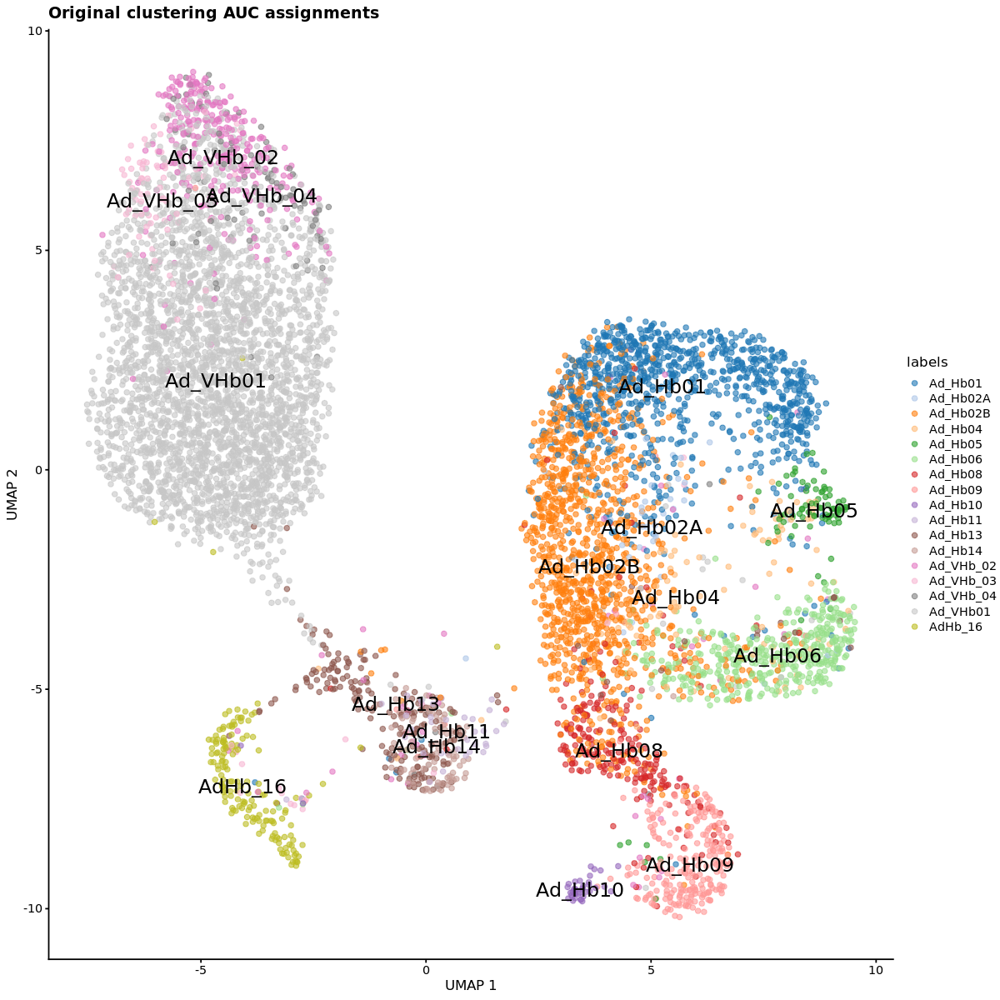

In [152]:
options(repr.plot.width = 10, repr.plot.height = 10)

    plotReducedDim(fish_10x_ad_corrected_16dim, 
                   dimred = "UMAP", 
                   colour_by = "labels", 
                   text_by = "labels") + 
    ggtitle("Original clustering AUC assignments")  + 
    scale_fill_manual(values = custom_colors$discrete)
    

In [170]:
Approximate silhouette width:

ERROR: Error in parse(text = x, srcfile = src): <text>:1:13: unexpected symbol
1: Approximate silhouette
                ^


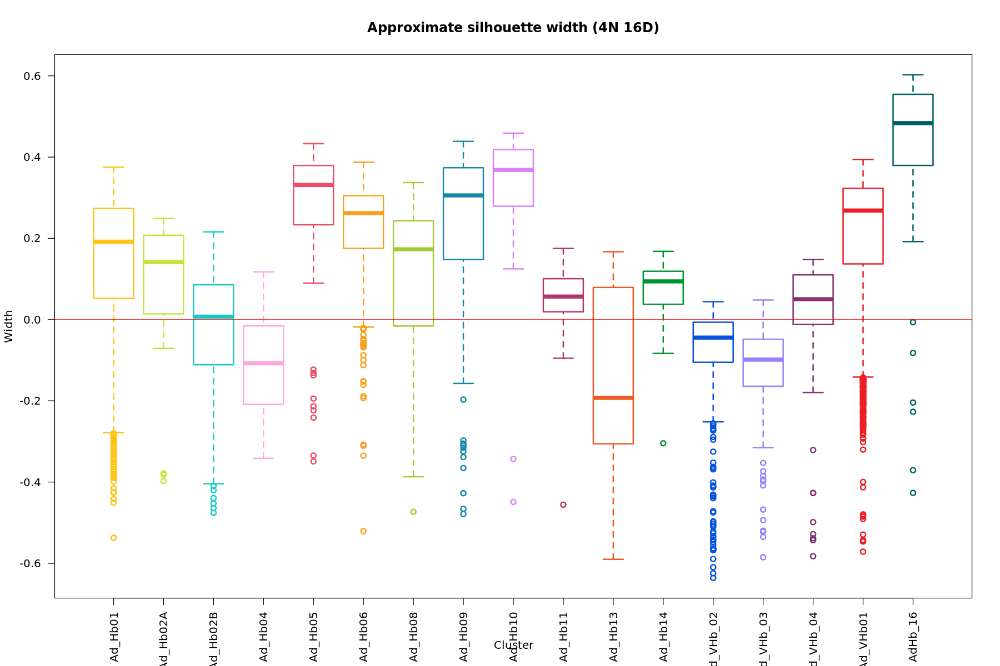

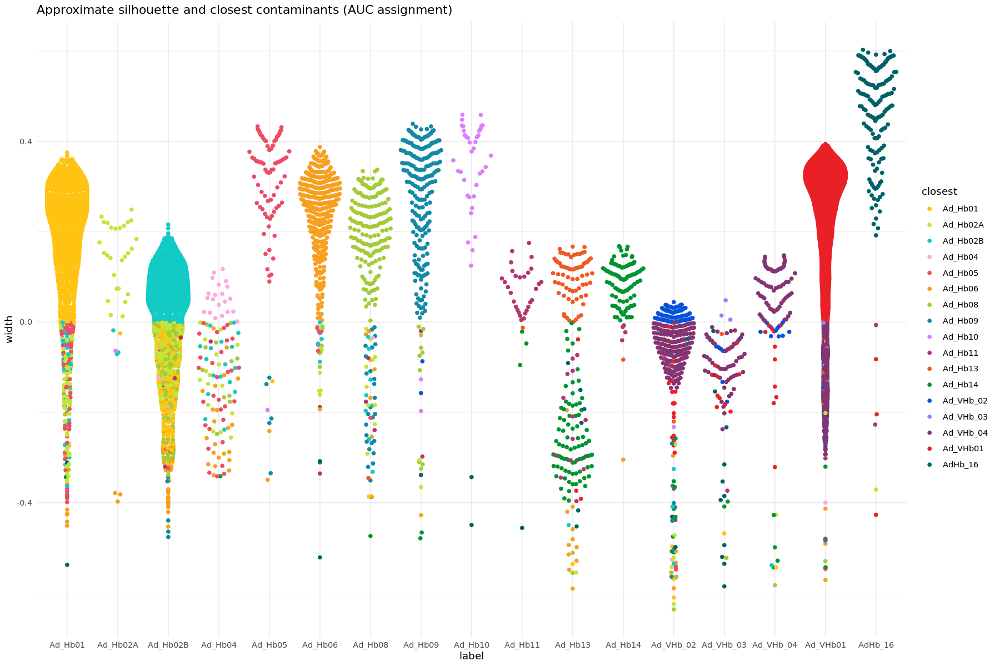

In [153]:
options(repr.plot.width = 15, repr.plot.height = 10)


silhouette_orig_10x_ad <- as.data.frame(approxSilhouette(reducedDim(fish_10x_ad_corrected_16dim, type = "corrected"), 
                               colData(fish_10x_ad_corrected_16dim)$labels))

silhouette_orig_10x_ad$label <-  colData(fish_10x_ad_corrected_16dim)$labels

silhouette_orig_10x_ad$closest <- factor(ifelse(silhouette_orig_10x_ad$width > 0, silhouette_orig_10x_ad$label, silhouette_orig_10x_ad$other))


boxplot(silhouette_orig_10x_ad$width ~ silhouette_orig_10x_ad$label, 
        main = "Approximate silhouette width (16D)", 
        ylab = "Width", 
        xlab = "Cluster",
        border = custom_colors$discrete,
        col = NA,
        lwd = 2, 
        las = 2)

abline(h = 0, col = 'red')

ggplot(silhouette_orig_10x_ad, aes(x=label, y=width, colour=closest)) + 
    ggbeeswarm::geom_quasirandom(method="smiley")  + 
scale_colour_manual(values = custom_colors$discrete) +
theme_minimal() +
ggtitle("Approximate silhouette and closest alternatives (AUC assignment)")


How do these identities overlap with the clustering we chose (16 dimensions, 4 neighbours)?

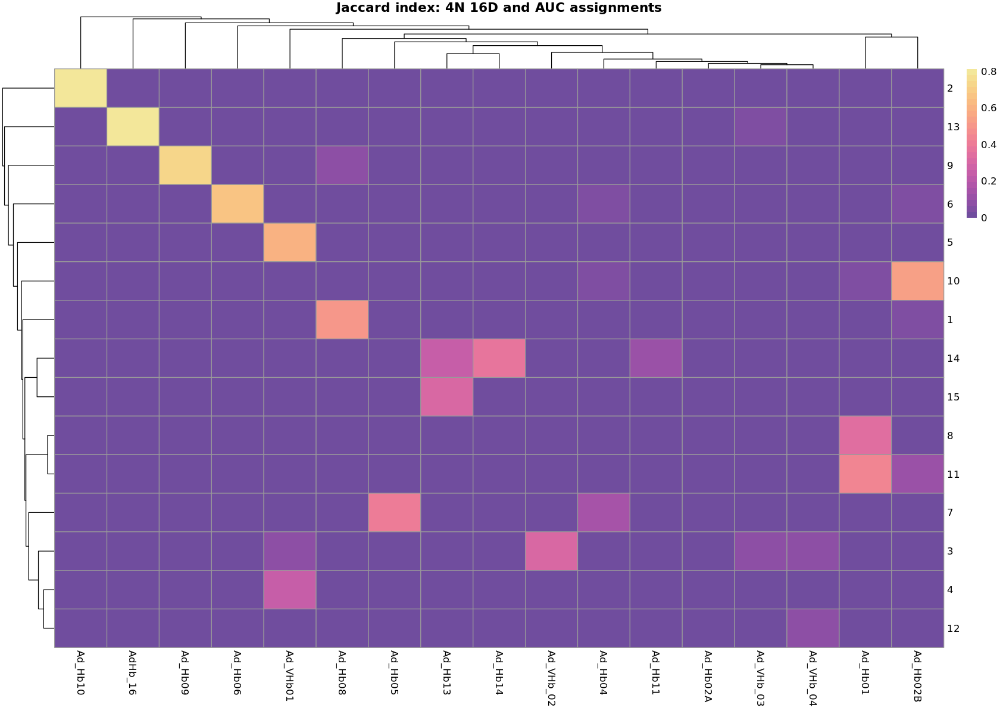

In [154]:
options(repr.plot.width = 14, repr.plot.height = 10)

intersections <- as.matrix(table(colData(fish_10x_ad_corrected_16dim)$clustering, 
                              colData(fish_10x_ad_corrected_16dim)$labels))

unions <- matrix(rowSums(expand.grid(rowSums(intersections), 
                                     colSums(intersections))), 
                 nrow = nrow(intersections), byrow = FALSE) - intersections

jacmat_10x_ad <- intersections/unions

pheatmap(jacmat_10x_ad, 
        cluster_cols = TRUE, 
        cluster_rows = TRUE,
        col = colorspace::sequential_hcl("Sunset", n = 25),
        main = "Jaccard index: 4N 16D and AUC assignments")


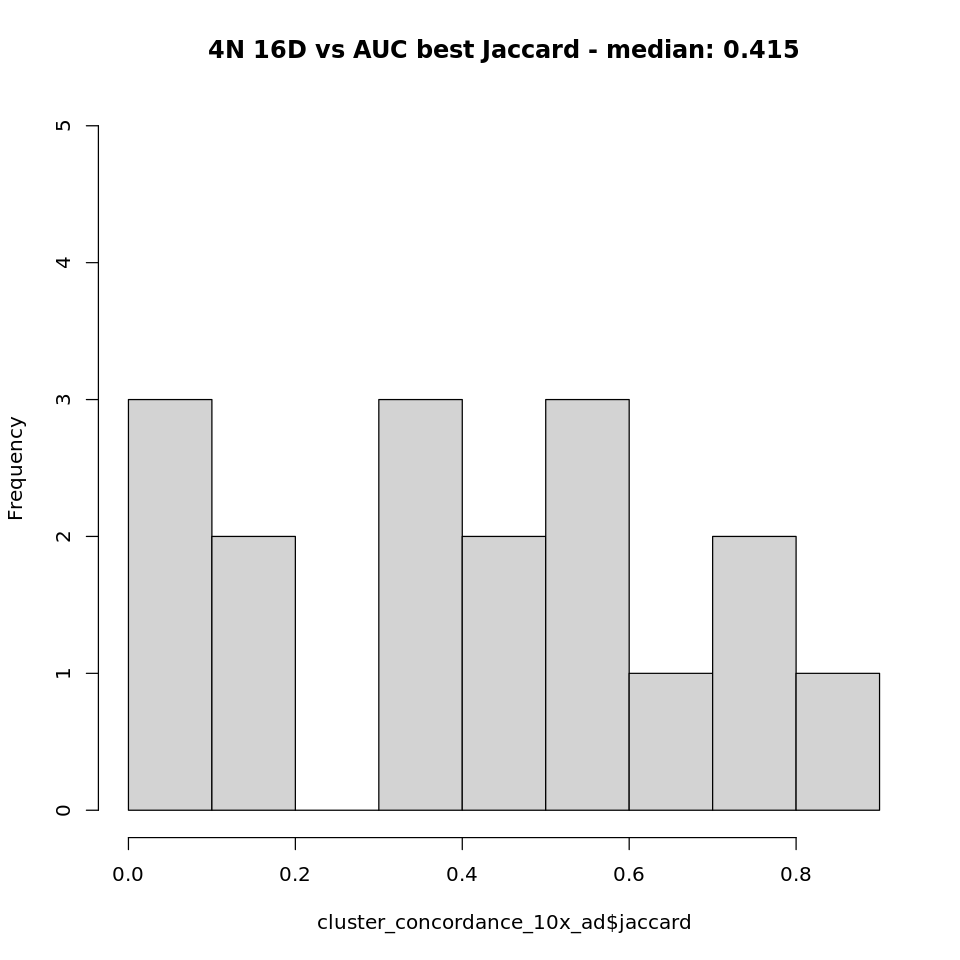

In [155]:
options(repr.plot.width = 8, repr.plot.height = 8)

cluster_concordance_10x_ad <- as.data.frame(cbind(colnames(jacmat_10x_ad), 
                                                 rownames(jacmat_10x_ad)[apply(jacmat_10x_ad, 2, which.max)], 
                                                 apply(jacmat_10x_ad, 2, max)))

colnames(cluster_concordance_10x_ad) <- c("cluster", "original_label", "jaccard")

cluster_concordance_10x_ad$jaccard <- as.numeric(cluster_concordance_10x_ad$jaccard)


hist(cluster_concordance_10x_ad$jaccard, 
     main = paste0('4N 16D vs AUC best Jaccard - median: ', round(median(cluster_concordance_10x_ad$jaccard), digits = 3)), 
     ylim = c(0,5))


Checking the distribution of silhouette widths for ambiguous labels:

In [156]:
table(cells_assignment_10x_ad$best_label, cells_assignment_10x_ad$ambiguous)

cells_assignment_10x_ad$best_label_nd <- cells_assignment_10x_ad$best_label
cells_assignment_10x_ad$best_label_nd[cells_assignment_10x_ad$ambiguous] <- "ND"

colData(fish_10x_ad_corrected_16dim)$labels <- cells_assignment_10x_ad$best_label
colData(fish_10x_ad_corrected_16dim)$labels_nd <- cells_assignment_10x_ad$best_label_nd
colData(fish_10x_ad_corrected_16dim)$ambiguous <- cells_assignment_10x_ad$ambiguous

           
            FALSE TRUE
  Ad_Hb01     335  641
  Ad_Hb02A      2   33
  Ad_Hb02B    297  806
  Ad_Hb04       9  110
  Ad_Hb05      26   57
  Ad_Hb06     107  310
  Ad_Hb08      16  216
  Ad_Hb09      54  187
  Ad_Hb10       6   33
  Ad_Hb11       8   26
  Ad_Hb13      77  114
  Ad_Hb14      38   63
  Ad_VHb_02     3  338
  Ad_VHb_03     0   94
  Ad_VHb_04     1   95
  Ad_VHb01   2217  939
  AdHb_16     124   36

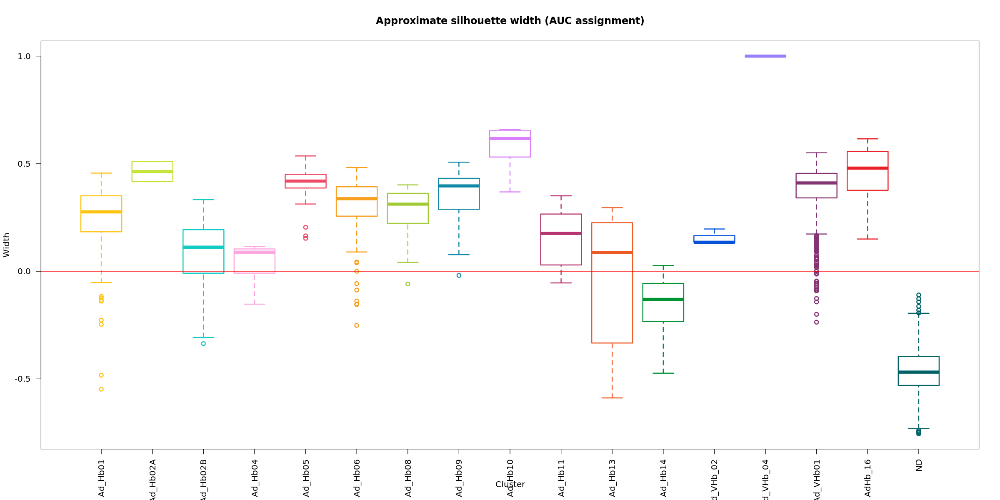

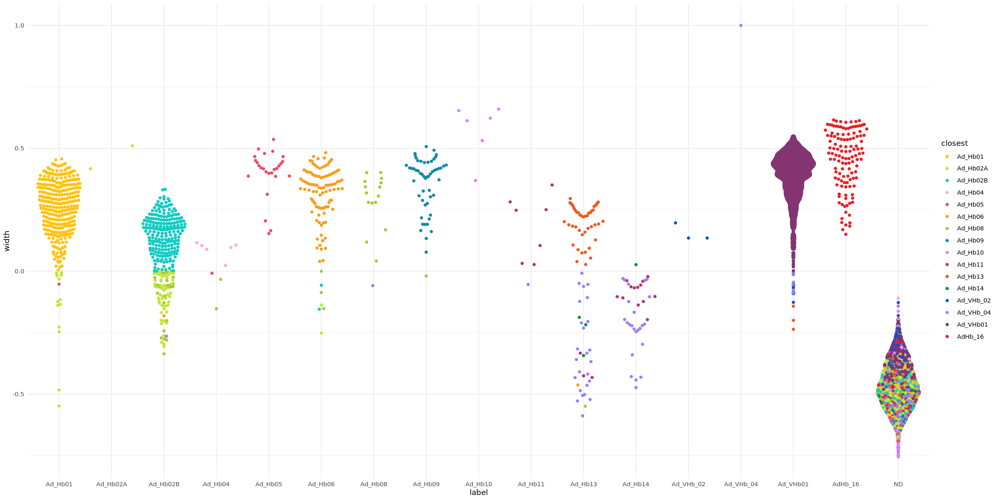

In [157]:
options(repr.plot.width = 20, repr.plot.height = 10)

silhouette_orig_10x_ad <- as.data.frame(approxSilhouette(reducedDim(fish_10x_ad_corrected_16dim, type = "corrected"), 
                               colData(fish_10x_ad_corrected_16dim)$labels_nd))

silhouette_orig_10x_ad$label <-  colData(fish_10x_ad_corrected_16dim)$labels_nd

silhouette_orig_10x_ad$closest <- factor(ifelse(silhouette_orig_10x_ad$width > 0, silhouette_orig_10x_ad$label, silhouette_orig_10x_ad$other))


boxplot(silhouette_orig_10x_ad$width ~ silhouette_orig_10x_ad$label, 
        main = "Approximate silhouette width (AUC assignment)", 
        ylab = "Width", 
        xlab = "Cluster",
        border = custom_colors$discrete,
        col = NA,
        lwd = 2,
        las = 2)

abline(h = 0, col = 'red')

ggplot(silhouette_orig_10x_ad, aes(x=label, y=width, colour=closest)) + 
    ggbeeswarm::geom_quasirandom(method="smiley")  + 
scale_colour_manual(values = custom_colors$discrete) +
theme_minimal()

Reassigning ambiguous labels to the closest centroid:

In [158]:
fish_10x_ad_corrected_16dim_reassigned <- fish_10x_ad_corrected_16dim

colData(fish_10x_ad_corrected_16dim_reassigned)[rownames(silhouette_orig_10x_ad[silhouette_orig_10x_ad$label == "ND",]), "labels"] <- as.character(silhouette_orig_10x_ad[silhouette_orig_10x_ad$label == "ND", "closest"])


Checking the silhouette width distribution of the reassigned types:

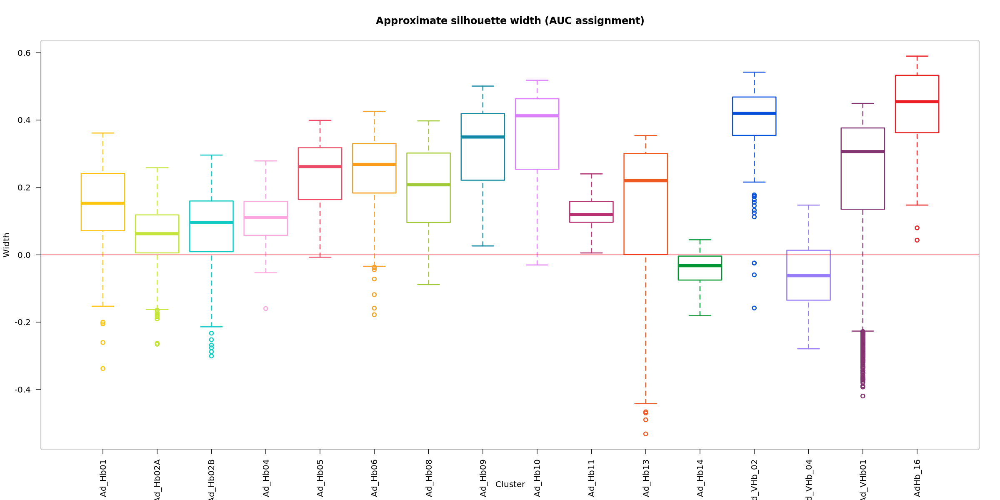

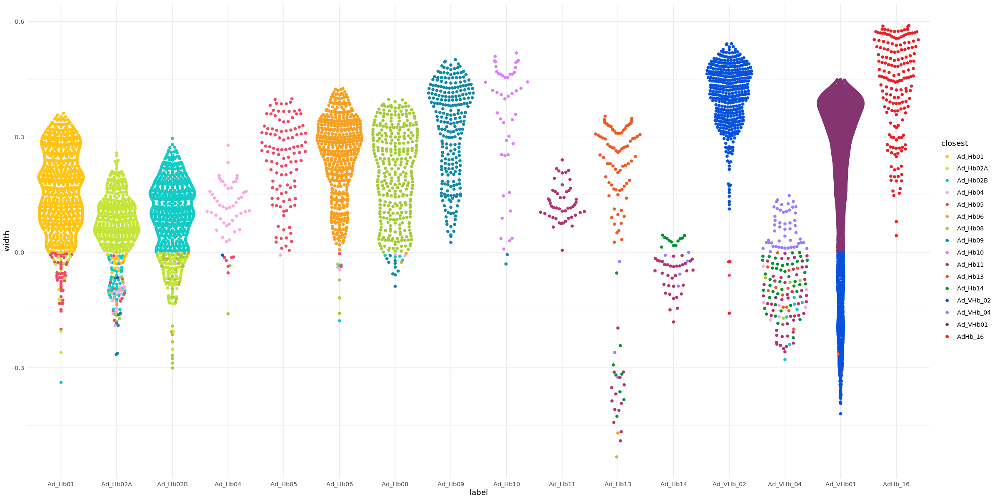

In [159]:
silhouette_orig_10x_ad_reassigned <- as.data.frame(approxSilhouette(reducedDim(fish_10x_ad_corrected_16dim_reassigned, type = "corrected"), 
                               colData(fish_10x_ad_corrected_16dim_reassigned)$labels))

silhouette_orig_10x_ad_reassigned$label <-  colData(fish_10x_ad_corrected_16dim_reassigned)$labels

silhouette_orig_10x_ad_reassigned$closest <- factor(ifelse(silhouette_orig_10x_ad_reassigned$width > 0, silhouette_orig_10x_ad_reassigned$label, silhouette_orig_10x_ad_reassigned$other))


boxplot(silhouette_orig_10x_ad_reassigned$width ~ silhouette_orig_10x_ad_reassigned$label, 
        main = "Approximate silhouette width (AUC assignment)", 
        ylab = "Width", 
        xlab = "Cluster",
        border = custom_colors$discrete,
        col = NA,
        lwd = 2,
        las = 2)

abline(h = 0, col = 'red')

ggplot(silhouette_orig_10x_ad_reassigned, aes(x=label, y=width, colour=closest)) + 
    ggbeeswarm::geom_quasirandom(method="smiley")  + 
scale_colour_manual(values = custom_colors$discrete) +
theme_minimal()

There has been an improvement for several types. Does this improvement agree more with the clustering?

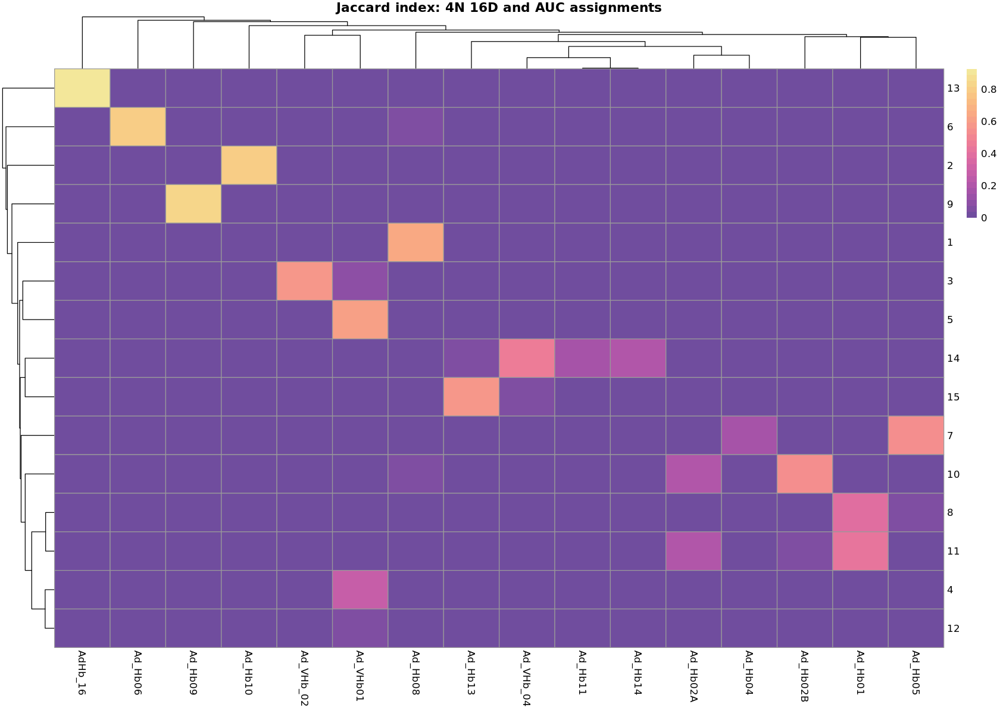

In [160]:
options(repr.plot.width = 14, repr.plot.height = 10)

intersections <- as.matrix(table(colData(fish_10x_ad_corrected_16dim_reassigned)$clustering, 
                              colData(fish_10x_ad_corrected_16dim_reassigned)$labels))

unions <- matrix(rowSums(expand.grid(rowSums(intersections), 
                                     colSums(intersections))), 
                 nrow = nrow(intersections), byrow = FALSE) - intersections

jacmat_10x_ad <- intersections/unions


pheatmap(jacmat_10x_ad, 
        cluster_cols = TRUE, 
        cluster_rows = TRUE,
        col = colorspace::sequential_hcl("Sunset", n = 25),
        main = "Jaccard index: 4N 16D and AUC assignments")

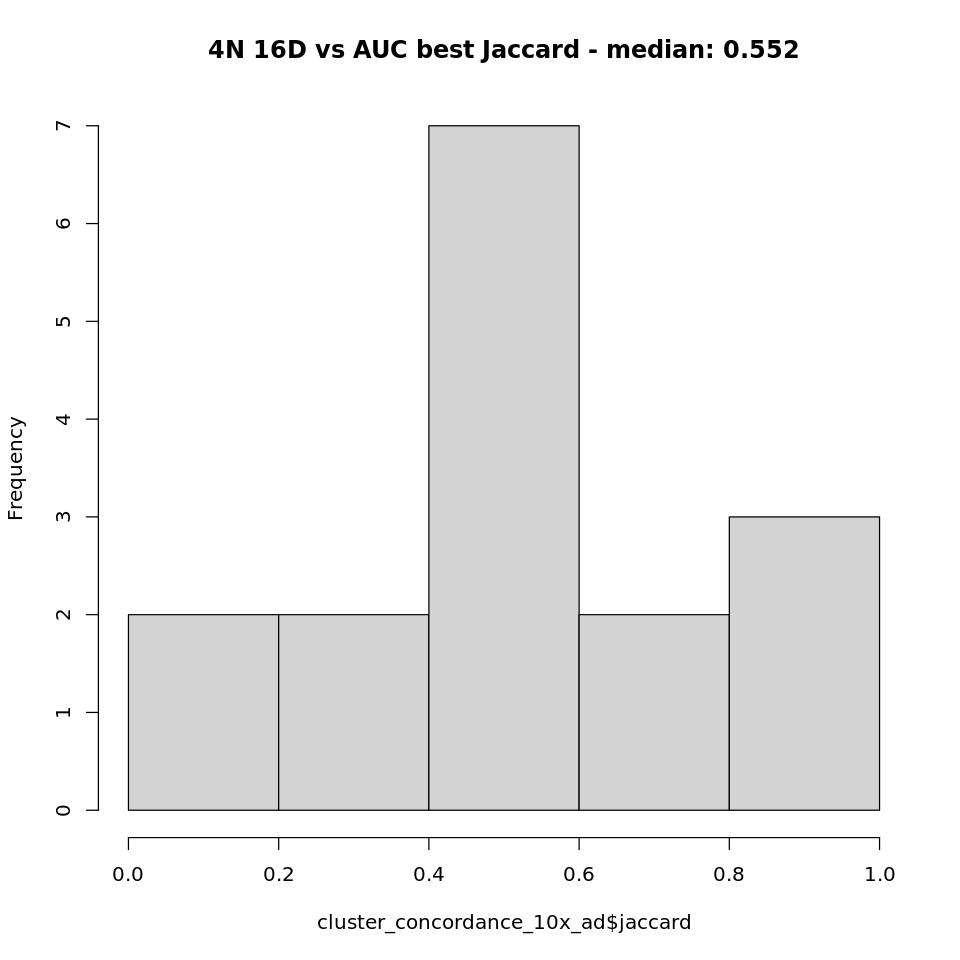

In [171]:
options(repr.plot.width = 8, repr.plot.height = 8)

cluster_concordance_10x_ad <- as.data.frame(cbind(colnames(jacmat_10x_ad), 
                                                 rownames(jacmat_10x_ad)[apply(jacmat_10x_ad, 2, which.max)], 
                                                 apply(jacmat_10x_ad, 2, max)))

colnames(cluster_concordance_10x_ad) <- c("cluster", "original_label", "jaccard")
cluster_concordance_10x_ad$jaccard <- as.numeric(cluster_concordance_10x_ad$jaccard)

hist(cluster_concordance_10x_ad$jaccard, main = paste0('4N 16D vs AUC best Jaccard - median: ', round(median(cluster_concordance_10x_ad$jaccard), digits = 3)), ylim = c(0,7))


Although the Jaccard indices do not improve as markedly as in the larval dataset, they still show a better distribution upon reassignment.

We visualize the activity of circadian rhythm genes as AUC scores:

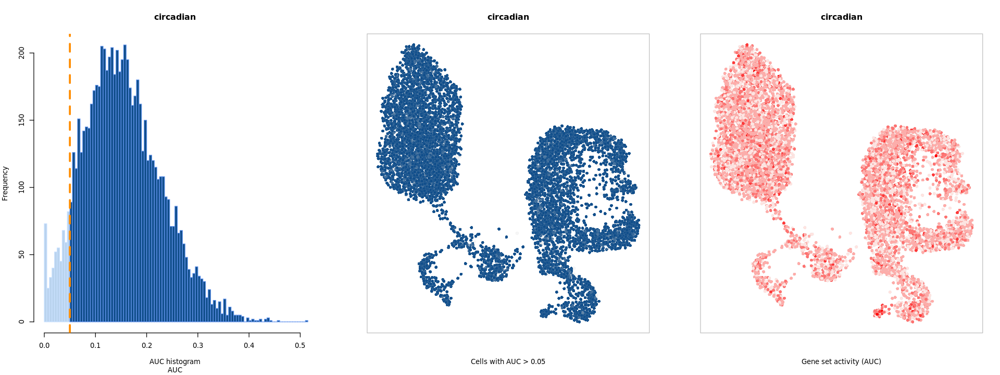

In [162]:
options(repr.plot.width = 16, repr.plot.height = 6)

cell_aucs_circ_10X_ad <- AUCell_calcAUC(circ_geneset, 
                                        rankings_10X_ad, 
                                        aucMaxRank = ceiling(0.3 * nrow(rankings_10X_ad)))

results_circ <- t(assay(cell_aucs_circ_10X_ad))

layout(matrix(1:3, nrow = 1))
AUCell_plotTSNE(tSNE = reducedDim(fish_10x_ad_corrected_16dim_reassigned, type = "UMAP"), 
                exprMat = assay(fish_10x_ad_mbn, "logcounts"), 
                cellsAUC = cell_aucs_circ_10X_ad, thresholds = 0.05) 

Circadian rhythm genes are expressed at low but consistent levels throughout the dataset. In particular _arntl1b_ is highly expressed in cluster Hb10, which overlaps with cluster 2 in our clustering.

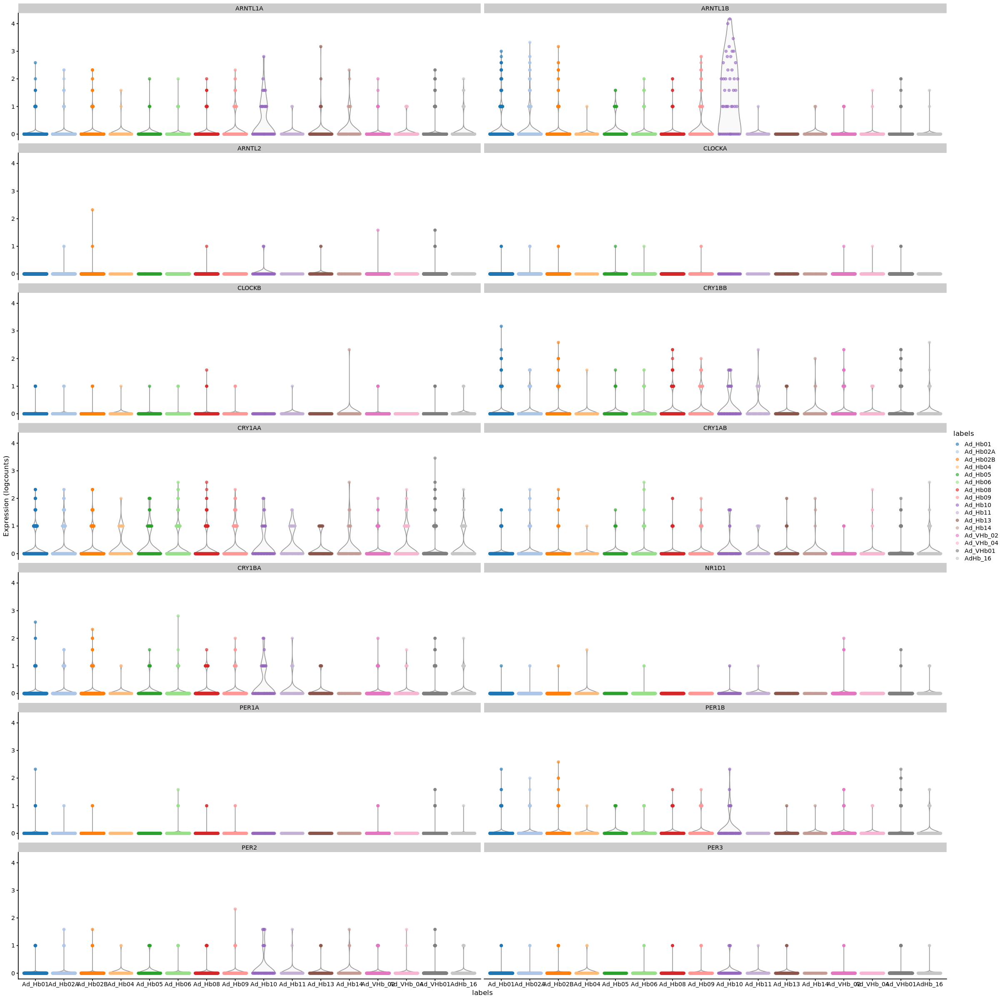

In [163]:
options(repr.plot.width = 20, repr.plot.height = 20)

fish_10x_ad_mbn_nodbl <- fish_10x_ad_mbn[,fish_10x_ad_mbn$scDblFinder.class == "singlet"]
fish_10x_ad_mbn_nodbl$labels <- fish_10x_ad_corrected_16dim_reassigned$labels

scater::plotExpression(fish_10x_ad_mbn_nodbl, circ_genes, x = "labels", colour_by = "labels") +
scale_fill_manual(values = custom_colors$discrete)

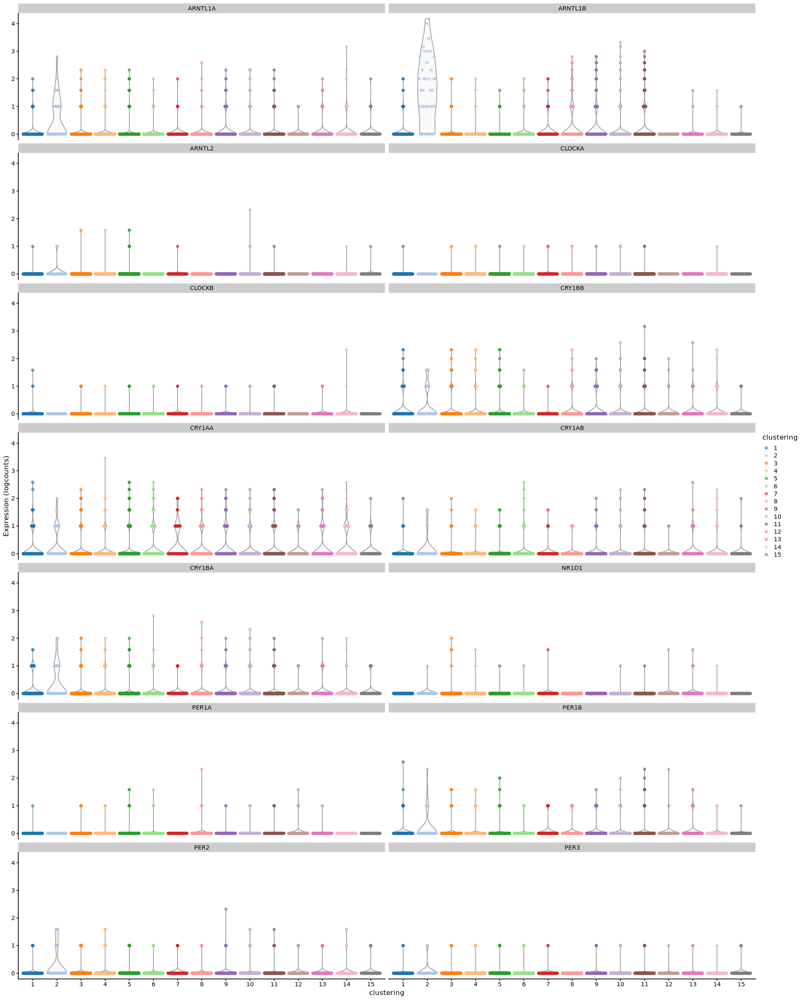

In [164]:
options(repr.plot.width = 16, repr.plot.height = 20)

fish_10x_ad_mbn_nodbl$clustering <- fish_10x_ad_corrected_16dim_reassigned$clustering

scater::plotExpression(fish_10x_ad_mbn_nodbl, circ_genes, x = "clustering", colour_by = "clustering") +
scale_fill_manual(values = custom_colors$discrete)

Dot plot visualization for reassigned labels:

In [165]:
circ_list_auc <- lapply(unique(colData(fish_10x_ad_corrected_16dim_reassigned)$labels), function(x) {
    
    pick_cells <- which(colData(fish_10x_ad_corrected_16dim_reassigned)$labels == x)
    pick_expr <- assay(fish_10x_ad_mbn_nodbl, "logcounts")[circ_genes, pick_cells]
    rwm <- rowMeans(pick_expr)
    rwp <- as.numeric(apply(pick_expr, 1, function(x) sum(x > 0)))/length(pick_cells) * 100
    rdf <- as.data.frame(cbind(as.numeric(rwm), as.numeric(rwp), rep(x, length(circ_genes)), circ_genes))
    return(rdf)
})
                      
circ_df_auc <- do.call(rbind, circ_list_auc)
colnames(circ_df_auc) <- c("rwm", "rwp", "cluster", "gene")                    

circ_df_auc$rwm <- as.numeric(circ_df_auc$rwm)
circ_df_auc$rwp <- as.numeric(circ_df_auc$rwp)
circ_df_auc$prod <- circ_df_auc$rwm * log10(circ_df_auc$rwm + 1)

gene_order <-  hclust(dist(matrix(circ_df_auc$prod, nrow = length(circ_genes))), method = "ward.D2")$order
cluster_order <- hclust(dist(t(matrix(circ_df_auc$prod, nrow = length(circ_genes)))))$order

circ_df_auc$gene <- factor(tolower(circ_df_auc$gene), levels = tolower(circ_df_auc$gene)[gene_order])
circ_df_auc$cluster <- factor(circ_df_auc$cluster, levels = unique(circ_df_auc$cluster)[cluster_order])
       

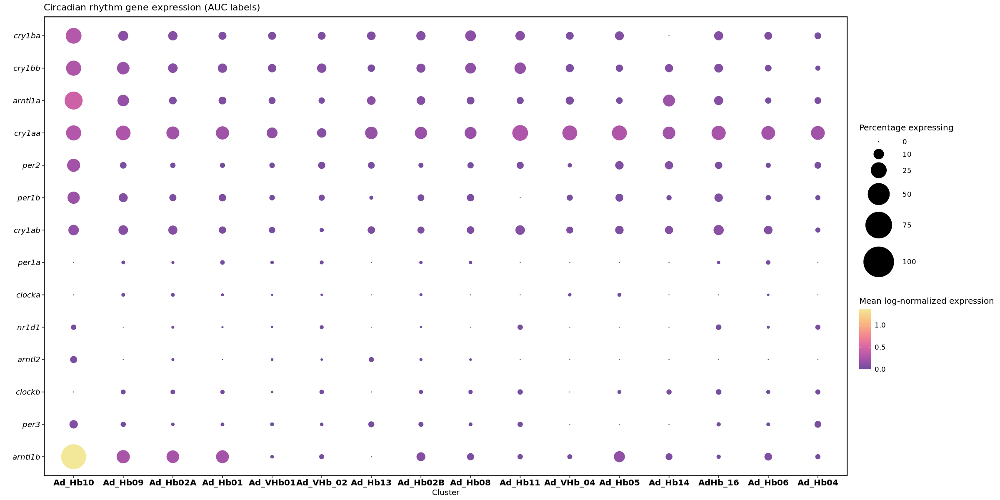

In [166]:
options(repr.plot.width = 20, repr.plot.height = 10)


ggplot(circ_df_auc, aes(col = rwm, size = rwp, x = cluster, y = gene)) + 
geom_point() +
scale_size_continuous(limits = c(0,100), range = c(0.1,20), breaks = c(0, 10, 25, 50, 75, 100)) +
scale_colour_continuous_sequential(palette = "Sunset", rev = FALSE) +
labs(x = "Cluster", y = "", size = "Percentage expressing", colour = "Mean log-normalized expression") +
theme(legend.key=element_blank(), 
  axis.text.x = element_text(colour = "black", size = 12, face = "bold"), 
  axis.text.y = element_text(colour = "black", face = "italic", size = 11), 
  legend.text = element_text(size = 10, colour ="black"), 
  legend.title = element_text(size = 12), 
  panel.background = element_blank(), panel.border = element_rect(colour = "black", fill = NA, size = 1.2), 
  legend.position = "right") +
ggtitle("Circadian rhythm gene expression (AUC labels)")

Dot plot visualization for our clustering:

In [167]:
circ_list_clust <- lapply(unique(colData(fish_10x_ad_corrected_16dim_reassigned)$clustering), function(x) {
    
    pick_cells <- which(colData(fish_10x_ad_corrected_16dim_reassigned)$clustering == x)
    pick_expr <- assay(fish_10x_ad_mbn_nodbl, "logcounts")[circ_genes,pick_cells]
    rwm <- rowMeans(pick_expr)
    rwp <- as.numeric(apply(pick_expr, 1, function(x) sum(x > 0)))/length(pick_cells) * 100
    rdf <- as.data.frame(cbind(as.numeric(rwm), as.numeric(rwp), rep(x, length(circ_genes)), circ_genes))
    return(rdf)
})
                      
circ_df_clust <- do.call(rbind, circ_list_clust)
colnames(circ_df_clust) <- c("rwm", "rwp", "cluster", "gene")                    

circ_df_clust$rwm <- as.numeric(circ_df_clust$rwm)
circ_df_clust$rwp <- as.numeric(circ_df_clust$rwp)
circ_df_clust$prod <- circ_df_clust$rwm * log10(circ_df_clust$rwm + 1)

gene_order <-  hclust(dist(matrix(circ_df_clust$prod, nrow = length(circ_genes))), method = "ward.D2")$order
cluster_order <- hclust(dist(t(matrix(circ_df_clust$prod, nrow = length(circ_genes)))))$order

circ_df_clust$gene <- factor(tolower(circ_df_clust$gene), levels = tolower(circ_df_clust$gene)[gene_order])
circ_df_clust$cluster <- factor(circ_df_clust$cluster, levels = unique(circ_df_clust$cluster)[cluster_order])
       

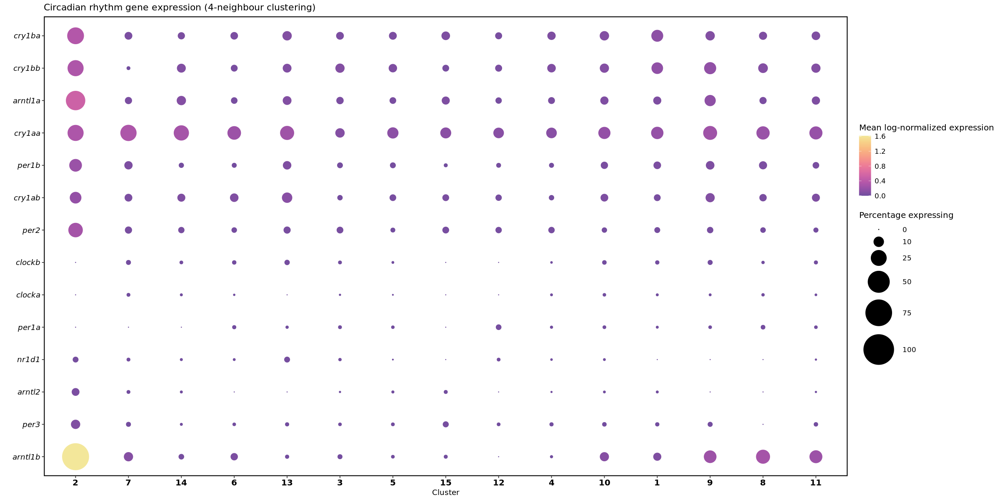

In [168]:
options(repr.plot.width = 20, repr.plot.height = 10)


ggplot(circ_df_clust, aes(col = rwm, size = rwp, x = cluster, y = gene)) + 
geom_point() +
scale_size_continuous(limits = c(0,100), range = c(0.1,20), breaks = c(0, 10, 25, 50, 75, 100)) +
scale_colour_continuous_sequential(palette = "Sunset", rev = FALSE) +
labs(x = "Cluster", y = "", size = "Percentage expressing", colour = "Mean log-normalized expression") +
theme(legend.key=element_blank(), 
  axis.text.x = element_text(colour = "black", size = 12, face = "bold"), 
  axis.text.y = element_text(colour = "black", face = "italic", size = 11), 
  legend.text = element_text(size = 10, colour ="black"), 
  legend.title = element_text(size = 12), 
  panel.background = element_blank(), panel.border = element_rect(colour = "black", fill = NA, size = 1.2), 
  legend.position = "right") +
ggtitle("Circadian rhythm gene expression (4-neighbour clustering)")

The analysis of the adult data seems to corroborate the finding in the larval one: Hb10 has a particularly high expression of clock genes.

In [169]:
sessionInfo()

R version 4.0.2 (2020-06-22)
Platform: x86_64-conda_cos6-linux-gnu (64-bit)
Running under: CentOS Linux 7 (Core)

Matrix products: default
BLAS/LAPACK: /opt/miniconda3/lib/libopenblasp-r0.3.10.so

locale:
 [1] LC_CTYPE=en_US.UTF-8       LC_NUMERIC=C              
 [3] LC_TIME=en_US.UTF-8        LC_COLLATE=en_US.UTF-8    
 [5] LC_MONETARY=en_US.UTF-8    LC_MESSAGES=en_US.UTF-8   
 [7] LC_PAPER=en_US.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=en_US.UTF-8 LC_IDENTIFICATION=C       

attached base packages:
[1] parallel  stats4    stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] scDblFinder_1.4.0           colorspace_2.0-0           
 [3] beeswarm_0.2.3              GSEABase_1.52.1            
 [5] graph_1.68.0                annotate_1.68.0            
 [7] XML_3.99-0.5                AnnotationDbi_1.52.0       
 [9] AUCell_1.12.0               pheatmap_1.0.12